<div
  style="
    display: flex;
    justify-content: center;
    flex-direction: column;
    align-items: center;
  "
>
<div style="width: 500px; padding: 20px; background: #fff; border: 1px solid #999; color: black; border-radius: 6px">
  <p style="opacity: 0.5; margin-bottom: -10px"><i>TDT4173 Machine Learning 2023</i></p>
  <h1 style="margin-bottom: -5px"><b>Long Notebook</b></h1>
  <h3>Kaggle Name: NeuralNet Ninjas™️</h3>
  <br />
  <h3>Team Members:</h3>
  <table style="margin: 0 auto; width: 100%; text-align: left">
    <tr style="background: #eee">
      <th style="border: 0.5px solid #999; color: black">Name</th>
      <th style="border: 0.5px solid #999; color: black">Student ID</th>
    </tr>
    <tr style="background: #fff">
      <td style="border-width: 0.5px; border-color: #555">Eggen, Sivert Antonsen</td>
      <td style="border-width: 0.5px; border-color: #555">54 46 17</td>
    </tr>
    <tr>
      <td style="border-width: 0.5px; border-color: #555">Grude, Kristoffer VI Nicolay Broch</td>
      <td style="border-width: 0.5px; border-color: #555">52 77 63</td>
    </tr>
    <tr>
      <td style="border-width: 0.5px; border-color: #555">Raa, Mathias Skogen</td>
      <td style="border-width: 0.5px; border-color: #555">54 46 38</td>
    </tr>
  </table>
  <br/> 
  </div>
</div>


---

### Outline
* [1 – Setup & Utils](#1)
* [2 – Exploratory Data Analysis](#2)
    * [2.1 – Domain Knowledge](#21)
    * [2.2 – Data Quality](#22)
    * [2.3 - Data Set Time Scale Analysis](#23)
    * [2.4 – Feature Exploration](#24)
* [3 – Preprocessing](#3)
    * [3.1 - Dataset loading](#31)
    * [3.2 - Data cleaning](#32)
    * [3.3 - Combine X and y](#33)
    * [3.4 - Feature Engineering](#34)
    * [3.5 - Result](#35)
* [4 – Modeling](#4)
    * [4.1 – LightGBM General Model](#41)
    * [4.2 – CatBoost General Model](#42)
    * [4.3 – CatBoost Log Transform Model](#43)
    * [4.4 – Catboost Target Encoded Location Model](#44)
    * [4.5 – CatBoost Estimated Sample Weight Model](#45)
    * [4.6 – CatBoost Model Trained Per Location ](#46)
    * [4.7 – Neural Network Model](#47)
    * [4.8 – XGBoost Model ](#48)
    * [4.9 – Catboost Summer Weighted Model](#49)
    * [4.10 – H20 AutoML New Model](#410)
    * [4.11 – H2O AutoML Old Model](#411)
    * [4.12 – Autogluon AutoML](#412)
    * [4.13 – Ensamble model ](#413)
* [5 – Postprocessing](#5)
* [6 – Submission](#6)

# 1 – Setup & Utils <a id='1'></a>

In [2]:
# Utils
from IPython.utils import io
import os

# Data
import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Scikit-learn
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.preprocessing import OrdinalEncoder, MinMaxScaler
from sklearn.model_selection import cross_val_predict, KFold, train_test_split

# Models
from autogluon.tabular import TabularDataset, TabularPredictor
from autogluon.common import space

import tensorflow as tf

import lightgbm as lgb
import xgboost as xgb
import catboost
import catboost as cb
import h2o
from h2o.automl import H2OAutoML

import scipy.optimize as opt

The following function scale_data, is a standard function used for scaling both training data with it's features, and the pv_measurement values. It ignores categorical features

In [3]:
def scale_data(data, cols=None):
    """
    Scale model-data using MinMaxScaler
    """
    
    if cols is None:
        ignore_cols = [
            "location",
            "dew_or_rime:idx",
            "is_day:idx",
            "is_in_shadow:idx",
            "pv_measurement",
            "data_type",
        ]

        cols = [col for col in data.columns if col not in ignore_cols]

    X_scaler = MinMaxScaler()
    X_scaler = X_scaler.fit(
        data[data["data_type"].isin(["observed", "estimated"])][cols]
    )
    y_scaler = MinMaxScaler()
    y_scaler = y_scaler.fit(
        data[data["data_type"].isin(["observed", "estimated"])][["pv_measurement"]]
    )

    data_copy = data.copy()

    data_copy[cols] = X_scaler.transform(data_copy[cols])
    data_copy[["pv_measurement"]] = y_scaler.transform(data[["pv_measurement"]])

    return data_copy, X_scaler, y_scaler

# 2 – Exploratory Data Analysis <a id='2'></a>

## 2.1 – Domain Knowledge <a id='21'></a>

#### Problem and provider

The problem is to build a model that can predict solar energy production for every hour of the next day. 
The data provided is from ANEO, an energy producer and service provider with headquarters in Trondheim Norway.

#### Domain

Solar energy is the energy that the sun gives trough radiation, and sun related statistics is therefore off course relevant for the electrity that solar panals are able to produce. Solar panels cannot convert 100% of the energy as their is some loss, and the sun radiation during a time period is thus an upper limit of what the production can be in that period. Radiation is blocked when there are clouds, thick weather like snow or rain amongst other things, so the magnitude of these things at given time periods will also affect solar panel production. In addition, since the sun goes down during the night, there is almost no clear radition, so energy production during the night will be lower or nothing at all. Thus, solar energy production is cyclic in it's nature. The same can be said for the different seasons, as there generally is higner radition during the summer than the winter, so the production might have seasonal differences.

The provided data consists of 3 different locations A, B and C. Since the locations can have different installations of solar panels, there are probably differences in the amount that they produce just because of the scale of the operation at each location.

#### Data generation

As mentioned, the data was given by Aneo. The training data contains both observed and estimated weather data. The observed data is actual observed weather that happened, while the estimated data is weather data that was estimated in advance. The training target data is generated based on actual solar energy production from the solar panels at the different locations.

## 2.2 – Data Quality <a id='22'></a>

Let's first load all datasets individually

In [3]:
# A
train_targets_a = pd.read_parquet('../data/A/train_targets.parquet')
X_test_estimated_a = pd.read_parquet('../data/A/X_test_estimated.parquet')
X_train_estimated_a = pd.read_parquet('../data/A/X_train_estimated.parquet')
X_train_observed_a = pd.read_parquet('../data/A/X_train_observed.parquet')

# B
train_targets_b = pd.read_parquet('../data/B/train_targets.parquet')
X_test_estimated_b = pd.read_parquet('../data/B/X_test_estimated.parquet')
X_train_estimated_b = pd.read_parquet('../data/B/X_train_estimated.parquet')
X_train_observed_b = pd.read_parquet('../data/B/X_train_observed.parquet')

# C
train_targets_c = pd.read_parquet('../data/C/train_targets.parquet')
X_test_estimated_c = pd.read_parquet('../data/C/X_test_estimated.parquet')
X_train_estimated_c = pd.read_parquet('../data/C/X_train_estimated.parquet')
X_train_observed_c = pd.read_parquet('../data/C/X_train_observed.parquet')

No we can look at the head of each dataset just to get an overview of what they look like

Observed training data A

In [4]:
X_train_observed_a.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2019-06-02 22:00:00,7.7,1.230,1744.900024,0.0,0.0,1744.900024,0.0,280.299988,0.0,...,342.834015,-3.202,0.0,285.899994,100.0,39640.101562,3.7,-3.6,-0.8,-0.0
1,2019-06-02 22:15:00,7.7,1.229,1734.000000,0.0,0.0,1734.000000,0.0,280.299988,0.0,...,346.294006,-3.650,0.0,286.100006,100.0,40123.898438,3.6,-3.6,-0.6,-0.0
2,2019-06-02 22:30:00,7.7,1.228,1723.500000,0.0,0.0,1723.500000,0.0,280.299988,0.0,...,349.768005,-3.998,0.0,286.299988,100.0,40628.300781,3.6,-3.6,-0.4,-0.0
3,2019-06-02 22:45:00,7.7,1.226,1713.400024,0.0,0.0,1713.400024,0.0,280.299988,0.0,...,353.251007,-4.247,0.0,286.600006,100.0,41153.601562,3.5,-3.5,-0.2,-0.0
4,2019-06-02 23:00:00,7.7,1.225,1703.599976,0.0,0.0,1703.599976,0.0,280.299988,0.0,...,356.742004,-4.393,0.0,286.799988,100.0,41699.898438,3.5,-3.5,0.0,-0.0


In [5]:
X_train_observed_a.shape

(118669, 46)

We can see that the observed train set for location A has 46 features and 118669 rows

Estimated train A

In [6]:
X_train_estimated_a.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2022-10-27 07:00:18,2022-10-28 22:00:00,8.4,1.233,1425.099976,0.0,0.0,1211.699951,1.0,281.399994,...,340.799011,-38.466999,0.0,284.700012,100.0,29429.699219,0.8,-0.4,0.7,-0.0
1,2022-10-27 07:00:18,2022-10-28 22:15:00,8.4,1.233,2085.899902,0.0,0.0,1560.500000,1.0,281.299988,...,345.451996,-38.955002,0.0,284.700012,100.0,23604.099609,0.7,-0.4,0.7,-0.0
2,2022-10-27 07:00:18,2022-10-28 22:30:00,8.3,1.233,2746.600098,0.0,0.0,1909.400024,1.0,281.200012,...,350.153015,-39.310001,0.0,284.700012,100.0,17799.800781,0.7,-0.3,0.6,-0.0
3,2022-10-27 07:00:18,2022-10-28 22:45:00,8.3,1.233,3407.399902,0.0,0.0,2258.199951,1.0,281.200012,...,354.886993,-39.528999,0.0,284.600006,100.0,12016.500000,0.6,-0.2,0.6,-0.0
4,2022-10-27 07:00:18,2022-10-28 23:00:00,8.2,1.233,4068.199951,0.0,0.0,2607.000000,1.0,281.100006,...,359.638000,-39.609001,0.0,284.600006,100.0,6254.399902,0.6,-0.1,0.6,-0.0


In [7]:
X_train_estimated_a.shape

(17576, 47)

We can see that the estimated set has one more feature, which is the date_calc coloumn. This coloumn describes the time at which the forecast was calculated, while the data_forecast coloumn describes the time for which the forecast belongs to. 

Test A

In [8]:
X_test_estimated_a.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01 00:00:00,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.520000,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0
1,2023-04-30 07:00:04,2023-05-01 00:15:00,4.3,1.287,912.700012,0.0,0.0,1054.800049,0.0,271.700012,...,14.203000,-10.825,0.0,273.799988,77.000000,30003.599609,4.0,2.1,3.4,-0.0
2,2023-04-30 07:00:04,2023-05-01 00:30:00,4.3,1.287,912.700012,0.0,0.0,1068.300049,0.0,271.600006,...,17.868999,-10.360,0.0,273.799988,73.099998,29797.099609,3.9,2.1,3.3,-0.0
3,2023-04-30 07:00:04,2023-05-01 00:45:00,4.3,1.287,912.700012,0.0,0.0,1081.900024,0.0,271.600006,...,21.514000,-9.794,0.0,273.799988,69.000000,29618.599609,3.9,2.0,3.3,-0.0
4,2023-04-30 07:00:04,2023-05-01 01:00:00,4.3,1.287,NaN,0.0,0.0,1095.400024,0.0,271.600006,...,25.135000,-9.128,0.0,273.799988,64.500000,29507.500000,3.9,2.0,3.3,-0.0


In [9]:
X_test_estimated_a.shape

(2880, 47)

Train targets A

In [10]:
train_targets_a.head()

,time,pv_measurement
0,2019-06-02 22:00:00,0.00
1,2019-06-02 23:00:00,0.00
2,2019-06-03 00:00:00,0.00
3,2019-06-03 01:00:00,0.00
4,2019-06-03 02:00:00,19.36


In [11]:
train_targets_a.shape

(34085, 2)

We can see that the train targets only has two features, the time, and the pv_measurement. 

There are two main discoveries here already:

1. The time features are every hour, but the train and test sets have rows for every 15 mins. This means that as a part of the preprocessing stage, we need to resample the data so that we get hours when training. 
2. There are 0 values in the pv_measurement coloumn. This might be because it is during the night, but is there really a reason that there should be 0 production at 1AM and then 19.36 at 2AM? This might indicate that we must look into cleaning some 0 values

Let's look at all location B

Observed train B

In [12]:
X_train_observed_b.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2019-01-01 00:00:00,5.6,1.239,1226.400024,0.0,0.0,1226.400024,0.0,275.399994,0.0,...,12.985000,-49.139999,0.0,278.399994,73.900002,19275.900391,2.5,1.1,2.2,-0.0
1,2019-01-01 00:15:00,5.6,1.239,1209.300049,0.0,0.0,1209.300049,0.0,275.200012,0.0,...,18.205999,-48.688000,0.0,278.299988,83.800003,17638.000000,2.7,1.2,2.4,-0.0
2,2019-01-01 00:30:00,5.5,1.240,1192.099976,0.0,0.0,1192.099976,0.0,275.100006,0.0,...,23.339001,-48.091000,0.0,278.200012,91.199997,16008.799805,2.9,1.2,2.7,-0.0
3,2019-01-01 00:45:00,5.4,1.241,1174.900024,0.0,0.0,1174.900024,0.0,274.899994,0.0,...,28.367001,-47.358002,0.0,278.100006,96.400002,14388.500000,3.1,1.2,2.9,-0.0
4,2019-01-01 01:00:00,5.4,1.241,1157.599976,0.0,0.0,1157.599976,0.0,274.700012,0.0,...,33.275002,-46.497002,0.0,278.000000,99.400002,12777.299805,3.4,1.3,3.1,-0.0


In [13]:
X_train_observed_b.shape

(116929, 46)

Estimated train B

In [14]:
X_test_estimated_b.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01 00:00:00,4.3,1.283,912.299988,0.0,0.0,1039.900024,0.0,271.700012,...,10.521000,-11.184,0.0,273.799988,80.699997,31329.500000,4.0,2.2,3.4,-0.0
1,2023-04-30 07:00:04,2023-05-01 00:15:00,4.3,1.283,912.299988,0.0,0.0,1053.099976,0.0,271.700012,...,14.204000,-10.824,0.0,273.799988,77.099998,31181.599609,4.0,2.1,3.4,-0.0
2,2023-04-30 07:00:04,2023-05-01 00:30:00,4.3,1.283,912.299988,0.0,0.0,1066.400024,0.0,271.600006,...,17.870001,-10.360,0.0,273.799988,73.199997,31033.599609,3.9,2.1,3.4,-0.0
3,2023-04-30 07:00:04,2023-05-01 00:45:00,4.3,1.283,912.299988,0.0,0.0,1079.599976,0.0,271.600006,...,21.514000,-9.793,0.0,273.799988,69.000000,30885.699219,3.9,2.0,3.3,-0.0
4,2023-04-30 07:00:04,2023-05-01 01:00:00,4.3,1.283,NaN,0.0,0.0,1092.900024,0.0,271.600006,...,25.135000,-9.127,0.0,273.799988,64.599998,30737.800781,3.9,2.0,3.3,-0.0


In [15]:
X_test_estimated_b.shape

(2880, 47)

Test B

In [16]:
X_test_estimated_b.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01 00:00:00,4.3,1.283,912.299988,0.0,0.0,1039.900024,0.0,271.700012,...,10.521000,-11.184,0.0,273.799988,80.699997,31329.500000,4.0,2.2,3.4,-0.0
1,2023-04-30 07:00:04,2023-05-01 00:15:00,4.3,1.283,912.299988,0.0,0.0,1053.099976,0.0,271.700012,...,14.204000,-10.824,0.0,273.799988,77.099998,31181.599609,4.0,2.1,3.4,-0.0
2,2023-04-30 07:00:04,2023-05-01 00:30:00,4.3,1.283,912.299988,0.0,0.0,1066.400024,0.0,271.600006,...,17.870001,-10.360,0.0,273.799988,73.199997,31033.599609,3.9,2.1,3.4,-0.0
3,2023-04-30 07:00:04,2023-05-01 00:45:00,4.3,1.283,912.299988,0.0,0.0,1079.599976,0.0,271.600006,...,21.514000,-9.793,0.0,273.799988,69.000000,30885.699219,3.9,2.0,3.3,-0.0
4,2023-04-30 07:00:04,2023-05-01 01:00:00,4.3,1.283,NaN,0.0,0.0,1092.900024,0.0,271.600006,...,25.135000,-9.127,0.0,273.799988,64.599998,30737.800781,3.9,2.0,3.3,-0.0


In [17]:
X_test_estimated_b.shape

(2880, 47)

Train targets B

In [18]:
train_targets_b.head()

,time,pv_measurement
0,2018-12-31 23:00:00,0.0
1,2019-01-01 00:00:00,0.0
2,2019-01-01 01:00:00,0.0
3,2019-01-01 02:00:00,0.0
4,2019-01-01 03:00:00,0.0


In [19]:
train_targets_b.shape

(32848, 2)

Lets look at C

Observed train C

In [20]:
X_train_observed_c.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2019-01-01 00:00:00,5.6,1.240,1153.599976,0.0,0.0,1153.599976,1.0,275.200012,0.0,...,12.989000,-49.178001,0.0,278.500000,68.500000,18220.400391,2.5,1.1,2.2,-0.0
1,2019-01-01 00:15:00,5.5,1.241,1137.900024,0.0,0.0,1137.900024,1.0,275.100006,0.0,...,18.214001,-48.724998,0.0,278.399994,80.800003,17083.699219,2.8,1.1,2.5,-0.0
2,2019-01-01 00:30:00,5.4,1.241,1122.199951,0.0,0.0,1122.199951,1.0,274.899994,0.0,...,23.351000,-48.127998,0.0,278.299988,89.900002,15940.900391,3.0,1.1,2.8,-0.0
3,2019-01-01 00:45:00,5.4,1.241,1106.400024,0.0,0.0,1106.400024,1.0,274.700012,0.0,...,28.382000,-47.393002,0.0,278.200012,96.099998,14792.000000,3.3,1.2,3.0,-0.0
4,2019-01-01 01:00:00,5.3,1.241,1090.599976,0.0,0.0,1090.599976,1.0,274.500000,0.0,...,33.292999,-46.529999,0.0,278.100006,99.400002,13637.299805,3.5,1.2,3.3,-0.0


In [21]:
X_train_observed_c.shape

(116825, 46)

Estimated train C

In [22]:
X_train_estimated_c.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2022-10-27 07:00:18,2022-10-28 22:00:00,8.3,1.231,1427.400024,0.0,0.0,1215.800049,1.0,281.200012,...,340.785004,-38.502998,0.0,285.200012,100.0,34387.398438,1.2,-0.3,1.1,-0.0
1,2022-10-27 07:00:18,2022-10-28 22:15:00,8.3,1.231,2089.000000,0.0,0.0,1425.900024,1.0,281.200012,...,345.440002,-38.992001,0.0,285.100006,100.0,27418.500000,1.2,-0.2,1.2,-0.0
2,2022-10-27 07:00:18,2022-10-28 22:30:00,8.3,1.231,2750.500000,0.0,0.0,1636.099976,1.0,281.100006,...,350.144012,-39.348000,0.0,285.100006,100.0,20508.800781,1.2,-0.1,1.2,-0.0
3,2022-10-27 07:00:18,2022-10-28 22:45:00,8.2,1.230,3412.100098,0.0,0.0,1846.199951,1.0,281.100006,...,354.880005,-39.567001,0.0,285.000000,100.0,13657.799805,1.2,-0.0,1.2,-0.0
4,2022-10-27 07:00:18,2022-10-28 23:00:00,8.2,1.230,4073.699951,0.0,0.0,2056.399902,1.0,281.100006,...,359.634003,-39.647999,0.0,285.000000,100.0,6865.000000,1.2,0.1,1.2,-0.0


In [23]:
X_train_estimated_c.shape

(17576, 47)

Test C

In [24]:
X_test_estimated_c.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01 00:00:00,4.2,1.286,NaN,0.0,0.0,1178.000000,0.0,271.100006,...,10.519000,-11.223,0.0,273.700012,73.699997,31411.000000,3.5,1.5,3.1,-0.0
1,2023-04-30 07:00:04,2023-05-01 00:15:00,4.2,1.286,NaN,0.0,0.0,1217.000000,0.0,271.100006,...,14.202000,-10.862,0.0,273.700012,70.800003,31295.800781,3.4,1.5,3.1,-0.0
2,2023-04-30 07:00:04,2023-05-01 00:30:00,4.1,1.286,NaN,0.0,0.0,1256.000000,0.0,271.000000,...,17.868000,-10.397,0.0,273.700012,67.900002,31178.599609,3.4,1.4,3.1,-0.0
3,2023-04-30 07:00:04,2023-05-01 00:45:00,4.1,1.286,NaN,0.0,0.0,1295.000000,0.0,270.899994,...,21.513000,-9.830,0.0,273.700012,64.800003,31082.500000,3.4,1.4,3.1,-0.0
4,2023-04-30 07:00:04,2023-05-01 01:00:00,4.1,1.286,NaN,0.0,0.0,1334.099976,0.0,270.899994,...,25.134001,-9.163,0.0,273.700012,61.599998,31051.400391,3.4,1.4,3.1,-0.0


In [25]:
X_test_estimated_c.shape

(2880, 47)

Train targets C

In [26]:
train_targets_c.head()

,time,pv_measurement
0,2018-12-31 23:00:00,NaN
1,2019-01-01 00:00:00,NaN
2,2019-01-01 01:00:00,NaN
3,2019-01-01 02:00:00,NaN
4,2019-01-01 03:00:00,NaN


In [27]:
train_targets_c.shape

(32155, 2)

We can see that B and C have the same number of features and data structure as A. However there is a new key discovery:

 - The train targets in C contains NaN values. They should probably be cleaned, or perhaps filled with something else. 

#### 2.2.2 - Train targets EDA

Let's do some investigation at the train targets for A, B and C respectively.

Plotting train targets A

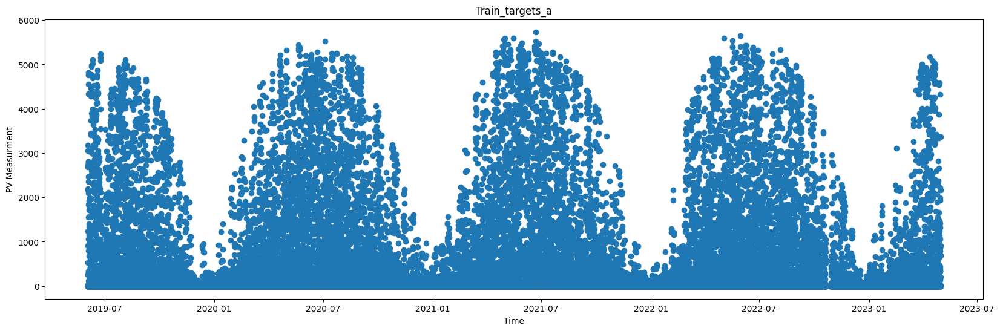

In [28]:
#plotting train_targets_a
plt.figure(figsize=(20,6))
plt.scatter(train_targets_a["time"], train_targets_a["pv_measurement"])
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets_a")
plt.show()

We can see a general trend of lower measurements around January (the winter). Possibly due to snow, or just lower radiation and less production during the winter. 

It's hard to see trends on a smaller time scale, so let's look at some smaller scales for A

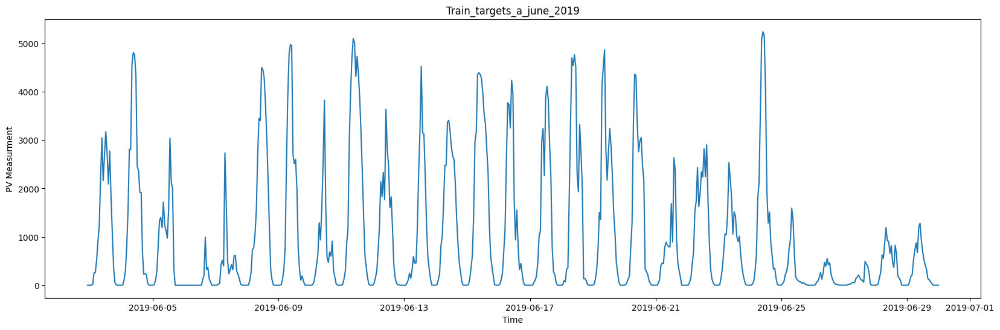

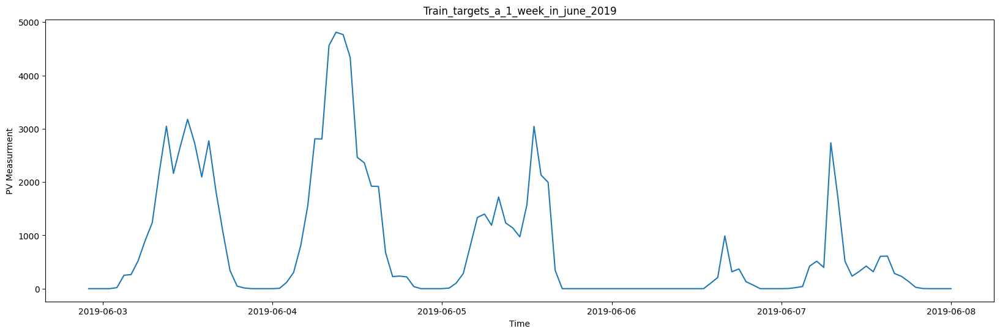

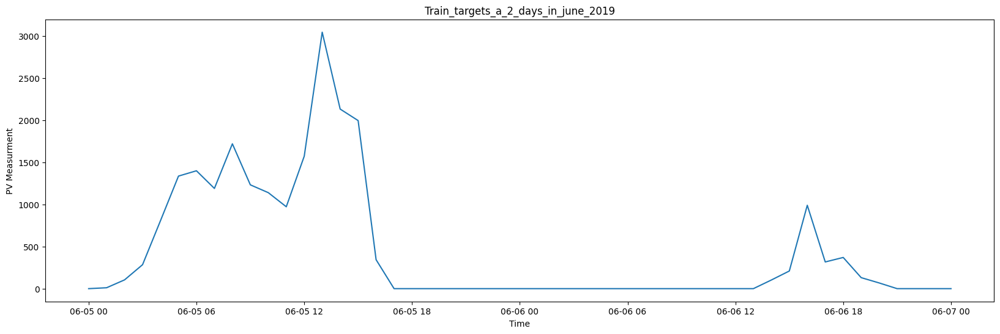

In [29]:
#plotting A targets for a month, week, and two days

for day in ["30", "08", "07"]:
    if day!="07":
        start_date = pd.Timestamp('2019-06-01')
        end_date = pd.Timestamp('2019-06-'+day)
        filtered_train_targets_a = train_targets_a[(train_targets_a['time'] >= start_date) & (train_targets_a['time'] <= end_date)]
        plt.figure(figsize=(20, 6))
        plt.plot(filtered_train_targets_a["time"], filtered_train_targets_a["pv_measurement"])
        plt.xlabel("Time")
        plt.ylabel("PV Measurment")
        if day=="30":
            plt.title("Train_targets_a_june_2019")
            plt.show()
        else:
            plt.title("Train_targets_a_1_week_in_june_2019")
            plt.show()
    else:
        start_date = pd.Timestamp('2019-06-05')
        end_date = pd.Timestamp('2019-06-'+day)
        filtered_train_targets_a = train_targets_a[(train_targets_a['time'] >= start_date) & (train_targets_a['time'] <= end_date)]
        plt.figure(figsize=(20, 6))
        plt.plot(filtered_train_targets_a["time"], filtered_train_targets_a["pv_measurement"])
        plt.xlabel("Time")
        plt.ylabel("PV Measurment")
        plt.title("Train_targets_a_2_days_in_june_2019")
        plt.show()

We can see from this plot that on a monthly scale the pv_measurements move up and down and seem to have a general pattern where there are 0 measurements and where there are peaks. 

Zooming in on a week and a day, we can see that there seems to be some irregularities. For example, why does the 6'th of June have som many repeating 0 measurements? Is there a reason that there on a summer day in June at 12 o'clock should be 0 production when the day before had a lot of production at 12? It might indicate that there are some errors in the measurements, where repeated valeus over a long period of time has to be cleaned. 

Let's look at B and C

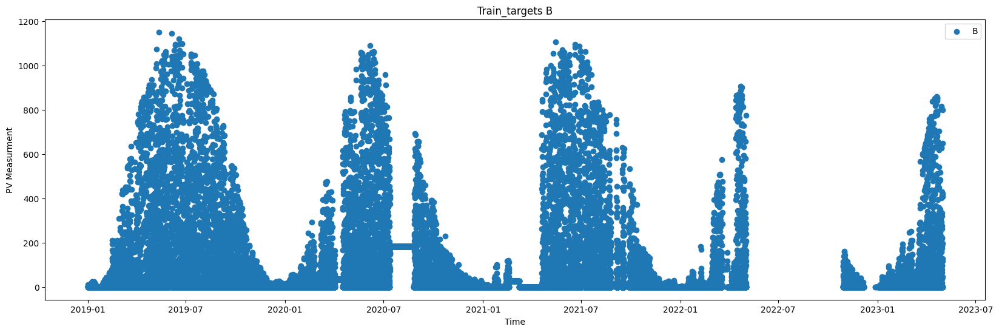

In [30]:
#B
plt.figure(figsize=(20,6))
plt.scatter(train_targets_b["time"], train_targets_b["pv_measurement"], label="B")
plt.legend()
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets B")
plt.show()

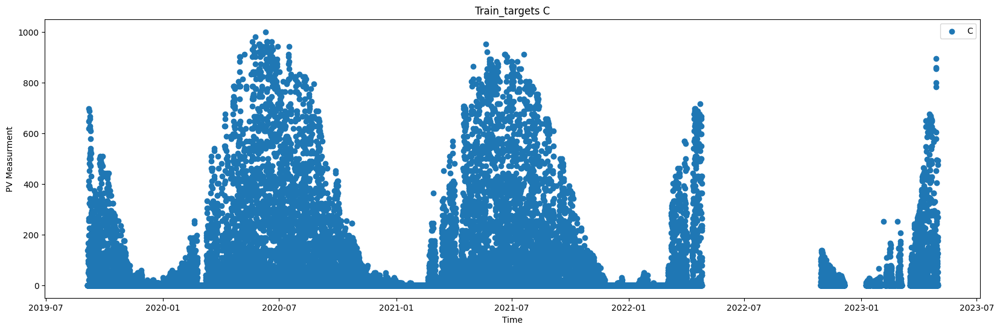

In [31]:
#C
plt.figure(figsize=(20,6))
plt.scatter(train_targets_c["time"], train_targets_c["pv_measurement"], label="C")
plt.legend()
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets C")
plt.show()

We can see that there are some key discoveries for B and C

1. In B there are two huge gaps of non-zero repeating values, these needs to be cleaned for sure
2. There is a huge time gap with no data towards the end

Let's plot all train targets on top of eachother

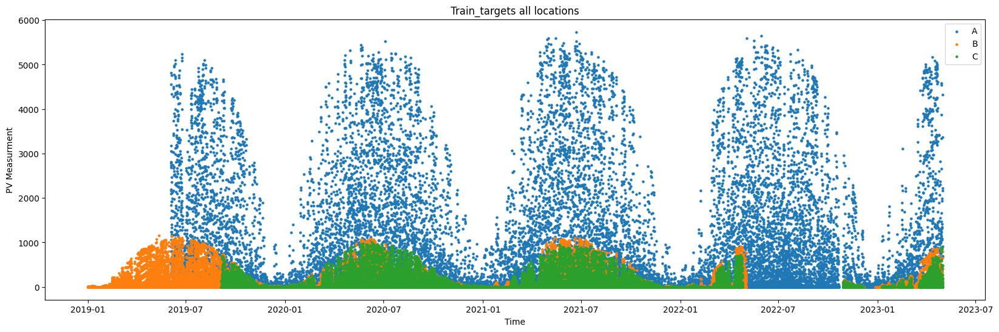

In [32]:
#plotting all train targets up against eachother
plt.figure(figsize=(20,6))
plt.scatter(train_targets_a["time"], train_targets_a["pv_measurement"], label="A",s=5)
plt.scatter(train_targets_b["time"], train_targets_b["pv_measurement"], label="B",s=5)
plt.scatter(train_targets_c["time"], train_targets_c["pv_measurement"], label="C",s=5)
plt.legend()
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets all locations")
plt.show()


We can se that the pv_measurements are a lot higher for location A, while B and see seems to have about the same scale on their measurement. 

Let's look at the number of zeros and number of NaN values in each of the locations

In [33]:
#counting the number of rows, and zero-measurement rows in traintargets_a
train_targets_a_0_pvs = train_targets_a[train_targets_a["pv_measurement"] == 0]
count_targett_pvs_0 = len(train_targets_a_0_pvs)
print("Number of rows in train_targets_a with 0 measurments: ", count_targett_pvs_0)

# NaN in A
train_target_a_Nan_pvs = train_targets_a[pd.isna(train_targets_a["pv_measurement"])]
count_target_nan_a = len(train_target_a_Nan_pvs)
print("Number of rows in train_targets_a with NaN measurments: ", count_target_nan_a)

#B
train_targets_b_0_pvs = train_targets_b[train_targets_b["pv_measurement"] == 0]
train_targets_b_negative_pvs = train_targets_b[train_targets_b["pv_measurement"] < 0]
train_target_b_Nan_pvs = train_targets_b[pd.isna(train_targets_b["pv_measurement"])]
count_targett_pvs_0_b = len(train_targets_b_0_pvs)
count_target_negative_b = len(train_targets_b_negative_pvs)
count_target_nan_b = len(train_target_b_Nan_pvs)
print("Number of rows in train_targets_b with 0 measurments: ", count_targett_pvs_0_b)
print("Number of rows in train_targets_b with negative measurments: ", count_target_negative_b)
print("Number of rows in train_targets_b with NaN measurments: ", count_target_nan_b)


#C

train_targets_c_0_pvs = train_targets_c[train_targets_c["pv_measurement"] == 0]
train_targets_c_negative_pvs = train_targets_c[train_targets_c["pv_measurement"] < 0]
train_target_c_Nan_pvs = train_targets_c[pd.isna(train_targets_c["pv_measurement"])]
count_targett_pvs_0_c = len(train_targets_c_0_pvs)
count_target_negative_c = len(train_targets_c_negative_pvs)
count_target_nan_c = len(train_target_c_Nan_pvs)
print("Number of rows in train_targets_c with 0 measurments: ", count_targett_pvs_0_c)
print("Number of rows in train_targets_c with negative measurments: ", count_target_negative_c)
print("Number of rows in train_targets_c with NaN measurments: ", count_target_nan_c)

Number of rows in train_targets_a with 0 measurments:  16040
Number of rows in train_targets_a with NaN measurments:  0
Number of rows in train_targets_b with 0 measurments:  17312
Number of rows in train_targets_b with negative measurments:  0
Number of rows in train_targets_b with NaN measurments:  4
Number of rows in train_targets_c with 0 measurments:  15952
Number of rows in train_targets_c with negative measurments:  0
Number of rows in train_targets_c with NaN measurments:  6060


There are 2 key takeaways from this:

1. There seems to be more or less equal amounts of 0 values in all locations, and that they are not uncommon. 
2. While A has no NaN values and B have only 4, C have 6060 which is a huge amount. This is probably therefore an error that needs to be cleaned away

Next, we need to see if there are some negative values. There should not be negative values, as it is impossible to produce negative energy. No negative values would confirm an intuitive understanding of the data. 

In [34]:
#counting the number of negative rows
train_targets_a_negative_pvs = train_targets_a[train_targets_a["pv_measurement"] < 0]
count_target_negative_a = len(train_targets_a_negative_pvs)
print("Number of rows in train_targets_a with negative measurments: ", count_target_negative_a)


train_targets_b_negative_pvs = train_targets_b[train_targets_b["pv_measurement"] < 0]
count_target_negative_b = len(train_targets_b_negative_pvs)
print("Number of rows in train_targets_b with negative measurments: ", count_target_negative_b)

#counting the number of negative rows
train_targets_c_negative_pvs = train_targets_c[train_targets_c["pv_measurement"] < 0]
count_target_negative_c = len(train_targets_c_negative_pvs)
print("Number of rows in train_targets_c with negative measurments: ", count_target_negative_c)

Number of rows in train_targets_a with negative measurments:  0
Number of rows in train_targets_b with negative measurments:  0
Number of rows in train_targets_c with negative measurments:  0


There are no negative values, which is good!

## 2.3 - Data Set Time Scale Analysis <a id='23'></a>

### 2.3.1 - Graph of dataset split over time per location

The following code plots the different datasets we have over time

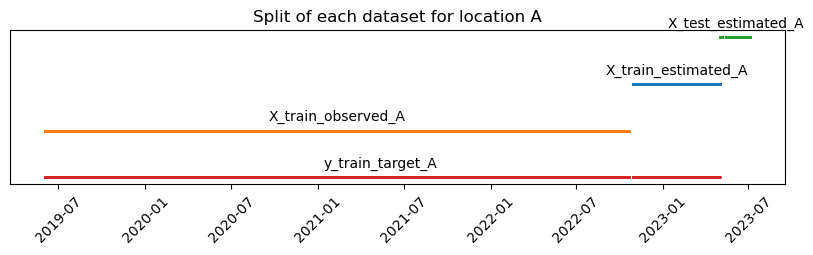

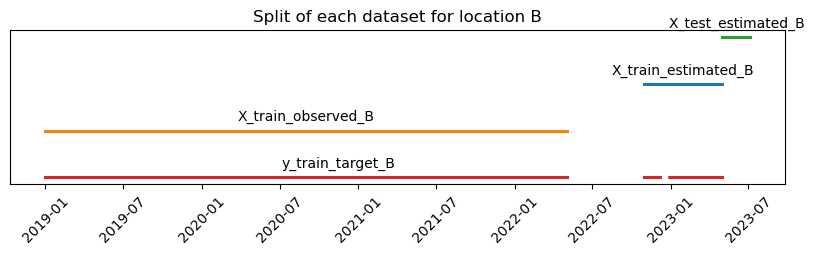

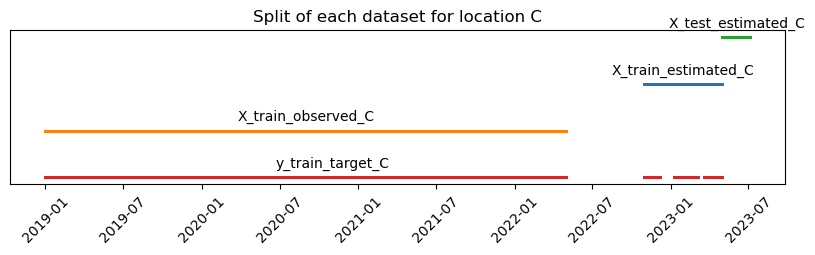

In [ ]:
# Graph plotting a point for every row in al lthe datesets with y value equal to 1 and x axis equal to "date_calc" or time collumn

# Define a list of locations
locations = ['A', 'B', 'C']

# Create a loop to plot for each location
for location in locations:
    # Load the data for the current location
    X_train_estimated = globals()["X_train_estimated_" + location]
    X_train_observed = globals()["X_train_observed_" + location]
    X_test_estimated = globals()["X_test_estimated_" + location]
    y_train_target = globals()["y_train_target_" + location]
    
    # Set size of the plot as a narrow rectangle
    plt.figure(figsize=(10, 2))

    # Plot the lines for the current location
    plt.scatter(X_train_estimated['date_forecast'], np.ones(len(X_train_estimated)) * 0.3, s=1)
    plt.scatter(X_train_observed['date_forecast'], np.ones(len(X_train_observed)) * 0.2, s=1)
    plt.scatter(X_test_estimated['date_forecast'], np.ones(len(X_test_estimated)) * 0.4, s=1)
    plt.scatter(y_train_target['time'], np.ones(len(y_train_target)) * 0.1, s=1)

    # Hide the y axis
    plt.yticks([])

    # Rotate the x axis labels
    plt.xticks(rotation=45)

    # Add legend
    #plt.legend(['X_train_estimated_' + location, 'X_train_observed_' + location, 'X_test_estimated_' + location, 'y_train_target_' + location])

    # Add title
    plt.title('Split of each dataset for location ' + location)

    # Add the name of the dataset above the scatter plot
    plt.text(X_train_estimated['date_forecast'].iloc[len(X_train_estimated) // 2], 0.32, 'X_train_estimated_' + location, ha='center')
    plt.text(X_train_observed['date_forecast'].iloc[len(X_train_observed) // 2], 0.22, 'X_train_observed_' + location, ha='center')
    plt.text(X_test_estimated['date_forecast'].iloc[len(X_test_estimated) // 2], 0.42, 'X_test_estimated_' + location, ha='center')
    plt.text(y_train_target['time'].iloc[len(y_train_target) // 2], 0.12, 'y_train_target_' + location, ha='center')



    plt.show()

### 2.3.2 - Graph of all dateset split over time 

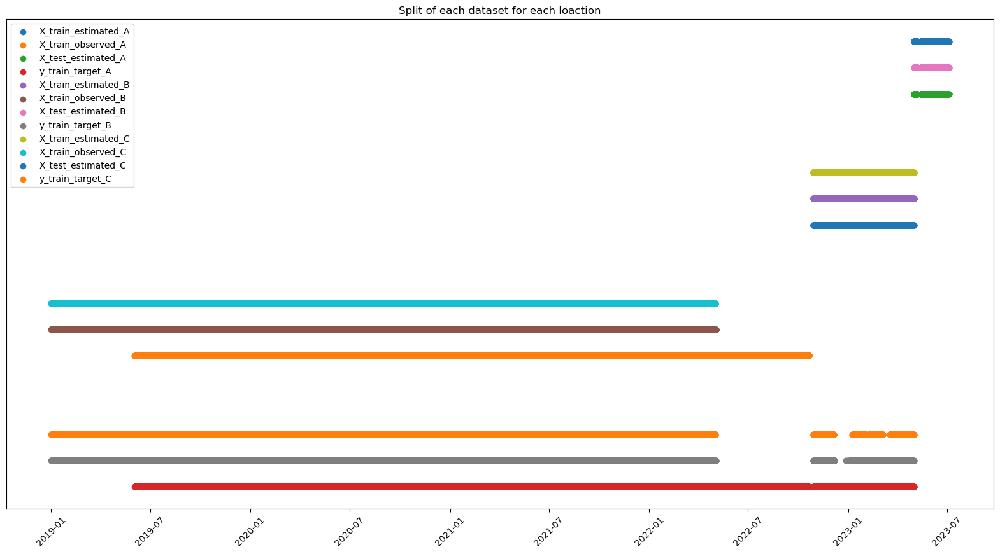

In [ ]:
# Graph plotting a point for every row in X_train_estimated_A with y value equal to 1 and x axis equal to "date_forecast" colum

# Set size of the plot
plt.figure(figsize=(20, 10))

# Plot the lines for location A   

plt.scatter(X_train_estimated_a['date_forecast'], np.ones(len(X_train_estimated_a))* 0.3)
plt.scatter(X_train_observed_a['date_forecast'], np.ones(len(X_train_observed_a))* 0.2)
plt.scatter(X_test_estimated_a['date_forecast'], np.ones(len(X_test_estimated_a))* 0.4)
plt.scatter(train_targets_a['time'], np.ones(len(train_targets_a))* 0.1)

# Plot the lines for location B
plt.scatter(X_train_estimated_b['date_forecast'], np.ones(len(X_train_estimated_b))*0.32)
plt.scatter(X_train_observed_b['date_forecast'], np.ones(len(X_train_observed_b))*0.22)
plt.scatter(X_test_estimated_b['date_forecast'], np.ones(len(X_test_estimated_b))*0.42)
plt.scatter(train_targets_b['time'], np.ones(len(train_targets_b))*0.12)

# Plot the lines for location C
plt.scatter(X_train_estimated_c['date_forecast'], np.ones(len(X_train_estimated_c))*0.34)
plt.scatter(X_train_observed_c['date_forecast'], np.ones(len(X_train_observed_c))*0.24)
plt.scatter(X_test_estimated_c['date_forecast'], np.ones(len(X_test_estimated_c))*0.44)
plt.scatter(train_targets_c['time'], np.ones(len(train_targets_c))*0.14)

# Hide the y axis
plt.yticks([])

# Rotate the x axis labels
plt.xticks(rotation=45)

# Add legend
plt.legend(['X_train_estimated_A', 'X_train_observed_A', 'X_test_estimated_A', 'y_train_target_A',
            'X_train_estimated_B', 'X_train_observed_B', 'X_test_estimated_B', 'y_train_target_B',
            'X_train_estimated_C', 'X_train_observed_C', 'X_test_estimated_C', 'y_train_target_C'], loc='upper left')

# Add title
plt.title('Split of each dataset for each loaction')


plt.show()

We can see that the Observed data is the first in the timeline, and therafter the estimated data, and therafter the test data. Since the estimated data is closer in time to the test data, and the test data also has estimated, not observed, weather features, this might indicate that it is wise to weight the estimated data more in training. 

## 2.4 – Feature Exploration <a id='24'></a>

Next we want to explore the datasets features some more. Let's first describe the locations to see if we can spot something right away

### 2.4.1 - Describing the sets

#### A

In [35]:
#observed
X_train_observed_a.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,118669,2021-02-09 23:30:00,2019-06-02 22:00:00,2020-04-06 22:45:00,2021-02-09 23:30:00,2021-12-16 00:15:00,2022-10-21 01:00:00,NaN
absolute_humidity_2m:gm3,118669.0,6.652576,0.7,4.4,6.3,8.6,17.5,2.796349
air_density_2m:kgm3,118669.0,1.249064,1.145,1.224,1.247,1.272,1.427,0.036319
ceiling_height_agl:m,96422.0,2907.949219,27.799999,1102.900024,1882.400024,3969.75,12328.5,2570.413086
clear_sky_energy_1h:J,118669.0,599401.75,0.0,0.0,35747.699219,1037818.8125,3005720.25,879542.3125
clear_sky_rad:W,118669.0,166.500381,0.0,0.0,8.6,288.799988,836.400024,244.945358
cloud_base_agl:m,110603.0,1737.142212,27.9,590.700012,1162.599976,2079.600098,11688.700195,1815.584106
dew_or_rime:idx,118669.0,0.022398,-1.0,0.0,0.0,0.0,1.0,0.190367
dew_point_2m:K,118669.0,276.823395,250.899994,272.100006,277.200012,282.0,293.799988,6.701763
diffuse_rad:W,118669.0,44.918282,0.0,0.0,4.1,76.0,345.700012,64.786697


Observations:
 - snow_density:kgm3 has a lot of missing values, and is equal for all observations where there is a value
 - ceiling height does not match the count as the others, so probably a lot of Nan values
 - cloud base also has fewver values
 - elevation constant

In [36]:
#estimated
X_train_estimated_a.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,4.092438,1.0,3.0,3.9,5.1,8.8,1.51115
air_density_2m:kgm3,17576.0,1.281746,1.212,1.262,1.279,1.301,1.374,0.03005
ceiling_height_agl:m,13657.0,3257.459473,27.9,1185.5,2750.0,4775.5,12307.700195,2501.79834
clear_sky_energy_1h:J,17576.0,237126.34375,0.0,0.0,0.0,137487.355469,2555980.0,517343.46875
clear_sky_rad:W,17576.0,65.868149,0.0,0.0,0.0,37.400002,711.599976,144.162888
cloud_base_agl:m,15482.0,1575.233032,27.799999,497.524994,935.75,1919.599976,10813.700195,1718.795166
dew_or_rime:idx,17576.0,0.00899,-1.0,0.0,0.0,0.0,1.0,0.22154
dew_point_2m:K,17576.0,270.222351,254.699997,266.799988,270.399994,273.899994,282.100006,5.215952


Observations: 
 - snow_density
 - ceiling height
 - cloud base has less datapoints
 - snow_depth : 25%, 50%, 75% = 0, max = 4.9 --> are there outliers here?
 - elevation constant

In [37]:
X_test_estimated_a.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,2880,2023-06-04 17:24:20.700000,2023-04-30 07:00:04,2023-05-22 07:00:04,2023-06-02 19:00:22,2023-06-18 07:00:05,2023-07-02 07:00:31,NaN
date_forecast,2880,2023-06-05 22:16:30,2023-05-01 00:00:00,2023-05-23 11:56:15,2023-06-03 23:52:30,2023-06-19 11:48:45,2023-07-03 23:45:00,NaN
absolute_humidity_2m:gm3,2880.0,8.205903,3.2,6.7,8.1,10.0,13.8,2.179117
air_density_2m:kgm3,2880.0,1.23315,1.151,1.209,1.2385,1.26,1.3,0.032109
ceiling_height_agl:m,2087.0,3061.526611,53.299999,954.099976,1664.300049,4082.700195,11443.900391,2936.846924
clear_sky_energy_1h:J,2880.0,1227651.25,0.0,54776.375977,1046824.5625,2355268.5625,3005374.75,1104096.5
clear_sky_rad:W,2880.0,341.014008,0.0,14.325,290.5,655.350006,836.299988,307.64325
cloud_base_agl:m,2582.0,1866.812988,30.200001,509.100006,1048.0,2394.5,11256.700195,2108.218262
dew_or_rime:idx,2880.0,0.034722,0.0,0.0,0.0,0.0,1.0,0.183107
dew_point_2m:K,2880.0,280.800171,268.100006,278.0,281.100006,284.399994,289.700012,4.340125


Observation:
- Same as above
- snow_density has 0 values

#### B

In [38]:
#observed
X_train_observed_b.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,116929,2020-09-01 00:00:00,2019-01-01 00:00:00,2019-11-01 12:00:00,2020-09-01 00:00:00,2021-07-02 12:00:00,2022-05-03 00:00:00,NaN
absolute_humidity_2m:gm3,116929.0,6.125604,0.7,4.1,5.5,8.0,17.5,2.727944
air_density_2m:kgm3,116929.0,1.254262,1.151,1.23,1.254,1.277,1.426,0.035289
ceiling_height_agl:m,98157.0,2651.450439,27.799999,1037.900024,1732.300049,3412.199951,12328.799805,2404.853516
clear_sky_energy_1h:J,116929.0,542151.4375,0.0,0.0,12710.200195,869361.1875,3005700.5,840052.25
clear_sky_rad:W,116929.0,150.59758,0.0,0.0,0.0,242.0,836.400024,233.948273
cloud_base_agl:m,109456.0,1731.706665,27.9,648.799988,1219.800049,2074.100098,11688.900391,1726.011108
dew_or_rime:idx,116929.0,0.008484,-1.0,0.0,0.0,0.0,1.0,0.117327
dew_point_2m:K,116929.0,275.524536,250.899994,271.100006,275.299988,280.799988,293.799988,6.773766
diffuse_rad:W,116929.0,40.894447,0.0,0.0,0.0,69.0,345.700012,61.530506


Observations:
 - elevation constant
 - snow_desnity
 - ceiling_height

In [39]:
#estimated
X_train_estimated_b.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,4.09315,1.0,3.0,3.9,5.1,8.8,1.513466
air_density_2m:kgm3,17576.0,1.280473,1.21,1.261,1.278,1.299,1.37,0.029161
ceiling_height_agl:m,13887.0,3247.021729,27.9,1180.5,2736.800049,4755.0,12316.700195,2496.41333
clear_sky_energy_1h:J,17576.0,237121.171875,0.0,0.0,0.0,137469.15625,2555956.25,517336.875
clear_sky_rad:W,17576.0,65.866737,0.0,0.0,0.0,37.400002,711.599976,144.161041
cloud_base_agl:m,15613.0,1585.469604,27.799999,499.5,940.099976,1927.599976,10814.5,1732.807373
dew_or_rime:idx,17576.0,0.007112,-1.0,0.0,0.0,0.0,1.0,0.152385
dew_point_2m:K,17576.0,270.210114,254.699997,266.799988,270.399994,273.899994,282.100006,5.237202


#### C

In [40]:
#observed
X_train_observed_c.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,116825,2020-08-31 11:00:00,2019-01-01 00:00:00,2019-11-01 05:30:00,2020-08-31 11:00:00,2021-07-01 16:30:00,2022-05-01 22:00:00,NaN
absolute_humidity_2m:gm3,116825.0,6.013866,0.5,4.0,5.4,7.9,18.9,2.78984
air_density_2m:kgm3,116825.0,1.253214,1.139,1.228,1.253,1.277,1.441,0.038392
ceiling_height_agl:m,96902.0,2605.747559,27.799999,981.400024,1643.0,3406.175049,12431.299805,2415.11792
clear_sky_energy_1h:J,116825.0,542358.3125,0.0,0.0,12679.799805,869863.1875,3007721.5,840484.3125
clear_sky_rad:W,116825.0,150.655075,0.0,0.0,0.0,242.0,837.0,234.069214
cloud_base_agl:m,108313.0,1710.178467,27.9,618.5,1178.400024,2056.399902,11665.700195,1751.569336
dew_or_rime:idx,116825.0,-0.013867,-1.0,0.0,0.0,0.0,1.0,0.369077
dew_point_2m:K,116825.0,275.1474,247.300003,270.600006,274.899994,280.600006,295.100006,7.103381
diffuse_rad:W,116825.0,40.920612,0.0,0.0,0.0,68.900002,344.5,61.696342


In [41]:
#estimated
X_train_estimated_c.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,3.92735,0.8,2.8,3.8,4.9,8.9,1.573211
air_density_2m:kgm3,17576.0,1.281578,1.207,1.261,1.278,1.301,1.384,0.032246
ceiling_height_agl:m,12980.0,3403.212646,27.6,1266.375,2871.149902,4948.549805,12115.400391,2507.600098
clear_sky_energy_1h:J,17576.0,237646.59375,0.0,0.0,0.0,138800.773438,2558351.5,518004.65625
clear_sky_rad:W,17576.0,66.013062,0.0,0.0,0.0,37.799999,712.299988,144.348022
cloud_base_agl:m,14772.0,1738.442749,27.299999,515.275024,989.049988,2067.024902,10725.599609,1914.490967
dew_or_rime:idx,17576.0,-0.093707,-1.0,0.0,0.0,0.0,1.0,0.40877
dew_point_2m:K,17576.0,269.505615,251.899994,265.899994,269.899994,273.600006,282.399994,5.731794


### 2.4.2 - Correlation between the same features in the different locations

Let's see if the some of the same features have a high correlation between the locations

In [42]:
# A and B observed
x_train_observed_a_temp_b = X_train_observed_a[X_train_observed_a["date_forecast"].isin(X_train_observed_b["date_forecast"])]
x_train_observed_b_temp_a = X_train_observed_b[X_train_observed_b["date_forecast"].isin(x_train_observed_a_temp_b["date_forecast"])]

# A and C observed
x_train_observed_a_temp_c = X_train_observed_a[X_train_observed_a["date_forecast"].isin(X_train_observed_c["date_forecast"])]
x_train_observed_c_temp_a = X_train_observed_c[X_train_observed_c["date_forecast"].isin(x_train_observed_a_temp_c["date_forecast"])]

# B and C observed
x_train_observed_b_temp_c = X_train_observed_b[X_train_observed_b["date_forecast"].isin(X_train_observed_c["date_forecast"])]
x_train_observed_c_temp_b = X_train_observed_c[X_train_observed_c["date_forecast"].isin(x_train_observed_b_temp_c["date_forecast"])]


print(np.corrcoef(x_train_observed_a_temp_b["sun_azimuth:d"], x_train_observed_b_temp_a["sun_azimuth:d"]))
print(np.corrcoef(x_train_observed_a_temp_c["sun_azimuth:d"], x_train_observed_c_temp_a["sun_azimuth:d"]))
print(np.corrcoef(x_train_observed_b_temp_c["sun_azimuth:d"], x_train_observed_c_temp_b["sun_azimuth:d"]))

[[1. 1.]
 [1. 1.]]
[[1.         0.99994048]
 [0.99994048 1.        ]]
[[1.         0.99984379]
 [0.99984379 1.        ]]


We can see that the sun_azimuth feature has more or less 1 in correlation across locations, meaning that they cannot be that far away from eachother. This is because the sun_azimuth feature is the sun's relative direction along the local horizon. And since they are basically the same, the locations cannot be in totally different places.

Let's look at the in shadow feature

In [43]:
# A and B observed
x_train_observed_a_temp_b = X_train_observed_a[X_train_observed_a["date_forecast"].isin(X_train_observed_b["date_forecast"])]
x_train_observed_b_temp_a = X_train_observed_b[X_train_observed_b["date_forecast"].isin(x_train_observed_a_temp_b["date_forecast"])]

# A and C observed
x_train_observed_a_temp_c = X_train_observed_a[X_train_observed_a["date_forecast"].isin(X_train_observed_c["date_forecast"])]
x_train_observed_c_temp_a = X_train_observed_c[X_train_observed_c["date_forecast"].isin(x_train_observed_a_temp_c["date_forecast"])]

# B and C observed
x_train_observed_b_temp_c = X_train_observed_b[X_train_observed_b["date_forecast"].isin(X_train_observed_c["date_forecast"])]
x_train_observed_c_temp_b = X_train_observed_c[X_train_observed_c["date_forecast"].isin(x_train_observed_b_temp_c["date_forecast"])]


print(np.corrcoef(x_train_observed_a_temp_b["is_in_shadow:idx"], x_train_observed_b_temp_a["is_in_shadow:idx"]))
print(np.corrcoef(x_train_observed_a_temp_c["is_in_shadow:idx"], x_train_observed_c_temp_a["is_in_shadow:idx"]))
print(np.corrcoef(x_train_observed_b_temp_c["is_in_shadow:idx"], x_train_observed_c_temp_b["is_in_shadow:idx"]))

[[1.         0.99813206]
 [0.99813206 1.        ]]
[[1.         0.91445246]
 [0.91445246 1.        ]]
[[1.         0.91332307]
 [0.91332307 1.        ]]


We can see that location A and B are more or less in shadow at the exact same times, while the correlation with C is a bit smaller, indicating that A and B might be extremely close while C might be a fit further apart from the others. It could also just be local variance due to buildings in the way or other factors affecting.

Let's check the connection between is_day and is_in shadow:


In [4]:
# observed A
X_train_observed_a_testy = X_train_observed_a[X_train_observed_a["is_day:idx"]==0]
print(X_train_observed_a_testy["is_in_shadow:idx"].mean())

# estimated A
X_train_estimated_a_testy = X_train_estimated_a[X_train_estimated_a["is_day:idx"]==0]
print(X_train_estimated_a_testy["is_in_shadow:idx"].mean())

# test A
X_test_estimated_a_testy = X_test_estimated_a[X_test_estimated_a["is_day:idx"]==0]
print(X_test_estimated_a_testy["is_in_shadow:idx"].mean())

# observed B
X_train_observed_b_testy = X_train_observed_b[X_train_observed_b["is_day:idx"]==0]
print(X_train_observed_b_testy["is_in_shadow:idx"].mean())

# estimated B
X_train_estimated_b_testy = X_train_estimated_b[X_train_estimated_b["is_day:idx"]==0]
print(X_train_estimated_b_testy["is_in_shadow:idx"].mean())

# test B
X_test_estimated_b_testy = X_test_estimated_b[X_test_estimated_b["is_day:idx"]==0]
print(X_test_estimated_b_testy["is_in_shadow:idx"].mean())

# observed C
X_train_observed_c_testy = X_train_observed_c[X_train_observed_c["is_day:idx"]==0]
print(X_train_observed_c_testy["is_in_shadow:idx"].mean())

# estimated C
X_train_estimated_c_testy = X_train_estimated_c[X_train_estimated_c["is_day:idx"]==0]
print(X_train_estimated_c_testy["is_in_shadow:idx"].mean())

# test C
X_test_estimated_c_testy = X_test_estimated_c[X_test_estimated_c["is_day:idx"]==0]
print(X_test_estimated_c_testy["is_in_shadow:idx"].mean())

1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0


We can see that whenever there is not day, the location is in shadow, which makes sense intuitvely. This is good.

### 2.4.3 - Plot all features over time for the all locations and all sets

Method: Going through all locations. For every location, for both training sets: loop trough all features and make scatter plot. 
Colors:
- Blue = observed train
- Red = estimated train
- Green = test

In [45]:
# making a function that plots all the plots for a location and a set
def makeSuperManyPlots(df1, df2, df3, location):
    for feature in df1.columns:
        if feature != "date_forecast" and feature != "date_calc":
            plt.figure(figsize=(20,6))
            plt.scatter(df1["date_forecast"], df1[feature], s=1)
            plt.scatter(df2["date_forecast"], df2[feature], s=1, color="red" )
            plt.scatter(df3["date_forecast"], df3[feature], s=1, color="green")
            plt.title("Scatterplot of " + feature + " for location " + location)
            plt.xlabel("Time")
            plt.ylabel("Feature value")
            plt.xticks(rotation=45)
            plt.show()

#### A

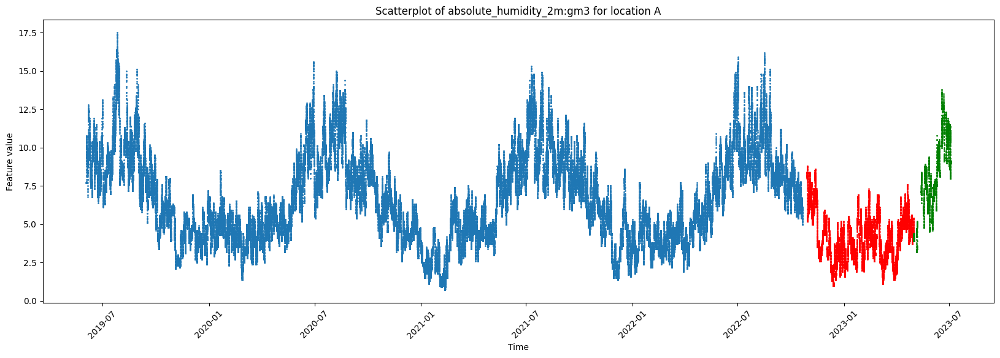

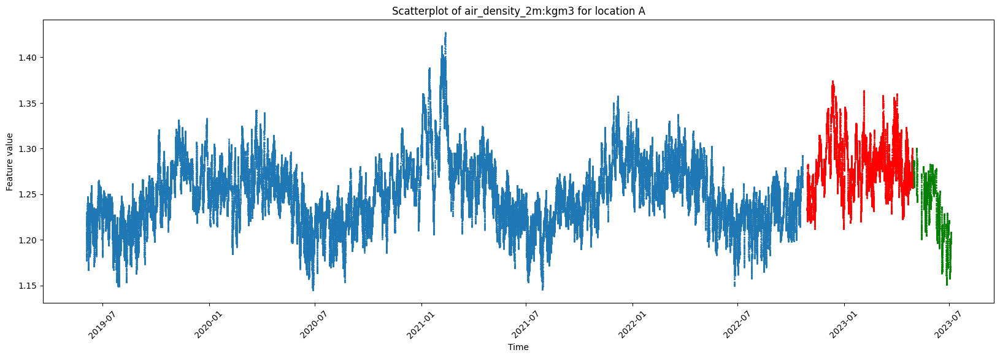

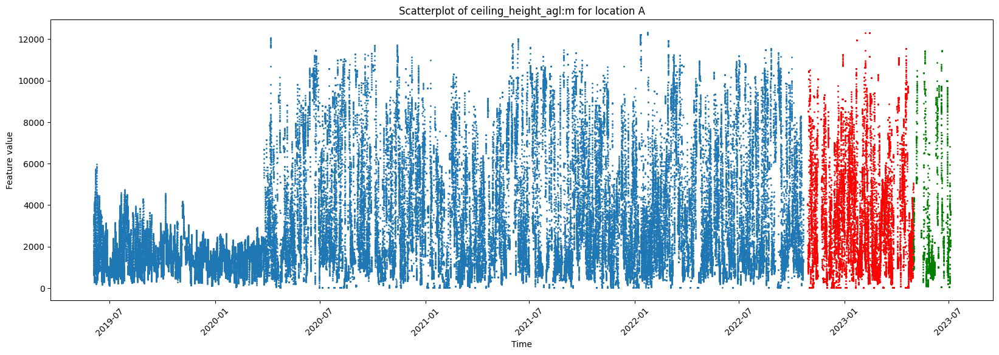

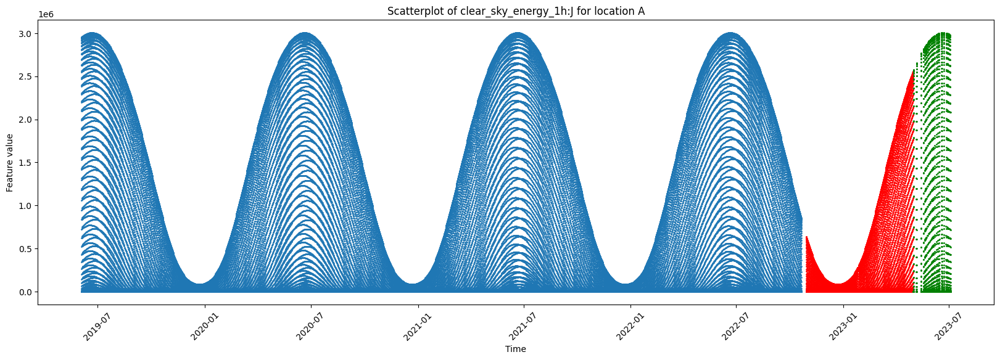

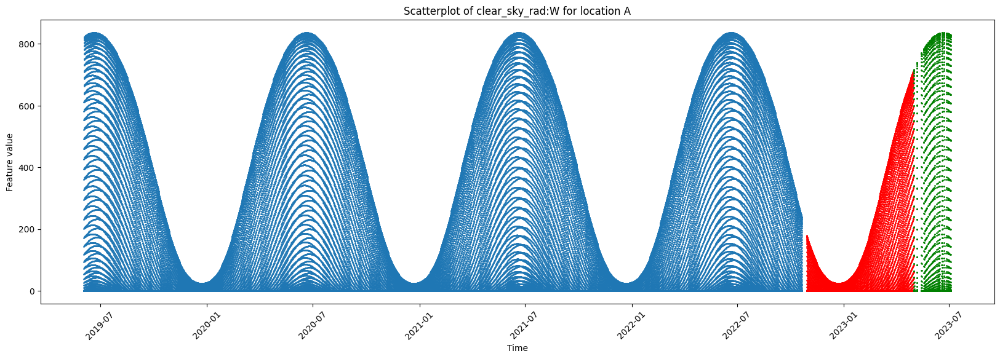

...

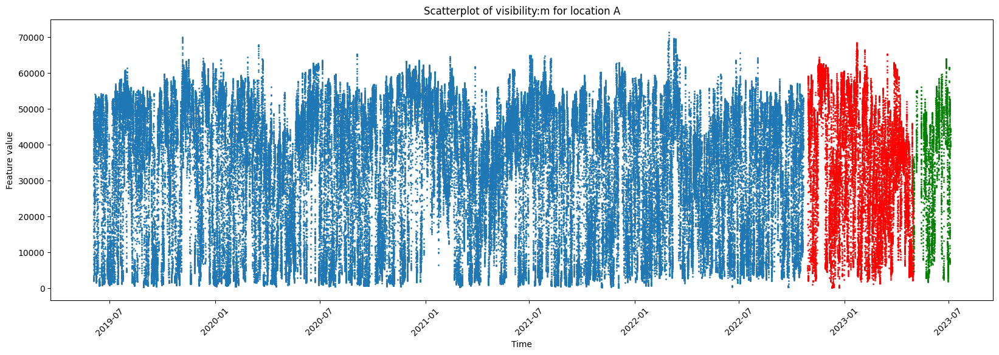

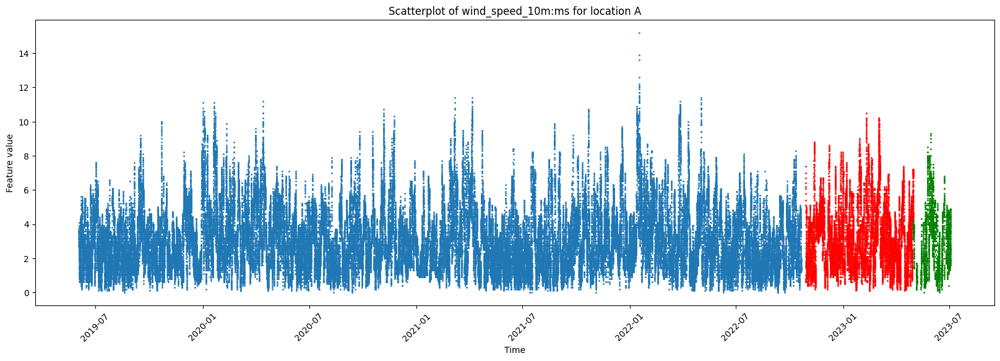

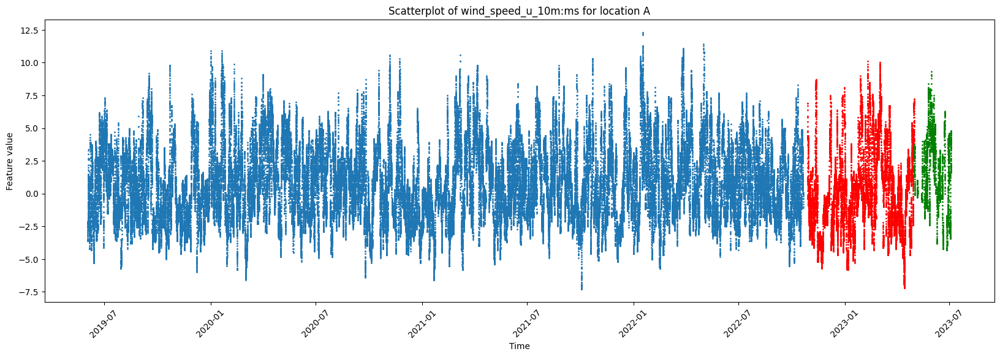

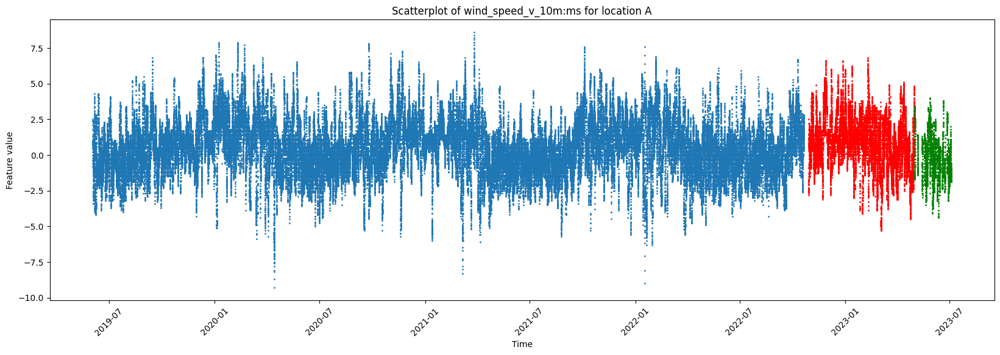

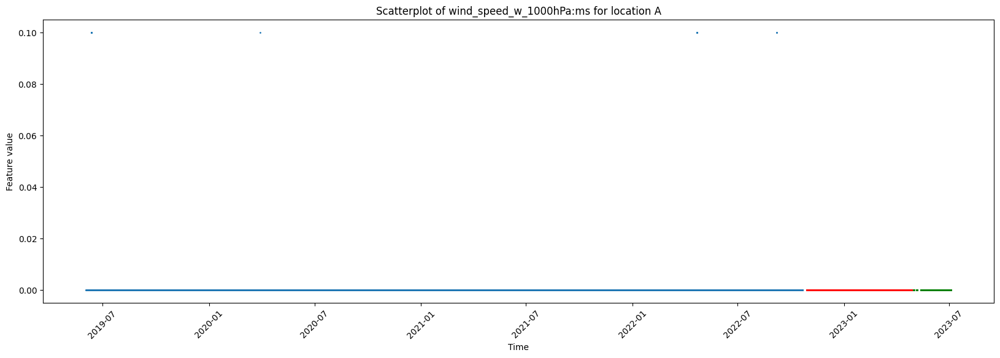

In [46]:
makeSuperManyPlots(X_train_observed_a,X_train_estimated_a, X_test_estimated_a,"A")

#### B

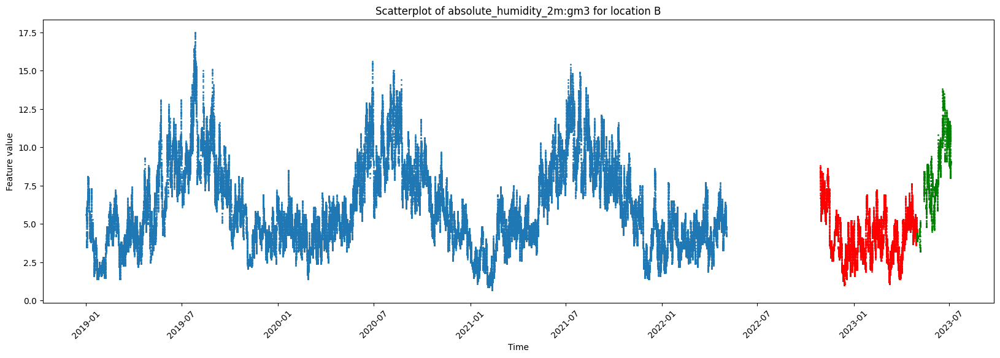

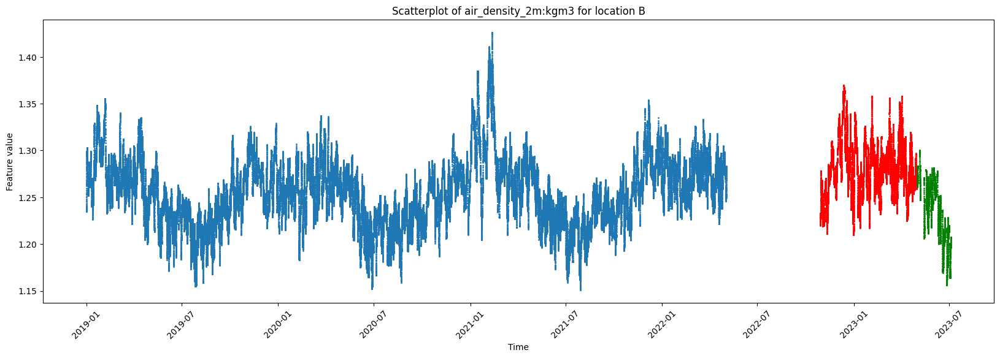

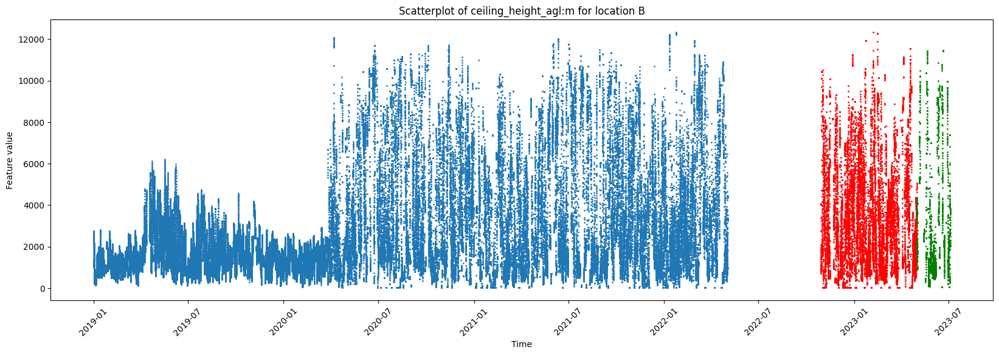

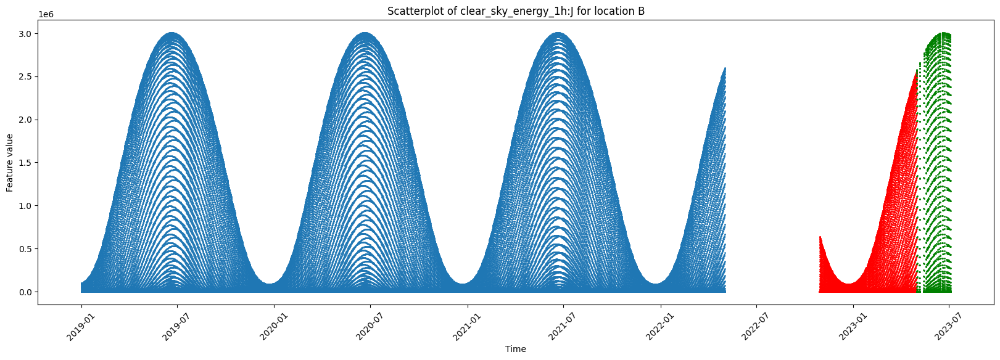

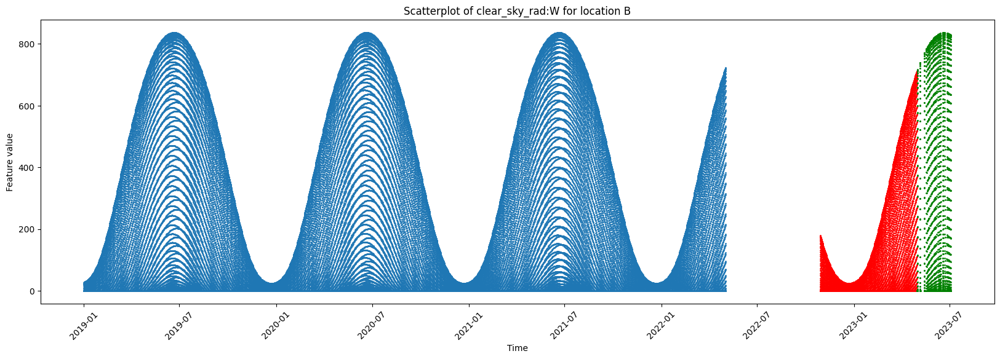

...

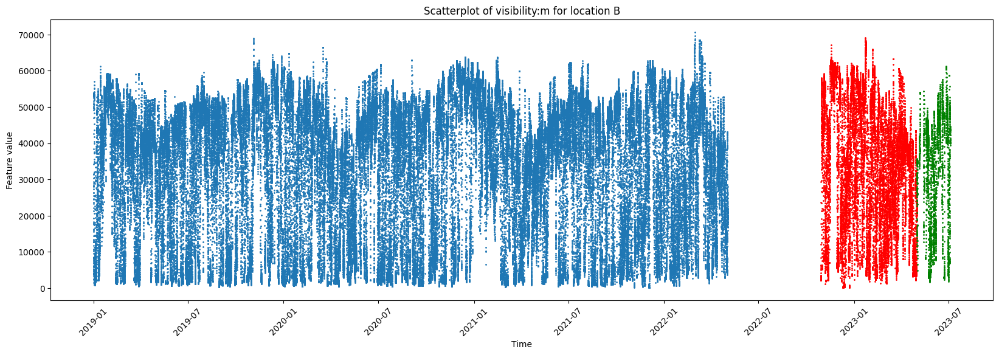

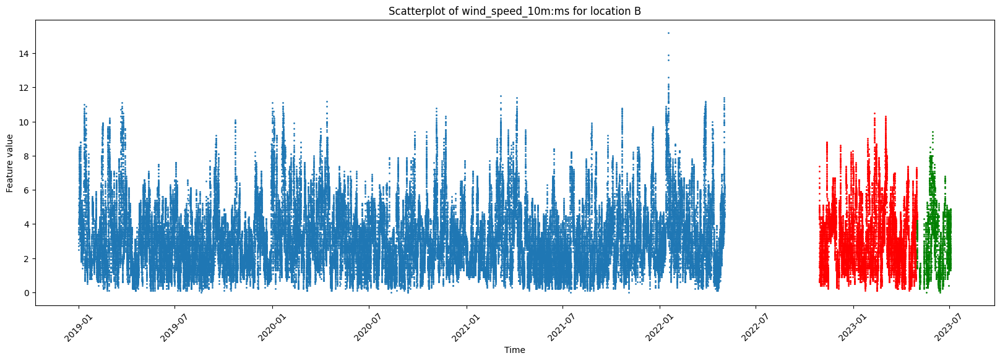

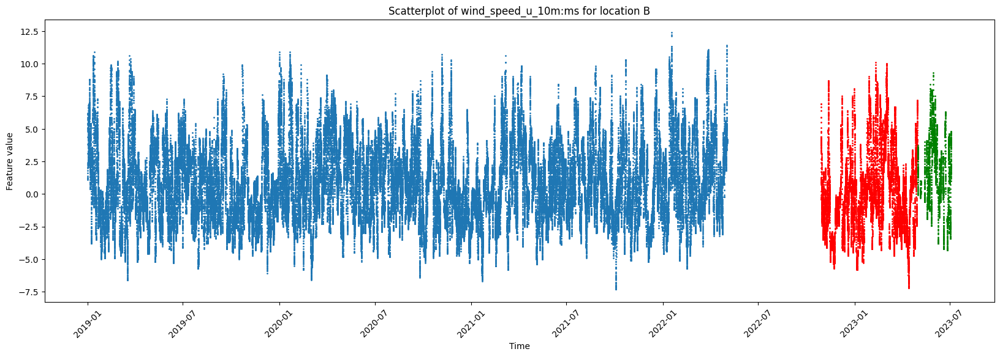

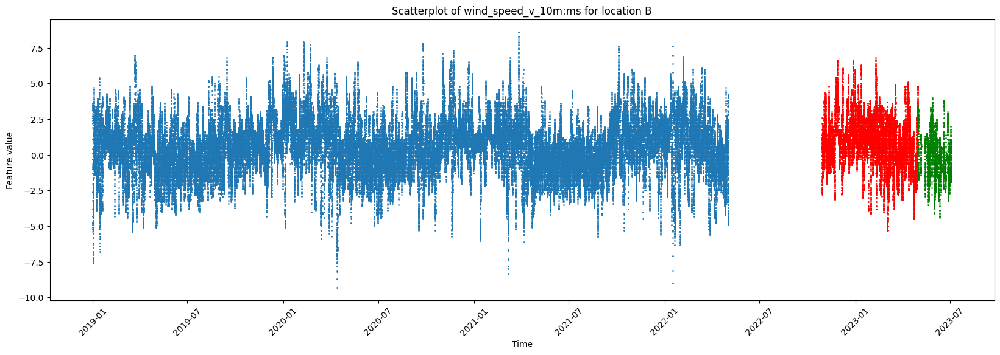

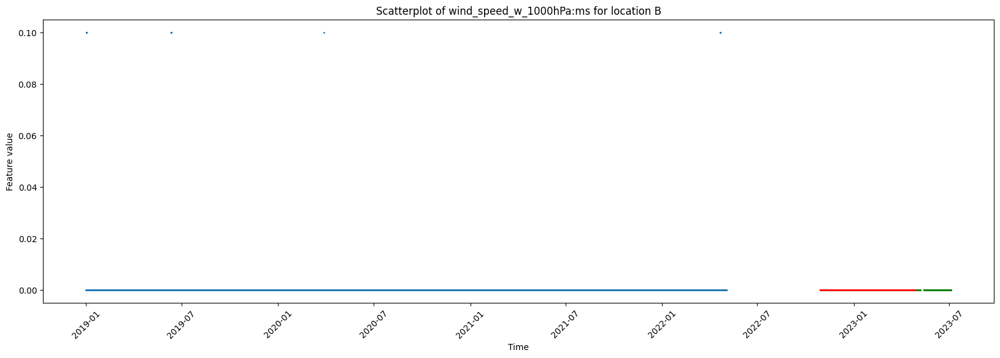

In [47]:
makeSuperManyPlots(X_train_observed_b,X_train_estimated_b, X_test_estimated_b,"B")

#### C

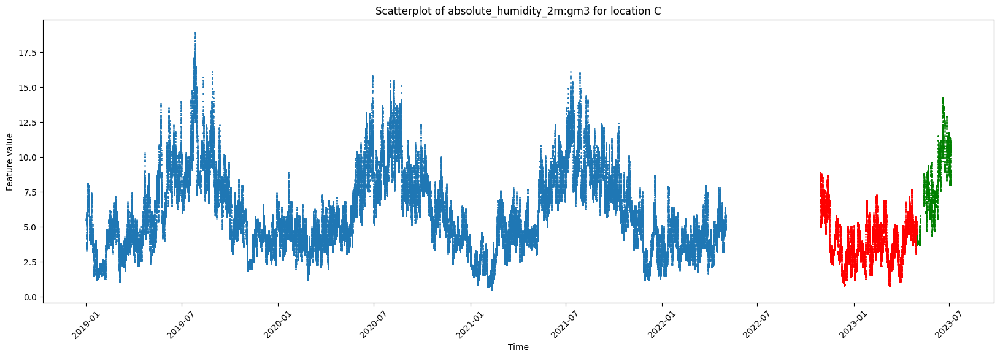

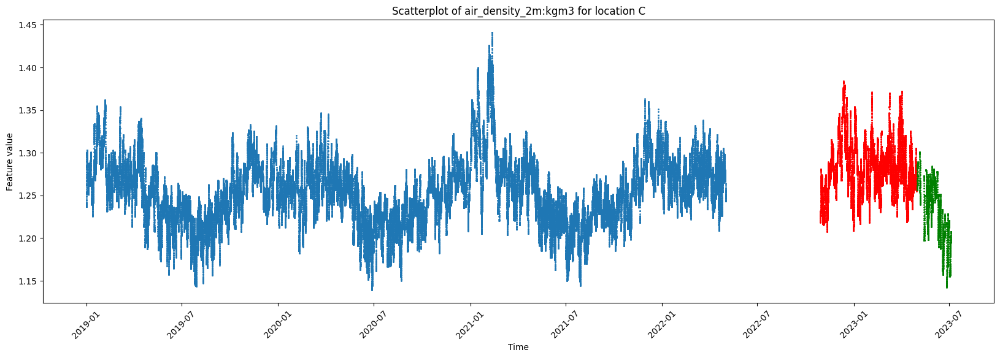

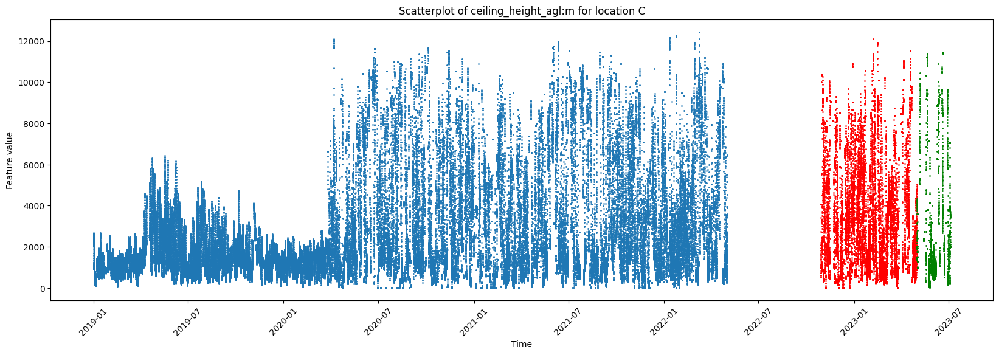

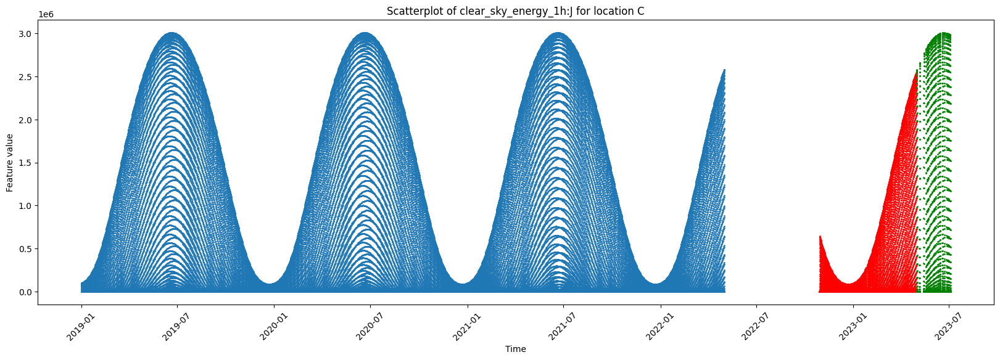

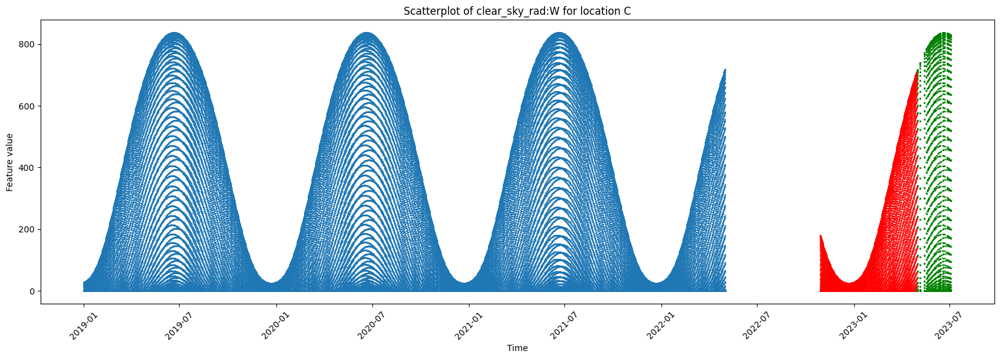

...

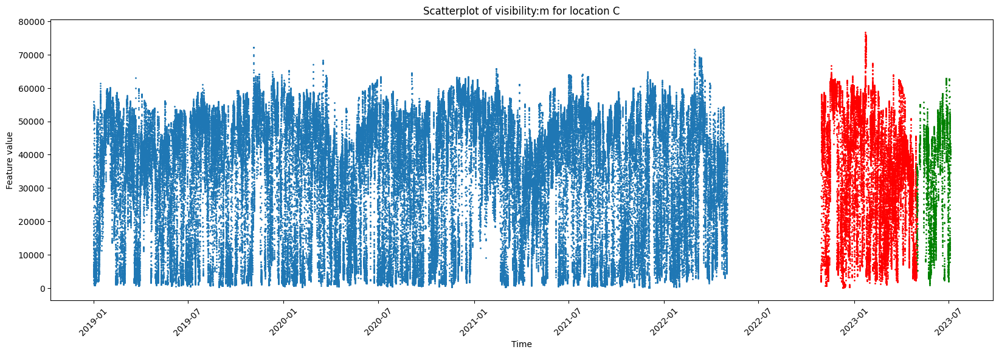

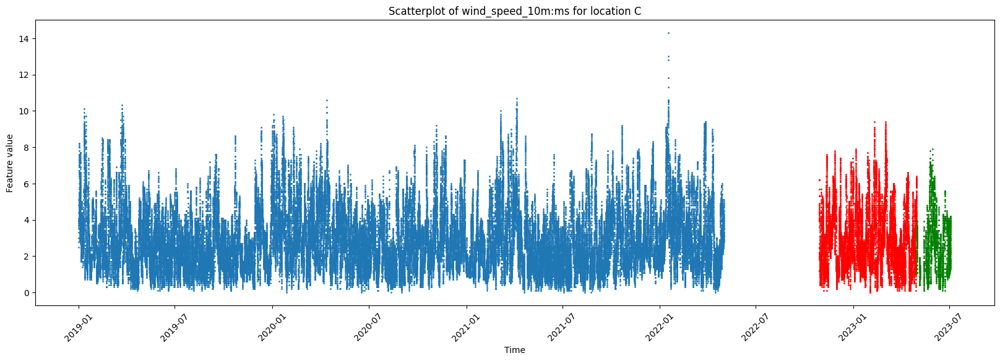

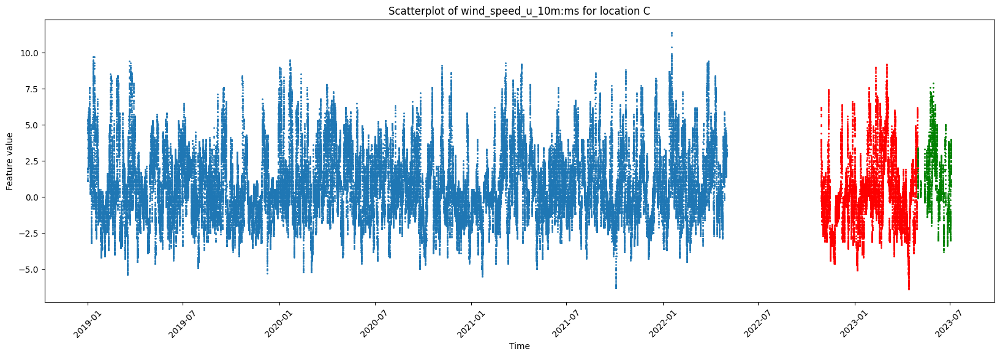

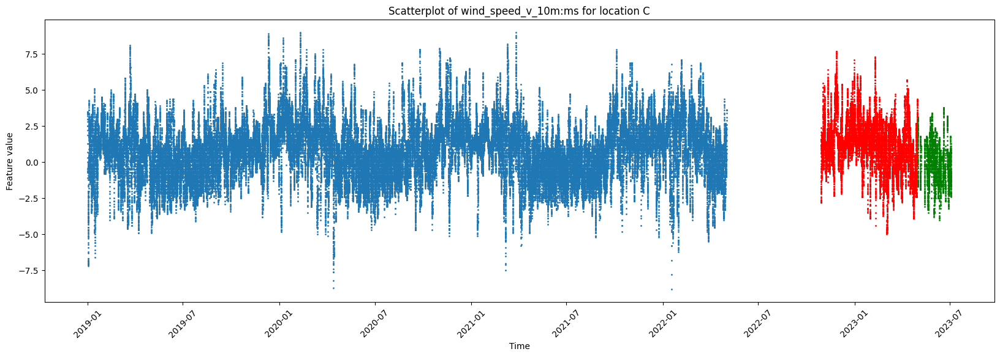

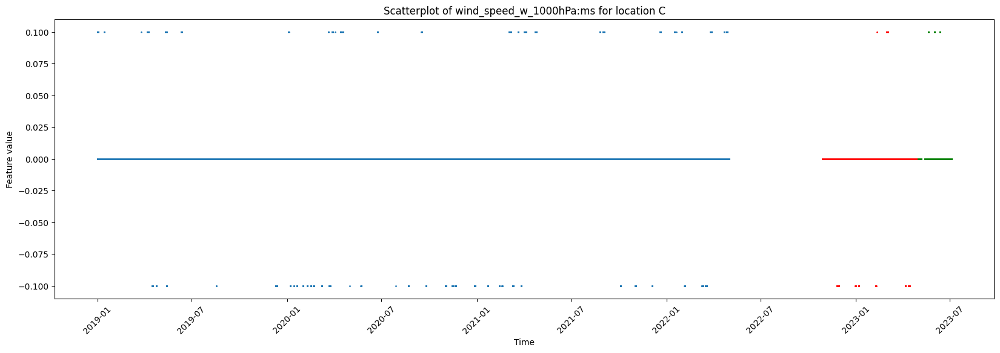

In [48]:
makeSuperManyPlots(X_train_observed_c,X_train_estimated_c, X_test_estimated_c,"C")

#### Observations

We can see that the features cloud_base and ceiling_heigt see to have lower measurements for a period in the start, which is weird, or maybe it is here alle the missing values should be. 

Also, the snow-density feature has a lot of NaN values. It might be that the NaNs should actually be 0's

Anyways these features might be subject to cleaning

### 2.4.4 - Date forecast and date calc

Let's look at the difference in the date_calc and date_forecast for the esimated sets. 

A

In [6]:
# A estimated
X_train_estimated_a_copy = X_train_estimated_a.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_train_estimated_a_copy["time_diff"] = X_train_estimated_a_copy["date_forecast"] - X_train_estimated_a_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Train estimated")
print(X_train_estimated_a_copy["time_diff"].min())
print(X_train_estimated_a_copy["time_diff"].mean())
print(X_train_estimated_a_copy["time_diff"].median())
print(X_train_estimated_a_copy["time_diff"].max())

# A test
X_test_estimated_a_copy = X_test_estimated_a.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_test_estimated_a_copy["time_diff"] = X_test_estimated_a_copy["date_forecast"] - X_test_estimated_a_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Test estimated")
print(X_test_estimated_a_copy["time_diff"].min())
print(X_test_estimated_a_copy["time_diff"].mean())
print(X_test_estimated_a_copy["time_diff"].median())
print(X_test_estimated_a_copy["time_diff"].max())




Train estimated
0 days 15:57:04
1 days 04:04:36.966772
1 days 03:59:56
1 days 16:44:57
Test estimated
0 days 16:58:37
1 days 04:52:09.300000
1 days 04:51:47
1 days 16:44:57


B

In [7]:
# B estimated
X_train_estimated_b_copy = X_train_estimated_b.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_train_estimated_b_copy["time_diff"] = X_train_estimated_b_copy["date_forecast"] - X_train_estimated_b_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Train estimated")
print(X_train_estimated_b_copy["time_diff"].min())
print(X_train_estimated_b_copy["time_diff"].mean())
print(X_train_estimated_b_copy["time_diff"].median())
print(X_train_estimated_b_copy["time_diff"].max())

# B test
X_test_estimated_b_copy = X_test_estimated_b.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_test_estimated_b_copy["time_diff"] = X_test_estimated_b_copy["date_forecast"] - X_test_estimated_b_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Test estimated")
print(X_test_estimated_b_copy["time_diff"].min())
print(X_test_estimated_b_copy["time_diff"].mean())
print(X_test_estimated_b_copy["time_diff"].median())
print(X_test_estimated_b_copy["time_diff"].max())


Train estimated
0 days 15:57:04
1 days 04:04:36.966772
1 days 03:59:56
1 days 16:44:57
Test estimated
0 days 16:58:37
1 days 04:52:09.300000
1 days 04:51:47
1 days 16:44:57


C

In [8]:
# C estimated
X_train_estimated_c_copy = X_train_estimated_c.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_train_estimated_c_copy["time_diff"] = X_train_estimated_c_copy["date_forecast"] - X_train_estimated_c_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Train estimated")
print(X_train_estimated_c_copy["time_diff"].min())
print(X_train_estimated_c_copy["time_diff"].mean())
print(X_train_estimated_c_copy["time_diff"].median())
print(X_train_estimated_c_copy["time_diff"].max())

# C test
X_test_estimated_c_copy = X_test_estimated_c.copy()

# making a coloumn of the time difference between date_calc and date_forecast
X_test_estimated_c_copy["time_diff"] = X_test_estimated_c_copy["date_forecast"] - X_test_estimated_c_copy["date_calc"]

#finding the min, mean, median, max of time difference
print("Test estimated")
print(X_test_estimated_c_copy["time_diff"].min())
print(X_test_estimated_c_copy["time_diff"].mean())
print(X_test_estimated_c_copy["time_diff"].median())
print(X_test_estimated_c_copy["time_diff"].max())


Train estimated
0 days 15:57:04
1 days 04:04:36.966772
1 days 03:59:56
1 days 16:44:57
Test estimated
0 days 16:58:37
1 days 04:52:09.300000
1 days 04:51:47
1 days 16:44:57


We can see that the min, mean, median and max differences between the time at which a forecast is given and the time it belongs to is same for all location. All calulcated forecasts are never more than 2 days prior to the time it gives forecasts for. 

We can also plot the difference to if there are any sudden shifts.

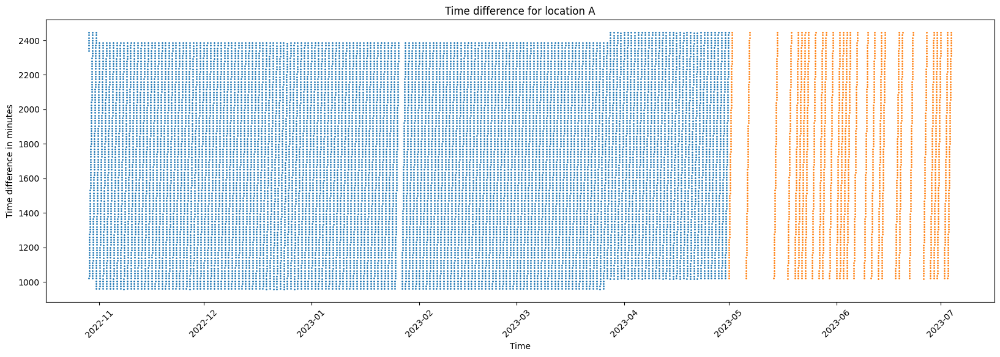

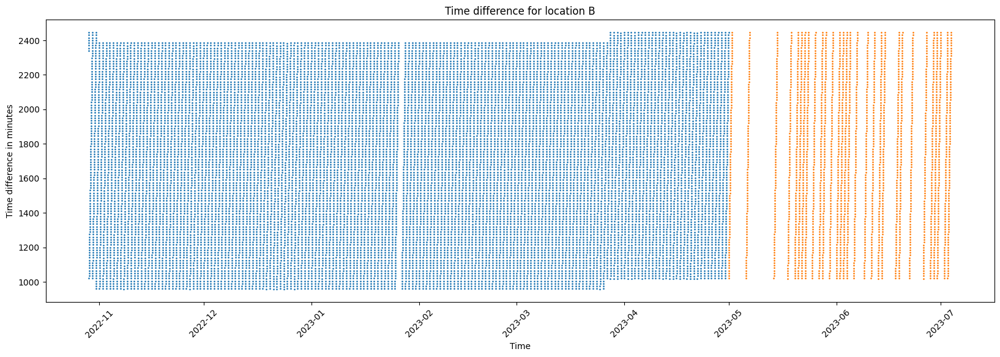

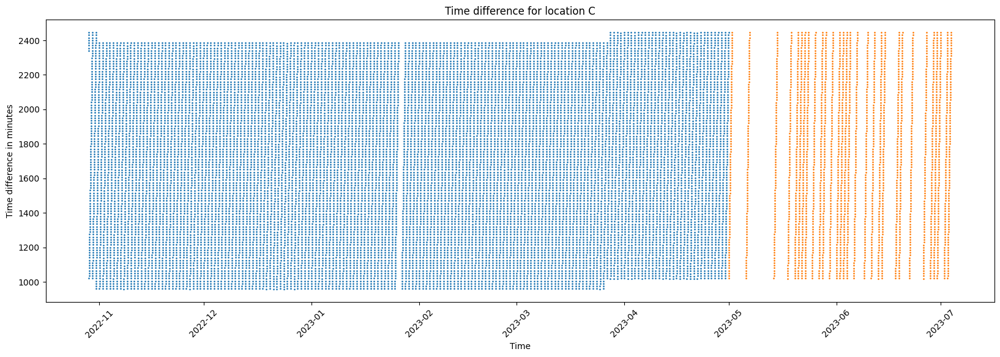

In [10]:
#A 
# plotting the time difference for train estimated in minutes, with date_forecast on the x axis and time_diff on the y axis
plt.figure(figsize=(20,6))
plt.scatter(X_train_estimated_a_copy["date_forecast"], X_train_estimated_a_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.scatter(X_test_estimated_a_copy["date_forecast"], X_test_estimated_a_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.xlabel("Time")
plt.ylabel("Time difference in minutes")
plt.title("Time difference for location A")
plt.xticks(rotation=45)
plt.show()

#B
# plotting the time difference for train estimated in minutes, with date_forecast on the x axis and time_diff on the y axis
plt.figure(figsize=(20,6))
plt.scatter(X_train_estimated_b_copy["date_forecast"], X_train_estimated_b_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.scatter(X_test_estimated_b_copy["date_forecast"], X_test_estimated_b_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.xlabel("Time")
plt.ylabel("Time difference in minutes")
plt.title("Time difference for location B")
plt.xticks(rotation=45)
plt.show()

#C
# plotting the time difference for train estimated in minutes, with date_forecast on the x axis and time_diff on the y axis
plt.figure(figsize=(20,6))
plt.scatter(X_train_estimated_c_copy["date_forecast"], X_train_estimated_c_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.scatter(X_test_estimated_c_copy["date_forecast"], X_test_estimated_c_copy["time_diff"].dt.total_seconds()/60, s=1)
plt.xlabel("Time")
plt.ylabel("Time difference in minutes")
plt.title("Time difference for location C")
plt.xticks(rotation=45)
plt.show()

Interestingly, we can see that for all locations, there is a shift towards longer time between the time at which the forecast is calculated and for the time it is calculated/forecasted for. This indicates that the meterologists started giving earlier weather forecasts than before. 

### 2.4.5 - Overlap

Over we saw that the observed and estimated data where very close in time, so let's check for overlap between observed and estimated, and estimated and test

#### A

In [49]:
#finding the first element of the estimated training set, and the last element of the estimated test set to se iff there is overlap
last_element_of_A_estimated_train = X_train_estimated_a.iloc[-1:]
last_element_of_A_estimated_train.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
17575,2023-04-29 07:00:05,2023-04-30 23:45:00,4.5,1.281,2198.899902,0.0,0.0,510.700012,0.0,272.299988,...,7.782,-11.69,0.0,274.299988,99.300003,13809.099609,3.8,2.7,2.7,-0.0


In [50]:
first_element_of_A_estimated_training = X_test_estimated_a.iloc[[0]]
first_element_of_A_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.52,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0


In [51]:
#Doing the same for observed and estimated trained data as well, althoug I don't think there is overlap
last_element_of_A_observed_training = X_train_observed_a.iloc[-1:]
last_element_of_A_observed_training.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
118668,2022-10-21 01:00:00,5.0,1.292,NaN,0.0,0.0,NaN,0.0,273.600006,0.0,...,34.306999,-33.417,0.0,276.399994,0.5,36795.0,1.5,-1.1,1.0,-0.0


In [52]:
first_element_of_A_estimated_training = X_test_estimated_a.iloc[[0]]
first_element_of_A_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.52,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0


We can see that no date_forcast values overlap

#### B

In [53]:
#finding the first element of the estimated training set, and the last element of the estimated test set to se iff there is overlap
last_element_of_B_estimated_train = X_train_estimated_b.iloc[-1:]
last_element_of_B_estimated_train.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
17575,2023-04-29 07:00:05,2023-04-30 23:45:00,4.5,1.28,2200.100098,0.0,0.0,510.299988,0.0,272.299988,...,7.782,-11.69,0.0,274.299988,99.300003,14062.900391,3.8,2.7,2.7,-0.0


In [54]:
first_element_of_B_estimated_training = X_test_estimated_b.iloc[[0]]
first_element_of_B_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.3,1.283,912.299988,0.0,0.0,1039.900024,0.0,271.700012,...,10.521,-11.184,0.0,273.799988,80.699997,31329.5,4.0,2.2,3.4,-0.0


In [55]:
#Doing the same for observed and estimated trained data as well, althoug I don't think there is overlap
last_element_of_B_observed_training = X_train_observed_b.iloc[-1:]
last_element_of_B_observed_training.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
116928,2022-05-03,4.2,1.283,NaN,0.0,0.0,681.200012,0.0,271.399994,0.0,...,10.293,-10.528,0.0,274.200012,52.299999,18278.5,4.6,4.2,-2.0,0.0


In [56]:
first_element_of_B_estimated_training = X_test_estimated_b.iloc[[0]]
first_element_of_B_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.3,1.283,912.299988,0.0,0.0,1039.900024,0.0,271.700012,...,10.521,-11.184,0.0,273.799988,80.699997,31329.5,4.0,2.2,3.4,-0.0


No overlap

#### C

In [57]:
#finding the first element of the estimated training set, and the last element of the estimated test set to se iff there is overlap
last_element_of_C_estimated_train = X_train_estimated_c.iloc[-1:]
last_element_of_C_estimated_train.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
17575,2023-04-29 07:00:05,2023-04-30 23:45:00,4.4,1.279,2071.800049,0.0,0.0,547.799988,0.0,271.899994,...,7.78,-11.728,0.1,274.200012,99.699997,12357.099609,3.0,2.0,2.3,-0.0


In [58]:
first_element_of_C_estimated_training = X_test_estimated_c.iloc[[0]]
first_element_of_C_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.2,1.286,NaN,0.0,0.0,1178.0,0.0,271.100006,...,10.519,-11.223,0.0,273.700012,73.699997,31411.0,3.5,1.5,3.1,-0.0


In [59]:
#Doing the same for observed and estimated trained data as well, althoug I don't think there is overlap
last_element_of_C_observed_training = X_train_observed_c.iloc[-1:]
last_element_of_C_observed_training.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
116824,2022-05-01 22:00:00,4.8,1.255,1545.300049,0.0,0.0,1328.400024,0.0,273.399994,0.0,...,341.709015,-10.262,0.2,279.100006,100.0,38570.898438,5.1,3.6,3.6,-0.0


In [60]:
first_element_of_C_estimated_training = X_test_estimated_c.iloc[[0]]
first_element_of_C_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.2,1.286,NaN,0.0,0.0,1178.0,0.0,271.100006,...,10.519,-11.223,0.0,273.700012,73.699997,31411.0,3.5,1.5,3.1,-0.0


### 2.4.4 Correlation Map - Correlation Between Features per Location

Let's look at the correlation between all features in the dataset

##### 2.4.4.1  Location A

Text(0.5, 1.0, 'Correlation Heatmap (X_train_observed_A)')

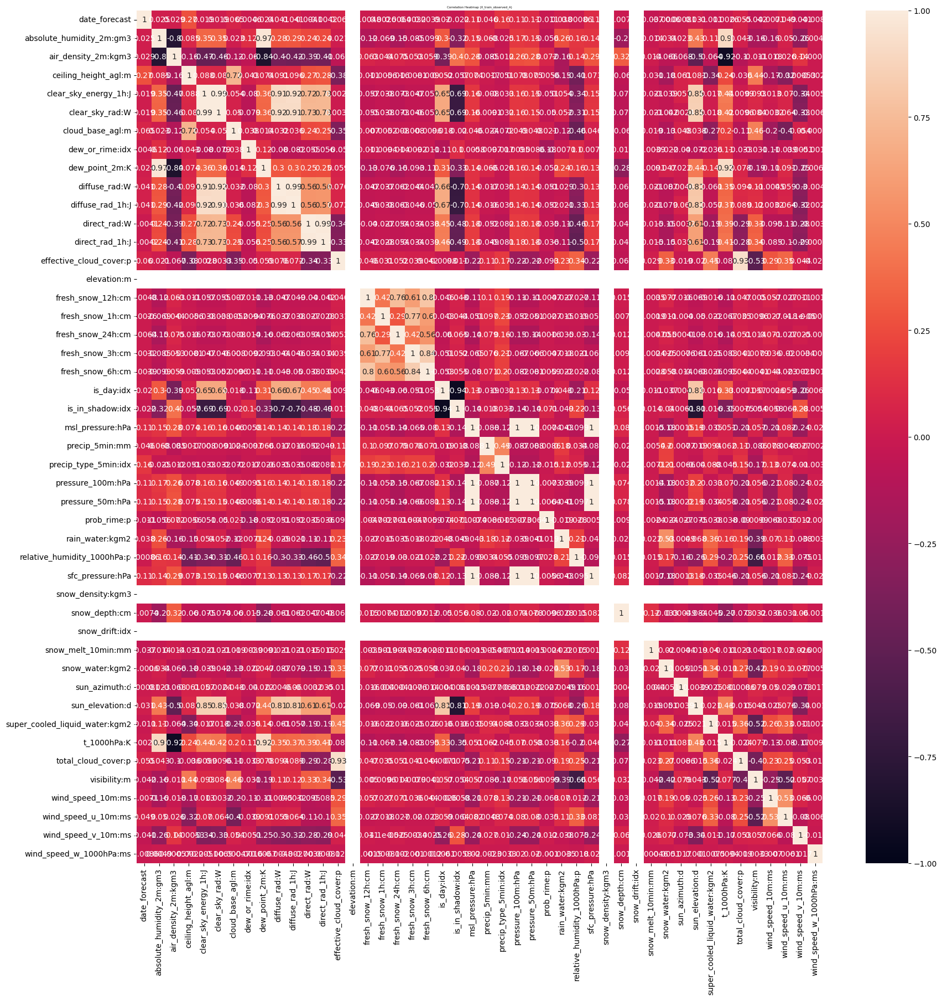

In [61]:
plt.figure(figsize=(20, 20))
heatmap = sns.heatmap(X_train_observed_a.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap (X_train_observed_A)', fontdict={'fontsize':4}, pad=4)


##### 2.4.4.1  Location B

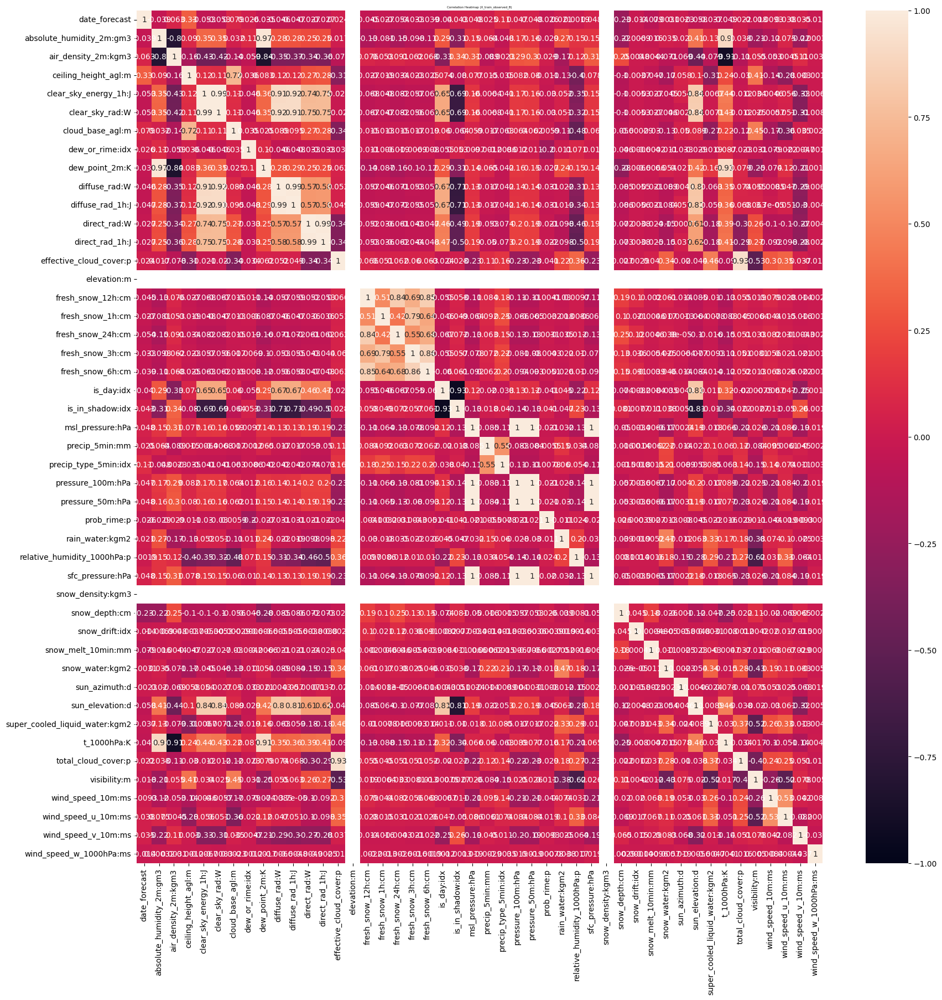

In [62]:
plt.figure(figsize=(20, 20))
heatmap = sns.heatmap(X_train_observed_b.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap (X_train_observed_B)', fontdict={'fontsize':4}, pad=4);

##### 2.4.4.1  Location C

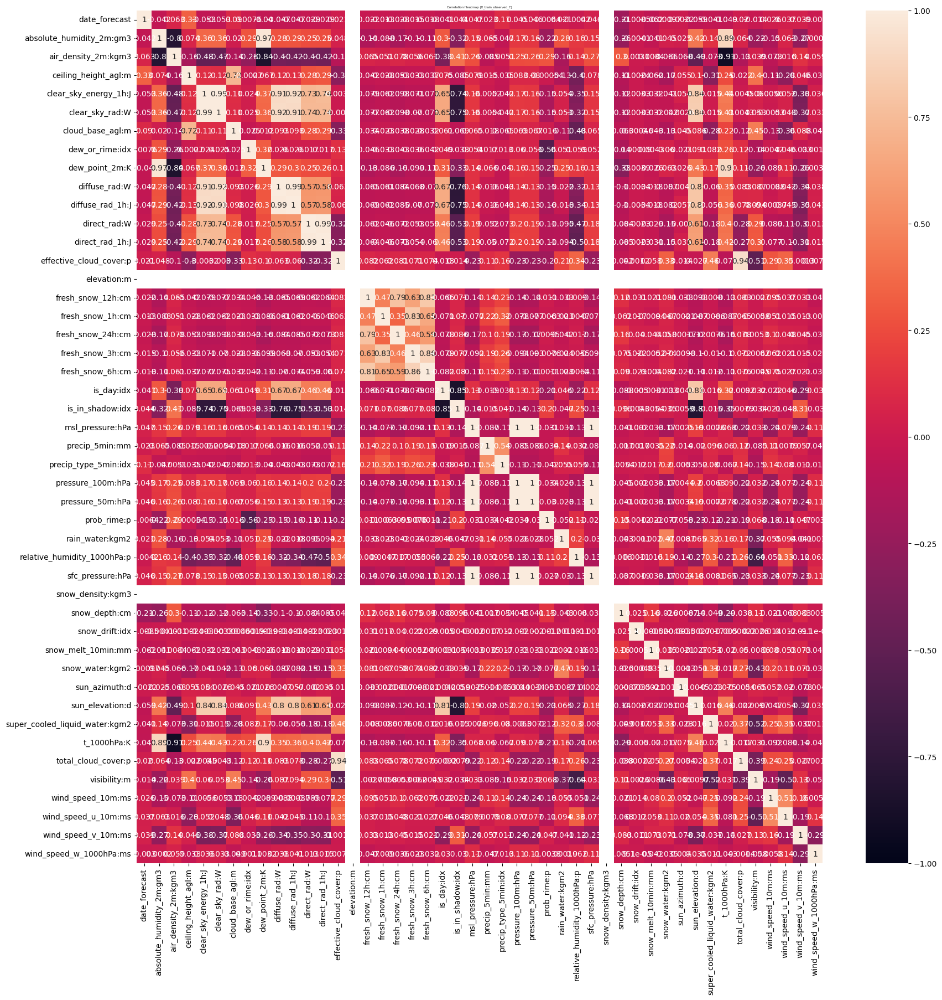

In [63]:
plt.figure(figsize=(20, 20))
heatmap = sns.heatmap(X_train_observed_c.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap (X_train_observed_C)', fontdict={'fontsize':4}, pad=4);

# 3 - Preprocessing <a id='3'></a>

### 3.1 - Dataset loading <a id='31'></a>

First we load all datasets again

In [4]:
# Load data

y_data = {}
y_test_data = pd.read_csv(f"../data/test.csv")
X_test_estimated_data = {}
X_train_estimated_data = {}
X_train_observed_data = {}
locations = ["A", "B", "C"]

for location in locations:
    y_data[location] = pd.read_parquet(f"../data/{location}/train_targets.parquet")

    X_test_estimated_data[location] = pd.read_parquet(
        f"../data/{location}/X_test_estimated.parquet"
    )
    X_train_estimated_data[location] = pd.read_parquet(
        f"../data/{location}/X_train_estimated.parquet"
    )
    X_train_observed_data[location] = pd.read_parquet(
        f"../data/{location}/X_train_observed.parquet"
    )

Then we combine all data so it is more efficient to work with

In [5]:
# Combine data

combine_data = (
    lambda data: pd.concat(data.values(), keys=data.keys())
    .reset_index()
    .drop(columns="level_1")
    .rename(columns={"level_0": "location"})
)

y = combine_data(y_data).sort_values(by=["time", "location"])

y_test_data = y_test_data.rename(columns={"prediction": "pv_measurement"})
y_test_data = y_test_data[["time", "location", "pv_measurement"]]

# Add Kaggle test data to y
y = pd.concat([y, y_test_data]).sort_values(by=["time", "location"])
y["time"] = pd.to_datetime(y["time"])

X_train_observed = combine_data(X_train_observed_data).assign(data_type="observed")
X_train_estimated = combine_data(X_train_estimated_data).assign(data_type="estimated")
X_test_estimated = combine_data(X_test_estimated_data).assign(data_type="test")

X = pd.concat([X_train_observed, X_train_estimated, X_test_estimated]).sort_values(
    by=["date_forecast", "location"]
)

print("X shape:", X.shape)
print("y shape:", y.shape)

X shape: (413791, 49)
y shape: (101248, 3)


### 3.2 - Data cleaning <a id='32'></a>

#### 3.2.1 - Resample data to hourly granularity

We resample tby taking the mean over the hour (15 minute points), to get points that have hour timestamps. For some coloumns we don't take the average but choose to take the first. This goes for categorical features, for example preicp_type_5min would not make sense to take average, as there are 6 different categories represented by numbers. 

In [6]:
# Custom aggregation function
def custom_resample(aggregation_dict): 
    result = {}
    for column in X.columns:
        if column in ["date_forecast"]:
            continue

        aggregation = aggregation_dict.get(column, 'mean')  # Use 'mean' by default

        result[column] = aggregation
    return result

# Specify the aggregation method for specific columns
aggregation_dict = {
    "location": "first",
    "data_type": "first",

    # Categorical weather features
    "is_day:idx": "first",
    "is_in_shadow:idx": "first",
    "precip_type_5min:idx": "first",
    "dew_or_rime:idx": "first",
    "snow_drift:idx": "first",
}

X = (
    X.set_index("date_forecast")
    .groupby("location")
    .resample("H")
    .apply(custom_resample(aggregation_dict))
    .drop(columns=["location"])
    .reset_index()
    .sort_values(by=["date_forecast", "location"])
    .reset_index(drop=True)
)


#### 3.2.2 - Remove NaN rows

Next we remove all NaN rows that we identified in the EDA section was a problem

In [7]:
# Find all rows that only contain NaN in X

nan_rows = X[X.drop(columns=["date_forecast", "location"]).isna().all(axis=1)].index

X = X.drop(nan_rows).reset_index(drop=True)
display(X.describe())

# Find all rows that only contain NaN in y

nan_rows = y[y.drop(columns=["time", "location"]).isna().all(axis=1)].index

y = y.drop(nan_rows).reset_index(drop=True)
display(y.describe())

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms,date_calc
count,103450,103450.000000,103450.000000,85710.000000,1.034500e+05,103450.000000,95988.000000,103450.000000,103450.000000,103450.000000,...,103450.000000,103450.000000,103450.000000,103450.000000,103450.000000,103450.000000,103450.000000,103450.000000,103450.000000,15342
mean,2021-02-27 11:19:43.458675,6.022451,1.255468,2818.218750,5.340856e+05,148.357071,1728.615723,0.002707,275.193604,40.692169,...,-0.686007,0.056825,279.437866,73.615753,33047.601562,3.017211,0.677701,0.670877,0.000048,2023-02-14 19:23:08.778255
min,2019-01-01 00:00:00,0.500000,1.139250,27.600000,0.000000e+00,0.000000,27.299997,-1.000000,247.425003,0.000000,...,-49.931999,0.000000,258.024994,0.000000,132.375000,0.025000,-7.225000,-8.400000,-0.100000,2022-10-27 07:00:18
25%,2020-02-15 04:00:00,4.000000,1.230000,1063.206177,0.000000e+00,0.000000,602.687500,0.000000,270.600006,0.000000,...,-17.985250,0.000000,274.799988,52.900002,17214.430664,1.675000,-1.325000,-0.600000,0.000000,2022-12-20 08:01:43
50%,2021-02-08 08:30:00,5.450000,1.255000,1847.675049,1.444562e+04,2.350000,1170.074951,0.000000,275.000000,1.400000,...,-0.422625,0.000000,278.700012,93.025002,36858.449219,2.675000,0.325000,0.700000,0.000000,2023-02-12 08:00:04
75%,2022-02-02 13:00:00,7.900000,1.279000,3831.431152,8.463045e+05,233.250000,2085.399902,0.000000,280.649994,68.193748,...,16.086188,0.100000,284.093758,99.925003,48121.931641,4.025000,2.500000,1.850000,0.000000,2023-04-06 07:00:03
max,2023-07-03 23:00:00,18.700001,1.441000,12294.901367,2.990596e+06,835.650024,11673.724609,1.000000,294.924988,334.750000,...,49.943748,1.375000,303.250000,100.000000,75489.328125,13.275000,11.200000,8.825000,0.100000,2023-07-02 07:00:31
std,NaN,2.766933,0.037343,2490.036865,8.363739e+05,232.910690,1777.656860,0.254857,7.007361,61.679428,...,24.151178,0.105950,6.689478,34.071289,17768.177734,1.743098,2.773586,1.871724,0.006387,NaN


,time,pv_measurement
count,95184,95184.000000
mean,2021-03-24 10:51:46.807866880,280.506347
min,2018-12-31 23:00:00,0.000000
25%,2020-04-08 15:45:00,0.000000
50%,2021-03-05 05:30:00,0.000000
75%,2022-01-29 20:00:00,161.287500
max,2023-07-03 23:00:00,5733.420000
std,NaN,758.866540


#### 3.2.3 - Remove repeated values

Next we make a function that can take in a dataset and remove repeated values, if there are repeated values in a given coloumn for more than a given count times in a row. This is because of the repeated valeus we saw in the PV-measurement plots for especcialy B above. We also let the function take input if it should ignore 0 values or not. This is bacause there are a lot of repeated 0 values in the train targets sets. We initially removed those, but sometimes it might make sense to have a lot of 0 in a row if the panels are covered by snow for multiple days for example. Therefore we wanted to make the funtion flexible so we could test different values for how the limit of how many time a value could repeat itself, and if 0 was included or not. 

In [8]:
# Remove repeated values

def find_repeated_indexes(df, column_name, repeat_count=12, ignore_zeros=True) -> list:
    """
    Find and return the indexes of rows with a specified number of repeated values in a given column.

    Parameters:
    - df: DataFrame to search for repeated rows.
    - column_name: Name of the column to check for repeated values.
    - repeat_count: Number of repeated values required to consider a row as a match.

    Returns:
    - List of indexes for rows with the specified number of repeated values in the given column.
    """
    repeated_indexes = []
    temp_repeated_indexes = []
    current_value = None

    for index, row in df.iterrows():
        value = row[column_name]

        if value == 0 and ignore_zeros:
            continue

        if value == current_value:
            temp_repeated_indexes.append(index)
        else:
            current_value = value
            if len(temp_repeated_indexes) <= repeat_count:
                temp_repeated_indexes.clear()
            else:
                repeated_indexes.extend(
                    set(temp_repeated_indexes) - set(repeated_indexes)
                )
                temp_repeated_indexes.clear()

    return repeated_indexes

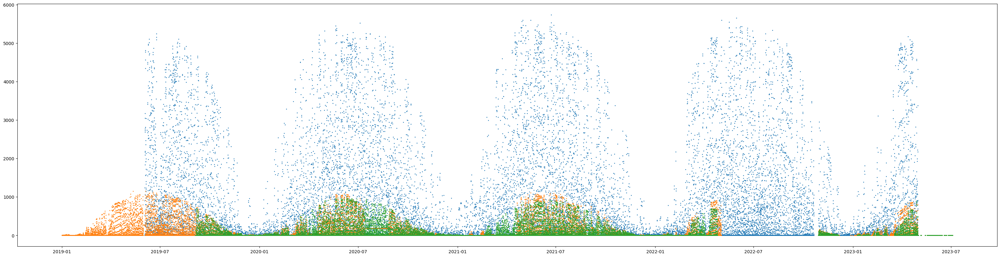

In [9]:
# Visulize data per location
plt.figure(figsize=(40, 10))

for location in locations:
    plt.scatter(y[y.location == location].time, y[y.location == location]["pv_measurement"], s=1)

### 3.3 - Combine X and y <a id='33'></a>

#### 3.3.1 Create standard preprocessing data

Our standard processing data, the one used for most models

In [10]:
# Remove repeated values (Version 1)

# Create a copy of X and y
X_standard = X.copy()
y_standard = y.copy()

for location in locations:
    # Drop rows with repeated values over 24 hours
    repeated_indexes = find_repeated_indexes(
        y_standard[y_standard.location == location].sort_values(by=["location", "time"]),
        "pv_measurement",
        repeat_count=24,
        ignore_zeros=True,
    )

    y_standard = y_standard.drop(repeated_indexes).reset_index(drop=True)

    # Drop rows with repeated zeros over 4 days,
    # ignore dates after '2023-05-01 00:00:00' as they are test data

    repeated_indexes = find_repeated_indexes(
        y_standard[(y_standard.location == location) & (y_standard.time <= "2023-05-01 00:00:00")].sort_values(
            by=["location", "time"]
        ),
        "pv_measurement",
        repeat_count=72,
        ignore_zeros=False,
    )

    y_standard = y_standard.drop(repeated_indexes).reset_index(drop=True)

In [11]:
# Combine X and y on date_forecast and location. Drop rows where a row does not exist in both X and y.

data_standard = pd.merge(
    X_standard, y_standard, left_on=["date_forecast", "location"], right_on=["time", "location"]
).drop(columns=["time"])

#### 3.3.2 Create simple preprocessing data 

Another processing example. It is the processing data used for some of the catboost models, and autogluon. 

In [12]:
# Remove repeated values (Version 2)

# Create a copy of X and y
X_simple = X.copy()
y_simple = y.copy()

for location in locations:
    # Drop rows with repeated values over 24 hours
    repeated_indexes = find_repeated_indexes(
        y_simple[y_simple.location == location].sort_values(by=["location", "time"]),
        "pv_measurement",
        repeat_count=48,
        ignore_zeros=True,
    )

    y_simple = y_simple.drop(repeated_indexes).reset_index(drop=True)

In [13]:
# Combine X and y on date_forecast and location. Drop rows where a row does not exist in both X and y.

data_simple = pd.merge(
    X_simple, y_simple, left_on=["date_forecast", "location"], right_on=["time", "location"]
).drop(columns=["time"])

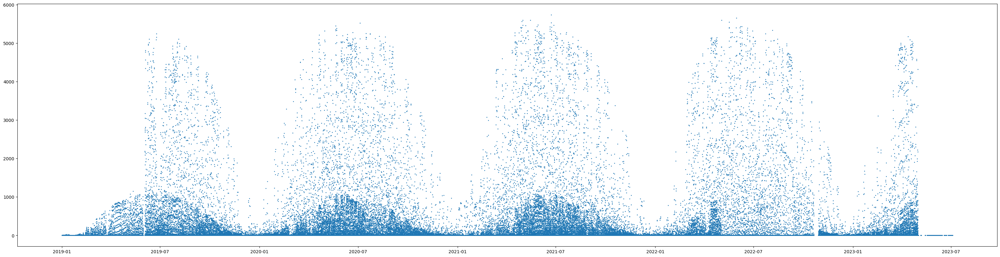

In [14]:
plt.figure(figsize=(40, 10))
plt.scatter(data_simple.date_forecast, data_simple["pv_measurement"], s=1)

### 3.4 - Feature Engineering <a id='34'></a>

#### 3.4.1 - Add sinus and cosinus features

We made a function that can sine and cosine transform features. This was used on some time features to help the model identify trends.

In [15]:
# Function that sinus and cosinus transform a column

def add_sin_cos(df, column_name, period):
    """
    Add sinus and cosinus transformed columns for the given column.

    Parameters:
    - df: DataFrame to add the transformed columns to.
    - column_name: Name of the column to transform.
    - period: Period of the sinus and cosinus functions.
    """
    df[f"{column_name}_sin"] = np.sin(2 * np.pi * df[column_name] / period)
    df[f"{column_name}_cos"] = np.cos(2 * np.pi * df[column_name] / period)


We transform hour and month to sine and cos features to help the model find effects over time

In [16]:
# Add sinus and cosinus transformed columns for time for data_standard

data_standard["hour"] = data_standard["date_forecast"].dt.hour
data_standard["month"] = data_standard["date_forecast"].dt.month

add_sin_cos(data_standard, "hour", 23)
add_sin_cos(data_standard, "month", 12)

In [17]:
# Add sinus and cosinus transformed columns for time for data_simple

data_simple["hour"] = data_simple["date_forecast"].dt.hour
data_simple["month"] = data_simple["date_forecast"].dt.month

add_sin_cos(data_simple, "hour", 23)
add_sin_cos(data_simple, "month", 12)

#### 3.4.2 - Transform sun_azimuth feature

We transform the sun_azimuth feature to a circular feature. This is because a low degree and high degree would both mean that the sun is low in the sky, so they should not differ. 

In [18]:
# Sun azimuth feature engineering

def convert_from_degree_to_ciruclar(df, feature):
    """
    Converts a feature from degree to circular
    """
    df[feature + "_sin"] = np.sin(np.radians(df[feature]))
    df[feature + "_cos"] = np.cos(np.radians(df[feature]))

    return df

In [19]:
# Convert sun_azimuth from degree to circular for data_standard
data_standard = convert_from_degree_to_ciruclar(data_standard, "sun_azimuth:d")

In [20]:
# Convert sun_azimuth from degree to circular for data_standard
data_simple = convert_from_degree_to_ciruclar(data_simple, "sun_azimuth:d")

### 3.5 - Result <a id='35'></a>

In [ ]:
# The two datasets used are data_standard and data_simple

In [21]:
data_standard.describe().T.drop(columns=["std", "25%", "50%", "75%"])

,count,mean,min,max
date_forecast,85205,2021-03-27 13:59:56.155155,2019-01-01 00:00:00,2023-07-03 23:00:00
absolute_humidity_2m:gm3,85205.0,6.214849,0.7,17.35
air_density_2m:kgm3,85205.0,1.252912,1.13925,1.42625
ceiling_height_agl:m,69963.0,2903.989258,27.849998,12294.901367
clear_sky_energy_1h:J,85205.0,553656.875,0.0,2990595.5
clear_sky_rad:W,85205.0,153.780457,0.0,835.650024
cloud_base_agl:m,78892.0,1748.616577,27.5,11673.625
dew_or_rime:idx,85205.0,0.015879,-1.0,1.0
dew_point_2m:K,85205.0,275.824036,251.050003,293.625
diffuse_rad:W,85205.0,41.908321,0.0,334.75


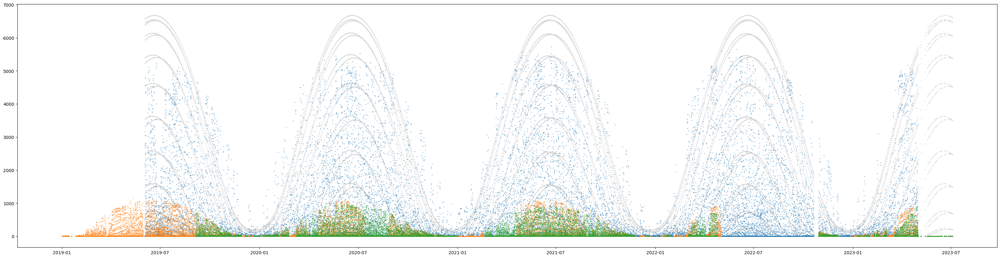

In [22]:
# Plot alignment and values
plt.figure(figsize=(40, 10))

plt.scatter(
    data_standard[data_standard.location == "A"].date_forecast,
    data_standard[data_standard.location == "A"]["clear_sky_rad:W"] * 8,
    s=1,
    color="lightgrey",
)

for loc in locations:
    plt.scatter(
        data_standard[data_standard.location == loc].date_forecast,
        data_standard[data_standard.location == loc]["pv_measurement"],
        s=1,
        alpha=0.5,
    )

In [23]:
data_simple.describe().T.drop(columns=["std", "25%", "50%", "75%"])

,count,mean,min,max
date_forecast,92117,2021-03-26 19:47:34.417751,2019-01-01 00:00:00,2023-07-03 23:00:00
absolute_humidity_2m:gm3,92117.0,6.00584,0.5,17.35
air_density_2m:kgm3,92117.0,1.255348,1.13925,1.441
ceiling_height_agl:m,75668.0,2880.849121,27.799999,12294.901367
clear_sky_energy_1h:J,92117.0,523999.90625,0.0,2990595.5
clear_sky_rad:W,92117.0,145.547226,0.0,835.650024
cloud_base_agl:m,85300.0,1740.147217,27.5,11673.625
dew_or_rime:idx,92117.0,0.007447,-1.0,1.0
dew_point_2m:K,92117.0,275.219177,247.425003,293.625
diffuse_rad:W,92117.0,39.95409,0.0,334.75


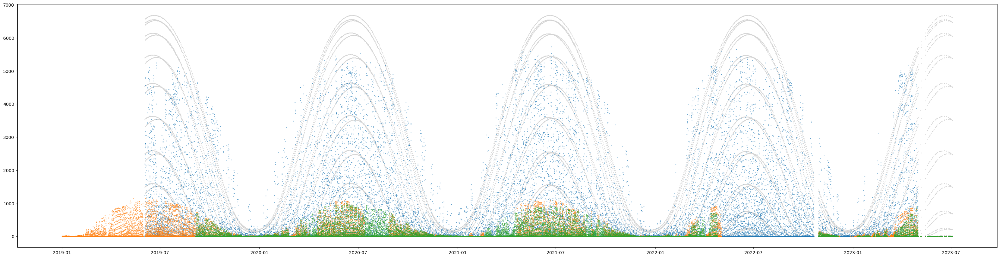

In [24]:
# Plot alignment and values
plt.figure(figsize=(40, 10))

plt.scatter(
    data_simple[data_simple.location == "A"].date_forecast,
    data_simple[data_simple.location == "A"]["clear_sky_rad:W"] * 8,
    s=1,
    color="lightgrey",
)

for loc in locations:
    plt.scatter(
        data_simple[data_simple.location == loc].date_forecast,
        data_simple[data_simple.location == loc]["pv_measurement"],
        s=1,
        alpha=0.5,
    )

# 4 – Modeling <a id='4'></a>

Each model returns is trained on a subset of the data. The models are then combined into a voting classifier. The voting classifier is then used to predict the test data.

We have created several different models, with different preprocessing and models itself. This enabled us to identify what worked the best, and also used a combination of models to improve accuracy.

Not all models provided below are actually used in the end.

The model used in the end were decided by the combined ensamble using the voting classifier as a meta model, then we weighted this ensamble model with the autogluon models and the neural network. Those weights were found manually by trial and error. 

#### Tools and Common Variables

In [25]:
plt.style.use('dark_background')

In [29]:
result = {}
test_result = {}
ensamble_holdout = {}

In [26]:
def scale_data(data, cols=None):
    if cols is None:
        ignore_cols = [
            "location",
            "dew_or_rime:idx",
            "is_day:idx",
            "is_in_shadow:idx",
            "pv_measurement",
            "data_type",
        ]

        cols = [col for col in data.columns if col not in ignore_cols]

    X_scaler = MinMaxScaler()
    X_scaler = X_scaler.fit(
        data[data["data_type"].isin(["observed", "estimated"])][cols]
    )
    y_scaler = MinMaxScaler()
    y_scaler = y_scaler.fit(
        data[data["data_type"].isin(["observed", "estimated"])][["pv_measurement"]]
    )

    data_copy = data.copy()

    data_copy[cols] = X_scaler.transform(data_copy[cols])
    data_copy[["pv_measurement"]] = y_scaler.transform(data[["pv_measurement"]])

    return data_copy, X_scaler, y_scaler

## 4.1 - LightGBM General Model <a id='41'></a>


### Feature Engineering and Selection


Feature that we chose to drop for this model were features the we thought included strange data

In [ ]:
data_general_lgb = data_simple.copy()

# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    # "hour",
    # "month",
    "month_sin",
    "hour_sin",
    "month_cos",
    "hour_cos",
    "date_calc",
    "sun_azimuth:d_sin",
    "sun_azimuth:d_cos",
    # "sun_azimuth:d",
    "date_forecast",
    "elevation:m",
    "precip_5min:mm",
    "precip_type_5min:idx",
    # "pressure_50m:hPa",
    "snow_drift:idx",
    "wind_speed_u_10m:ms",
    "wind_speed_v_10m:ms",
    "wind_speed_w_1000hPa:ms",
    # "total_cloud_cover:p",
    # "effective_cloud_cover:p"
    # "diffuse_rad:W",
]

weights_data = data_general_lgb[
    data_general_lgb.data_type.isin(
        ["observed", "estimated"]
    )
].copy()

weights = (
    np.where(
        weights_data.date_forecast > "2020-04",
        1,
        0,
    ),
)[0]

data_general_lgb = data_general_lgb.drop(drop_cols, axis=1)
data_general_lgb.columns = [
    column.replace(":", "_") for column in data_general_lgb.columns
]

ignore_cols = [
    "location",
    "is_day_idx",
    "is_in_shadow_idx",
    "pv_measurement",
    "data_type",
]

data_general_lgb["is_day_idx"] = data_general_lgb["is_day_idx"].astype("int")
data_general_lgb["is_in_shadow_idx"] = data_general_lgb["is_in_shadow_idx"].astype("int")
data_general_lgb["dew_or_rime_idx"] = data_general_lgb["dew_or_rime_idx"].astype("int")

cols = [col for col in data_general_lgb.columns if col not in ignore_cols]

data_general_lgb, _, y_scaler = scale_data(data_general_lgb, cols=cols)

# location one-hot

data_general_lgb = pd.get_dummies(data_general_lgb, columns=["location"])

# Create training and test data
test = data_general_lgb[data_general_lgb["data_type"].isin(["test"])].drop(columns=["data_type"]).copy()
train = data_general_lgb[data_general_lgb["data_type"].isin(["observed", "estimated"])].drop(columns=["data_type"]).copy()

### Model Setup


In [ ]:
best_params

{'objective': 'regression',
 'metric': 'l1',
 'verbosity': -1,
 'feature_pre_filter': False,
 'lambda_l1': 0.0,
 'lambda_l2': 0.0,
 'num_leaves': 80,
 'feature_fraction': 0.7,
 'bagging_fraction': 0.9988279316901496,
 'bagging_freq': 2,
 'min_child_samples': 20,
 'num_iterations': 1000,
 'early_stopping_round': None}

In [ ]:
# ---------------------------------------- LIGHTGBM ----------------------------------------

pv_measurement = train["pv_measurement"]

# Define the number of folds
n_splits = 10  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

model_params = {
    "metric": "MSE",
    "max_depth": 6,
    "num_rounds": 200,
    # "feature_fraction": 0.4724632038687269,
    "colsample_bytree": 0.6,
    "learning_rate": 0.04,
    "num_leaves": 140,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = lgb.LGBMRegressor(**model_params)

    # Fit the model
    model.fit(
        train_fold.drop(columns=["pv_measurement"]),
        pv_measurement_train,
        # sample_weight=weights[train_index]
    )

    # Get predictions for the validation set
    preds = model.predict(val_fold.drop(columns=["pv_measurement"]))

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test.drop(columns=["pv_measurement"]))

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = lgb.LGBMRegressor(**model_params)

# Fit the model
model.fit(train.drop(columns=["pv_measurement"]), pv_measurement)

# Get predictions for the validation set
preds = model.predict(test.drop(columns=["pv_measurement"]))

Fold 1/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 2/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 3/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 4/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 5/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 6/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 7/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 8/10
[LightGBM] [Warning] num_iterations is set=200, num_rounds=200 will be ignored. Current value: num_iterations=200
Fold 9/1

### Model Result


In [ ]:
result["general_lightgbm"] = all_preds.sort_index()[0]
test_result["general_lightgbm"] = pd.DataFrame(y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"])


## 4.2 - CatBoost General Model <a id='42'></a>

### Feature Engineering and Selection


In [ ]:
data_general_catboost_best_recreated = data_simple.copy()


# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d",
]
data_general_catboost_best_recreated = data_general_catboost_best_recreated.drop(
    drop_cols, axis=1
)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [
    col
    for col in data_general_catboost_best_recreated.columns
    if col not in ignore_cols
]

data_general_catboost_best_recreated, _, y_scaler = scale_data(
    data_general_catboost_best_recreated, cols=cols
)

# Create training and test data
train = (
    data_general_catboost_best_recreated[
        data_general_catboost_best_recreated["data_type"].isin(
            ["observed", "estimated"]
        )
    ]
    .drop(columns=["data_type"])
    .copy()
)
test = (
    data_general_catboost_best_recreated[
        data_general_catboost_best_recreated["data_type"] == "test"
    ]
    .drop(columns=["data_type"])
    .copy()
)
holdout = (
    data_general_catboost_best_recreated[
        data_general_catboost_best_recreated["data_type"] == "estimated"
    ]
    .drop(columns=["data_type"])
    .tail(24 * 3 * 10)
    .copy()
)

### Model Setup


In [ ]:
# ---------------------------------------- CATBOOST ----------------------------------------

cat_features = [0]
model = catboost.CatBoostRegressor(
    iterations=1000, depth=9, loss_function="MAE", cat_features=cat_features
)


pv_measurement = train["pv_measurement"]
train.drop("pv_measurement", axis=1, inplace=True)

# Define the number of folds
n_splits = 15  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

cat_features = [0]
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
    "cat_features": cat_features,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_fold, pv_measurement_train)

    # Get predictions for the validation set
    preds = model.predict(val_fold)

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_fold.index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test)

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = catboost.CatBoostRegressor(**model_params)

# Fit the model
model.fit(train, pv_measurement)

# Get predictions for the validation set
preds = model.predict(test)

Fold 1/15
0:	learn: 0.0504299	total: 60.3ms	remaining: 1m
1:	learn: 0.0492116	total: 101ms	remaining: 50.5s
2:	learn: 0.0481296	total: 144ms	remaining: 48s
3:	learn: 0.0470008	total: 194ms	remaining: 48.3s
4:	learn: 0.0458880	total: 238ms	remaining: 47.3s
5:	learn: 0.0447681	total: 283ms	remaining: 46.9s
6:	learn: 0.0438592	total: 322ms	remaining: 45.6s
7:	learn: 0.0429201	total: 364ms	remaining: 45.1s
8:	learn: 0.0419967	total: 407ms	remaining: 44.9s
9:	learn: 0.0412217	total: 445ms	remaining: 44s
10:	learn: 0.0402857	total: 491ms	remaining: 44.2s
11:	learn: 0.0393659	total: 529ms	remaining: 43.5s
12:	learn: 0.0385421	total: 570ms	remaining: 43.3s
13:	learn: 0.0377279	total: 613ms	remaining: 43.2s
14:	learn: 0.0368628	total: 671ms	remaining: 44.1s
15:	learn: 0.0360497	total: 730ms	remaining: 44.9s
16:	learn: 0.0352639	total: 793ms	remaining: 45.9s
17:	learn: 0.0345353	total: 833ms	remaining: 45.5s
18:	learn: 0.0337396	total: 874ms	remaining: 45.1s
19:	learn: 0.0329889	total: 914ms	rem

### Model Result


In [ ]:
result["general_catboost"] = all_preds.sort_index()[0]
test_result["general_catboost"] = pd.DataFrame(
    y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"]
)

## 4.3 - CatBoost Log Transform Model <a id='43'></a>



We observed that the distrubution of the target variable, pv_measurement, was very skewed. Therfore we created a catBoost model where we instead try to predic the log tranformation of pv_measurement.

### Feature Engineering and Selection


In [ ]:
data_general_catboost_transform = data_simple.copy()


# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    "clear_sky_rad:W",
    # "sun_azimuth:d",
]

data_general_catboost_transform["pv_measurement"] = np.log1p(
    data_general_catboost_transform["pv_measurement"]
)

data_general_catboost_transform = data_general_catboost_transform.drop(
    drop_cols, axis=1
)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [
    col for col in data_general_catboost_transform.columns if col not in ignore_cols
]

data_general_catboost_transform, _, y_scaler = scale_data(
    data_general_catboost_transform, cols=cols
)

# Create training and test data
train = (
    data_general_catboost_transform[
        data_general_catboost_transform["data_type"].isin(["observed", "estimated"])
    ]
    .drop(columns=["data_type"])
    .copy()
)
test = (
    data_general_catboost_transform[
        data_general_catboost_transform["data_type"] == "test"
    ]
    .drop(columns=["data_type"])
    .copy()
)

### Model Setup


In [ ]:
# ---------------------------------------- CATBOOST ----------------------------------------

cat_features = [0]
model = catboost.CatBoostRegressor(
    iterations=1000, depth=9, loss_function="MAE", cat_features=cat_features
)


pv_measurement = train["pv_measurement"]
train.drop("pv_measurement", axis=1, inplace=True)

# Define the number of folds
n_splits = 15  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

cat_features = [0]
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
    "cat_features": cat_features,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_fold, pv_measurement_train)

    # Get predictions for the validation set
    preds = model.predict(val_fold)

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_fold.index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test)

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = catboost.CatBoostRegressor(**model_params)


# Fit the model
model.fit(train, pv_measurement)

# Get predictions for the validation set
preds = model.predict(test)

Fold 1/15
0:	learn: 0.2616077	total: 65.8ms	remaining: 1m 5s
1:	learn: 0.2542675	total: 111ms	remaining: 55.5s
2:	learn: 0.2470464	total: 154ms	remaining: 51s
3:	learn: 0.2400524	total: 185ms	remaining: 46s
4:	learn: 0.2332152	total: 229ms	remaining: 45.7s
5:	learn: 0.2266069	total: 270ms	remaining: 44.7s
6:	learn: 0.2202205	total: 307ms	remaining: 43.5s
7:	learn: 0.2141080	total: 346ms	remaining: 42.8s
8:	learn: 0.2081290	total: 383ms	remaining: 42.2s
9:	learn: 0.2023706	total: 419ms	remaining: 41.5s
10:	learn: 0.1968357	total: 449ms	remaining: 40.4s
11:	learn: 0.1914026	total: 484ms	remaining: 39.8s
12:	learn: 0.1861382	total: 522ms	remaining: 39.6s
13:	learn: 0.1810181	total: 591ms	remaining: 41.6s
14:	learn: 0.1761081	total: 648ms	remaining: 42.5s
15:	learn: 0.1713303	total: 690ms	remaining: 42.4s
16:	learn: 0.1667226	total: 729ms	remaining: 42.2s
17:	learn: 0.1622215	total: 769ms	remaining: 41.9s
18:	learn: 0.1578397	total: 808ms	remaining: 41.7s
19:	learn: 0.1536094	total: 844ms	

### Model Result


In [ ]:
result["transform_catboost"] = np.expm1(all_preds.sort_index()[0])

test_result["transform_catboost"] = pd.DataFrame(
    y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"]
)
test_result["transform_catboost"]["pv_measurement"] = np.expm1(
    test_result["transform_catboost"].values
)

## 4.4 - Catboost Target Encoded Location Model <a id='44'></a>


To capture the potential differences in the different locations, we created a a catboost model with target endoded loaction

### Feature Engineering and Selection


In [ ]:
data_general_catboost_target_encoded = data_simple.copy()


# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    "clear_sky_rad:W",
    # "sun_azimuth:d",
]

data_general_catboost_target_encoded["pv_measurement"] = data_general_catboost_target_encoded["pv_measurement"]


mean_target = (
    data_general_catboost_target_encoded[
        data_general_catboost_target_encoded.data_type.isin(["observed", "estimated"])
    ]
    .groupby(["location", "month", "hour"])["pv_measurement"]
    .mean()
)

location_mapping = mean_target.to_dict()

data_general_catboost_target_encoded[
    "location_encoded"
] = data_general_catboost_target_encoded.apply(
    lambda x: location_mapping.get((x["location"], x["month"], x["hour"]), None), axis=1
)


data_general_catboost_target_encoded = data_general_catboost_target_encoded.drop(
    drop_cols, axis=1
)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [
    col for col in data_general_catboost_target_encoded.columns if col not in ignore_cols
]

data_general_catboost_target_encoded, _, y_scaler = scale_data(
    data_general_catboost_target_encoded, cols=cols
)

# Create training and test data
train = (
    data_general_catboost_target_encoded[
        data_general_catboost_target_encoded["data_type"].isin(["observed", "estimated"])
    ]
    .drop(columns=["data_type"])
    .copy()
)
test = (
    data_general_catboost_target_encoded[
        data_general_catboost_target_encoded["data_type"] == "test"
    ]
    .drop(columns=["data_type"])
    .copy()
)

### Model Setup


In [ ]:
# ---------------------------------------- CATBOOST ----------------------------------------

cat_features = [0]
model = catboost.CatBoostRegressor(
    iterations=1000, depth=9, loss_function="MAE", cat_features=cat_features
)


pv_measurement = train["pv_measurement"]
train.drop("pv_measurement", axis=1, inplace=True)

# Define the number of folds
n_splits = 15  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

cat_features = [0]
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
    "cat_features": cat_features,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_fold, pv_measurement_train)

    # Get predictions for the validation set
    preds = model.predict(val_fold)

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_fold.index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test)

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = catboost.CatBoostRegressor(**model_params)

# Fit the model
model.fit(train, pv_measurement)

# Get predictions for the validation set
preds = model.predict(test)

Fold 1/15
0:	learn: 0.0503099	total: 54.2ms	remaining: 54.2s
1:	learn: 0.0495138	total: 107ms	remaining: 53.6s
2:	learn: 0.0484727	total: 151ms	remaining: 50.3s
3:	learn: 0.0475477	total: 207ms	remaining: 51.6s
4:	learn: 0.0465700	total: 241ms	remaining: 48s
5:	learn: 0.0455818	total: 282ms	remaining: 46.7s
6:	learn: 0.0448517	total: 326ms	remaining: 46.3s
7:	learn: 0.0441983	total: 447ms	remaining: 55.5s
8:	learn: 0.0436427	total: 493ms	remaining: 54.2s
9:	learn: 0.0426639	total: 533ms	remaining: 52.8s
10:	learn: 0.0421836	total: 587ms	remaining: 52.8s
11:	learn: 0.0412435	total: 624ms	remaining: 51.4s
12:	learn: 0.0403026	total: 689ms	remaining: 52.3s
13:	learn: 0.0394046	total: 732ms	remaining: 51.5s
14:	learn: 0.0386003	total: 770ms	remaining: 50.6s
15:	learn: 0.0377831	total: 815ms	remaining: 50.1s
16:	learn: 0.0369689	total: 860ms	remaining: 49.7s
17:	learn: 0.0360988	total: 898ms	remaining: 49s
18:	learn: 0.0352781	total: 942ms	remaining: 48.7s
19:	learn: 0.0346611	total: 983ms	

### Model Result


In [ ]:
result["encoded_catboost"] = all_preds.sort_index()[0]

test_result["encoded_catboost"] = pd.DataFrame(
    y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"]
)
test_result["encoded_catboost"]["pv_measurement"] = test_result[
    "encoded_catboost"
].values

## 4.5 - CatBoost Estimated Sample Weight Model <a id='45'></a>


Since the the model is tested on estimated data, we created a model where we weighted estimated datapoint more that the observed data. 

### Feature Engineering and Selection


In [ ]:
data_general_catboost_weighted = data_simple.copy()


# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d",
]

weights_data = data_general_catboost_weighted[
    data_general_catboost_weighted.data_type.isin(["observed", "estimated"])
].copy()

weights = (
    np.where(
        weights_data.data_type.isin(["estimated"]),
        1.2,
        0.8,
    ),
)[0]

data_general_catboost_weighted = data_general_catboost_weighted.drop(drop_cols, axis=1)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [col for col in data_general_catboost_weighted.columns if col not in ignore_cols]


data_general_catboost_weighted, _, y_scaler = scale_data(
    data_general_catboost_weighted, cols=cols
)


# Create training and test data
train = (
    data_general_catboost_weighted[
        data_general_catboost_weighted["data_type"].isin(["observed", "estimated"])
    ]
    .drop(columns=["data_type"])
    .copy()
)

test = (
    data_general_catboost_weighted[
        data_general_catboost_weighted["data_type"] == "test"
    ]
    .drop(columns=["data_type"])
    .copy()
)

### Model Setup


In [ ]:
# ---------------------------------------- CATBOOST ----------------------------------------

cat_features = [0]
model = catboost.CatBoostRegressor(
    iterations=1000, depth=9, loss_function="MAE", cat_features=cat_features
)


pv_measurement = train["pv_measurement"]
train.drop("pv_measurement", axis=1, inplace=True)

# Define the number of folds
n_splits = 15  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

cat_features = [0]
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
    "cat_features": cat_features,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_fold, pv_measurement_train, sample_weight=weights[train_index])

    # Get predictions for the validation set
    preds = model.predict(val_fold)

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_fold.index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test)

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = catboost.CatBoostRegressor(**model_params)

# Fit the model
model.fit(train, pv_measurement, sample_weight=weights)

# Get predictions for the validation set
preds = model.predict(test)

Fold 1/15
0:	learn: 0.0491842	total: 40ms	remaining: 39.9s
1:	learn: 0.0479988	total: 76.9ms	remaining: 38.4s
2:	learn: 0.0469452	total: 112ms	remaining: 37.1s
3:	learn: 0.0458565	total: 151ms	remaining: 37.6s
4:	learn: 0.0447691	total: 207ms	remaining: 41.1s
5:	learn: 0.0436826	total: 258ms	remaining: 42.7s
6:	learn: 0.0427969	total: 307ms	remaining: 43.6s
7:	learn: 0.0419074	total: 348ms	remaining: 43.2s
8:	learn: 0.0411716	total: 389ms	remaining: 42.8s
9:	learn: 0.0404159	total: 423ms	remaining: 41.9s
10:	learn: 0.0395594	total: 459ms	remaining: 41.2s
11:	learn: 0.0387701	total: 492ms	remaining: 40.5s
12:	learn: 0.0379232	total: 528ms	remaining: 40.1s
13:	learn: 0.0370659	total: 564ms	remaining: 39.7s
14:	learn: 0.0362362	total: 598ms	remaining: 39.3s
15:	learn: 0.0353837	total: 635ms	remaining: 39s
16:	learn: 0.0349915	total: 676ms	remaining: 39.1s
17:	learn: 0.0342375	total: 713ms	remaining: 38.9s
18:	learn: 0.0334138	total: 747ms	remaining: 38.5s
19:	learn: 0.0326673	total: 780ms

KeyboardInterrupt: 

### Model Results


In [ ]:
result["weighted_catboost"] = all_preds.sort_index()[0]
test_result["weighted_catboost"] = pd.DataFrame(
    y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"]
)

## 4.6 - CatBoost Model Trained Per Location <a id='46'></a>


To capture the potential differences in locations we trained a cat boost model per location

In [ ]:
catboost_location = data_simple.copy()

# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d",
]

catboost_location = catboost_location.drop(drop_cols, axis=1)

# transform the target variable by subtracting direct radiation and diffuse radiation:
catboost_location["estimated"] = np.where(
    catboost_location.data_type.isin(["estimated", "test"]), 1, 0
)

# scaling the data
ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "data_type",
    "estimated"
]

cols = [col for col in catboost_location.columns if col not in ignore_cols]

# Create training and test data

train_all = catboost_location[catboost_location.data_type.isin(["observed", "estimated"])].drop(columns="data_type").copy()
test = catboost_location[catboost_location.data_type == "test"].drop(columns="data_type").copy()

In [ ]:
some_preds = {"A": [], "B": [], "C": []}

for location in ("A", "B", "C"):
    train = train_all[train_all.location == location].drop(columns="location").copy()

    # Define the number of folds
    n_splits = 10  # You can change this as needed

    # Create a KFold splitter
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

    model_params = {
        "iterations": 1000,
        "depth": 9,
        "loss_function": "MAE",
        "cat_features": ["estimated"],
    }

    # Initialize lists to store the predictions
    all_preds = pd.DataFrame()
    temp_test_result = []

    # Loop through the K-fold splits
    for i, (train_index, val_index) in enumerate(kf.split(train)):
        print(f"Fold {i + 1}/{n_splits}")
        # Split the data into training and validation sets
        train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]

        train_pool = catboost.Pool(data=train_fold.drop(columns="pv_measurement"), label=train_fold["pv_measurement"], cat_features=["estimated"])
        eval_pool = catboost.Pool(data=val_fold.drop(columns="pv_measurement"), label=val_fold["pv_measurement"], cat_features=["estimated"])

        # Create a CatBoostRegressor instance for this fold
        model = catboost.CatBoostRegressor(**model_params)

        # Fit the model
        model.fit(train_pool, eval_set=eval_pool)

        # Get predictions for the validation set
        preds = model.predict(eval_pool)

        # Invert scaling for the validation set predictions
        prediction_df_scaled = pd.DataFrame(preds, columns=["prediction"], index=val_index)
        prediction_df_scaled["location"] = location

        # Append the predictions to the list
        some_preds[location].append(prediction_df_scaled)


Fold 1/10
0:	learn: 618.5568902	test: 626.7799373	best: 626.7799373 (0)	total: 36.1ms	remaining: 36s
1:	learn: 603.7379883	test: 611.8333732	best: 611.8333732 (1)	total: 50.9ms	remaining: 25.4s
2:	learn: 592.6707267	test: 600.6419287	best: 600.6419287 (2)	total: 65.6ms	remaining: 21.8s
3:	learn: 578.8284813	test: 586.5590442	best: 586.5590442 (3)	total: 78.4ms	remaining: 19.5s
4:	learn: 564.6731419	test: 572.5944189	best: 572.5944189 (4)	total: 91.6ms	remaining: 18.2s
5:	learn: 550.9060223	test: 558.6319416	best: 558.6319416 (5)	total: 105ms	remaining: 17.3s
6:	learn: 536.6568576	test: 544.6326262	best: 544.6326262 (6)	total: 119ms	remaining: 16.8s
7:	learn: 524.6854386	test: 532.6263915	best: 532.6263915 (7)	total: 132ms	remaining: 16.4s
8:	learn: 512.4567203	test: 520.5016739	best: 520.5016739 (8)	total: 147ms	remaining: 16.2s
9:	learn: 501.4189478	test: 509.7434904	best: 509.7434904 (9)	total: 163ms	remaining: 16.1s
10:	learn: 489.6557733	test: 498.2943609	best: 498.2943609 (10)	tot

In [ ]:
preds_A = pd.concat(some_preds["A"]).sort_index()
preds_A.index = data_catboost[(data_catboost.location == "A") & (data_catboost.data_type.isin(["observed", "estimated"]))].index
preds_B = pd.concat(some_preds["B"]).sort_index()
preds_B.index = data_catboost[(data_catboost.location == "B") & (data_catboost.data_type.isin(["observed", "estimated"]))].index
preds_C = pd.concat(some_preds["C"]).sort_index()
preds_C.index = data_catboost[(data_catboost.location == "C") & (data_catboost.data_type.isin(["observed", "estimated"]))].index

preds = pd.concat([preds_A, preds_B, preds_C]).sort_index()

result["location_catboost"] = preds

In [ ]:
result["location_catboost"]

,prediction,location
0,-0.002365,B
1,-0.000073,B
2,0.000510,B
3,0.000071,B
4,0.000477,B
...,...,...
89952,0.004835,B
89953,-0.002220,C
89954,-0.002282,A
89955,-0.002549,B


In [ ]:
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
}

final_preds = []

for location in ("A", "B", "C"):
    train = train_all[train_all.location == location].drop(columns=["location"])

    train_pool = catboost.Pool(data=train.drop(columns="pv_measurement"), label=train["pv_measurement"], cat_features=["estimated"])
    test_pool = catboost.Pool(data=test[test.location == location].drop(columns=["pv_measurement", "location"]), cat_features=["estimated"])

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_pool)

    # Get predictions for the validation set
    preds = model.predict(test_pool)

    # Invert scaling for the validation set predictions
    prediction_df = pd.DataFrame(preds, columns=["prediction"], index=test[test.location == location].index)
    prediction_df["location"] = location

    # Append the predictions to the list
    final_preds.append(prediction_df)

0:	learn: 617.8542205	total: 80.5ms	remaining: 1m 20s
1:	learn: 602.8193471	total: 113ms	remaining: 56.2s
2:	learn: 586.3497599	total: 131ms	remaining: 43.6s
3:	learn: 571.8191094	total: 150ms	remaining: 37.4s
4:	learn: 557.4874244	total: 167ms	remaining: 33.2s
5:	learn: 542.5456171	total: 184ms	remaining: 30.5s
6:	learn: 528.9717176	total: 203ms	remaining: 28.8s
7:	learn: 517.1656109	total: 221ms	remaining: 27.4s
8:	learn: 504.5169656	total: 245ms	remaining: 27s
9:	learn: 492.0604426	total: 260ms	remaining: 25.8s
10:	learn: 480.7409914	total: 277ms	remaining: 24.9s
11:	learn: 471.2208976	total: 294ms	remaining: 24.2s
12:	learn: 460.6402044	total: 321ms	remaining: 24.4s
13:	learn: 450.4970730	total: 339ms	remaining: 23.9s
14:	learn: 440.2376915	total: 356ms	remaining: 23.4s
15:	learn: 431.0857328	total: 372ms	remaining: 22.9s
16:	learn: 421.6657491	total: 387ms	remaining: 22.4s
17:	learn: 412.6751215	total: 405ms	remaining: 22.1s
18:	learn: 403.5101517	total: 420ms	remaining: 21.7s
19:

In [ ]:
test_result["location_catboost"] = pd.concat(final_preds).reset_index().sort_values(["location", "index"]).drop(columns="index")


## 4.7 - Neural Network Model <a id='47'></a>


We tried to test a lot off different models to see what predicts pv_measurement the best. Neural networks i known for the ability to detect complex nonlinear relationships betwen the depentant and independat varaibles and other interactions between predictior varaibles. 

### Feature Engineering and Selection

In [ ]:
data_neural = data_standard.copy()

# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d_cos",/
    # "sun_azimuth:d_sin",
    "elevation:m",
    "fresh_snow_12h:cm",
    # "direct_rad:W",
    # "diffuse_rad:W",
    # "month_sin",
    # "hour_sin",
    "year",
    "day",
    # "diffuse_rad:W",
    # "direct_rad:W",
    "global_rad"
]

# Target transformation
data_neural["pv_measurement"] = data_neural["pv_measurement"]

data_neural["global_rad"] = data_neural["direct_rad:W"] + data_neural["diffuse_rad:W"]
# data_neural["hours_since_rain"] = (
#     data_neural["precip_5min:mm"].rolling(12).sum().shift(-12) / 12
# )


data_neural["year"] = data_neural["date_forecast"].dt.year
data_neural["day"] = data_neural["date_forecast"].dt.dayofyear

data_neural["global_rad_-1"] = (
    data_neural.groupby(["location", "year", "day"])["global_rad"].shift(-1).fillna(0)
)

data_neural["precip_5min:mm-2"] = (
    data_neural.groupby(["location", "year", "day"])["precip_5min:mm"]
    .shift(-2)
    .fillna(0)
)
data_neural["rain_water:kgm2-2"] = (
    data_neural.groupby(["location", "year", "day"])["rain_water:kgm2"]
    .shift(-2)
    .fillna(0)
)
data_neural["precip_5min:mm-2"] = (
    data_neural.groupby(["location", "year", "day"])["precip_5min:mm"]
    .shift(-2)
    .fillna(0)
)

# Agregations

data_neural["total_clouds_rolling_3"] = (
    data_neural.groupby(["location", "year", "day"])["total_cloud_cover:p"]
    .rolling(3)
    .mean()
    .fillna(0)
    .reset_index()["total_cloud_cover:p"]
)
data_neural["precip_5min_rolling_3"] = (
    data_neural.groupby(["location", "year", "day"])["precip_5min:mm"]
    .rolling(3)
    .mean()
    .fillna(0)
    .reset_index()["precip_5min:mm"]
)

# avg rainfall per month calculated from estimated/observed
sum_rainfall = (
    data_neural.loc[data_neural["data_type"].isin(["observed", "estimated"])]
    .groupby("month")["precip_5min:mm"]
    .sum()
    .reset_index()
    .rename(columns={"precip_5min:mm": "sum_rainfall"})
)

data_neural = data_neural.merge(sum_rainfall, on="month", how="left")

# avg tmp per month calculated from estimated/observed
sum_wind = (
    data_neural.loc[data_neural["data_type"].isin(["observed", "estimated"])]
    .groupby("month")["wind_speed_10m:ms"]
    .sum()
    .reset_index()
    .rename(columns={"wind_speed_10m:ms": "sum_wind"})
)


data_neural = data_neural.merge(sum_wind, on="month", how="left")

median_wind_hourly = (
    data_neural.loc[data_neural["data_type"].isin(["observed", "estimated"])]
    .groupby(["month", "hour"])["wind_speed_10m:ms"]
    .median()
    .reset_index()
    .rename(columns={"wind_speed_10m:ms": "median_wind_hourly"})
)

data_neural = data_neural.merge(median_wind_hourly, on=["month", "hour"], how="left")

data_neural["estimated"] = np.where(
    data_neural.data_type.isin(["estimated", "test"]), 1, 0
)


# Target encode month and hour
# mean_target = (
#     data_neural[
#         data_neural.data_type.isin(["observed", "estimated"])
#     ].groupby(["month"])["pv_measurement"].mean()
# )

# location_mapping = mean_target.to_dict()

# data_neural["month_encoded"] = data_neural.apply(
#     lambda x: location_mapping.get((x["month"]), None), axis=1
# )

data_neural = data_neural.drop(drop_cols, axis=1)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
    "precip_type_5min:idx",
]

cols = [col for col in data_neural.columns if col not in ignore_cols]

# data_neural, _, y_scaler = scale_data(data_neural, cols=cols)

# Create training and test data

# train, val = train_test_split(
#     data_neural[data_neural["data_type"].isin(["observed", "estimated"])].drop(columns=["data_type"]).copy(),
#     test_size=0.02,
#     random_state=42,
#     shuffle=False,
# )
train_df = (
    data_neural[data_neural["data_type"].isin(["observed", "estimated"])]
    .copy()
    .drop(columns=["data_type"])
)
test_df = (
    data_neural[data_neural["data_type"] == "test"].copy().drop(columns=["data_type"])
)

# Rename data_type test to estimated in test_df
# test_df.loc[:, "data_type"] = "estimated"

In [ ]:
# from fastai.tabular.all import *
# from fastai.tabular import *
import fastai

In [ ]:
class PermutationImportance:
    "Calculate and plot the permutation importance"

    def __init__(self, learn: Learner, df=None, bs=None):
        "Initialize with a test dataframe, a learner, and a metric"
        self.learn = learn
        self.df = df
        bs = bs if bs is not None else learn.dls.bs
        if self.df is not None:
            self.dl = learn.dls.test_dl(self.df, bs=bs)
        else:
            self.dl = learn.dls[1]
        self.x_names = learn.dls.x_names.filter(lambda x: "_na" not in x)
        self.na = learn.dls.x_names.filter(lambda x: "_na" in x)
        self.y = dls.y_names
        self.results = self.calc_feat_importance()

    def get_results(self):
        return self.ord_dic_to_df(self.results)

    def measure_col(self, name: str):
        "Measures change after column shuffle"
        col = [name]
        if f"{name}_na" in self.na:
            col.append(name)
        orig = self.dl.items[col].values
        perm = np.random.permutation(len(orig))
        self.dl.items[col] = self.dl.items[col].values[perm]
        metric = learn.validate(dl=self.dl)[1]
        self.dl.items[col] = orig
        return metric

    def calc_feat_importance(self):
        "Calculates permutation importance by shuffling a column on a percentage scale"
        print("Getting base error")
        base_error = self.learn.validate(dl=self.dl)[1]
        self.importance = {}
        pbar = progress_bar(self.x_names)
        print("Calculating Permutation Importance")
        for col in pbar:
            self.importance[col] = self.measure_col(col)
        for key, value in self.importance.items():
            self.importance[key] = (
                base_error - value
            ) / base_error  # this can be adjusted
        return OrderedDict(
            sorted(self.importance.items(), key=lambda kv: kv[1], reverse=True)
        )

    def ord_dic_to_df(self, dict: OrderedDict):
        return pd.DataFrame(
            [[k, v] for k, v in dict.items()], columns=["feature", "importance"]
        )

    def plot_importance(self, df: pd.DataFrame, limit=20, asc=False, **kwargs):
        "Plot importance with an optional limit to how many variables shown"
        df_copy = df.copy()
        df_copy["feature"] = df_copy["feature"].str.slice(0, 25)
        df_copy = df_copy.sort_values(by="importance", ascending=asc).sort_values(
            by="importance", ascending=not (asc)
        )

        return df_copy

In [ ]:
to.conts.columns

Index(['absolute_humidity_2m:gm3', 'dew_point_2m:K', 'effective_cloud_cover:p',
       'fresh_snow_1h:cm', 'fresh_snow_24h:cm', 'fresh_snow_3h:cm',
       'msl_pressure:hPa', 'precip_5min:mm', 'precip_type_5min:idx',
       'pressure_100m:hPa', 'pressure_50m:hPa', 'prob_rime:p',
       'rain_water:kgm2', 'sfc_pressure:hPa', 'snow_depth:cm',
       'snow_drift:idx', 'snow_melt_10min:mm', 'snow_water:kgm2',
       't_1000hPa:K', 'total_cloud_cover:p', 'wind_speed_u_10m:ms',
       'wind_speed_v_10m:ms', 'wind_speed_w_1000hPa:ms', 'hour_sin',
       'hour_cos', 'month_sin', 'month_cos', 'sun_azimuth:d_sin',
       'sun_azimuth:d_cos', 'global_rad_-1', 'precip_5min:mm-2',
       'rain_water:kgm2-2', 'total_clouds_rolling_3', 'sum_rainfall',
       'sum_wind', 'median_wind_hourly'],
      dtype='object')

In [ ]:
train_df[train_df.location == location].drop(
            columns=["location"]).columns

Index(['absolute_humidity_2m:gm3', 'air_density_2m:kgm3',
       'clear_sky_energy_1h:J', 'clear_sky_rad:W', 'dew_or_rime:idx',
       'dew_point_2m:K', 'diffuse_rad:W', 'diffuse_rad_1h:J', 'direct_rad:W',
       'direct_rad_1h:J', 'effective_cloud_cover:p', 'fresh_snow_1h:cm',
       'fresh_snow_24h:cm', 'fresh_snow_3h:cm', 'fresh_snow_6h:cm',
       'is_day:idx', 'is_in_shadow:idx', 'msl_pressure:hPa', 'precip_5min:mm',
       'precip_type_5min:idx', 'pressure_100m:hPa', 'pressure_50m:hPa',
       'prob_rime:p', 'rain_water:kgm2', 'relative_humidity_1000hPa:p',
       'sfc_pressure:hPa', 'snow_depth:cm', 'snow_drift:idx',
       'snow_melt_10min:mm', 'snow_water:kgm2', 'sun_azimuth:d',
       'sun_elevation:d', 'super_cooled_liquid_water:kgm2', 't_1000hPa:K',
       'total_cloud_cover:p', 'visibility:m', 'wind_speed_10m:ms',
       'wind_speed_u_10m:ms', 'wind_speed_v_10m:ms', 'wind_speed_w_1000hPa:ms',
       'pv_measurement', 'hour_sin', 'hour_cos', 'month_sin', 'month_cos',
      

In [ ]:
location

'A'

epoch,train_loss,valid_loss,None,time
0,431.078888,352.861908,352.861908,00:07
1,263.782410,286.414154,286.414154,00:07
2,291.541992,273.234100,273.234100,00:07
3,250.830566,209.443680,209.443680,00:07
4,242.909134,231.599579,231.599579,00:07
5,226.702896,216.361420,216.361420,00:07
6,220.507797,206.313873,206.313873,00:07
7,210.354904,199.654617,199.654617,00:07
8,216.979706,197.684860,197.684860,00:07
9,208.646133,208.581192,208.581192,00:07


epoch,train_loss,valid_loss,None,time
0,74.507828,52.331680,52.331680,00:06
1,43.344658,38.085808,38.085808,00:06
2,41.596649,43.448162,43.448162,00:05
3,40.989159,48.519341,48.519341,00:05
4,37.458553,36.555950,36.555950,00:05
5,36.134880,32.162189,32.162189,00:05
6,34.755009,30.962809,30.962809,00:05
7,33.319000,30.986189,30.986189,00:05
8,32.566883,27.244938,27.244938,00:05
9,32.122856,27.453341,27.453341,00:05


epoch,train_loss,valid_loss,None,time
0,87.210999,56.049461,56.049461,00:05
1,47.819260,32.585659,32.585659,00:04
2,41.531914,40.308212,40.308212,00:04
3,36.961594,37.303364,37.303364,00:04
4,35.329376,56.485195,56.485195,00:04
5,34.288021,37.567635,37.567635,00:04
6,34.482414,32.318672,32.318672,00:05
7,33.381985,29.162266,29.162266,00:04
8,29.595154,33.946491,33.946491,00:04
9,29.997309,29.084082,29.084082,00:04


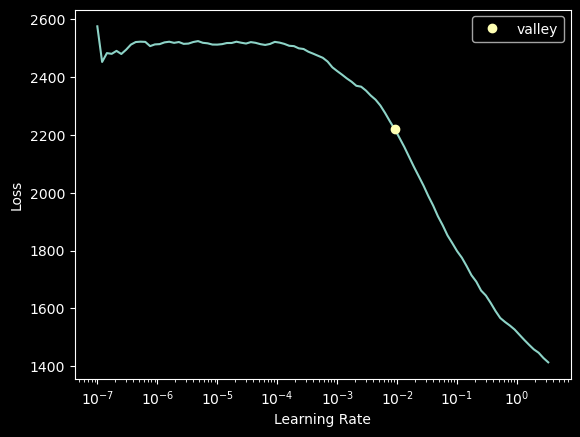

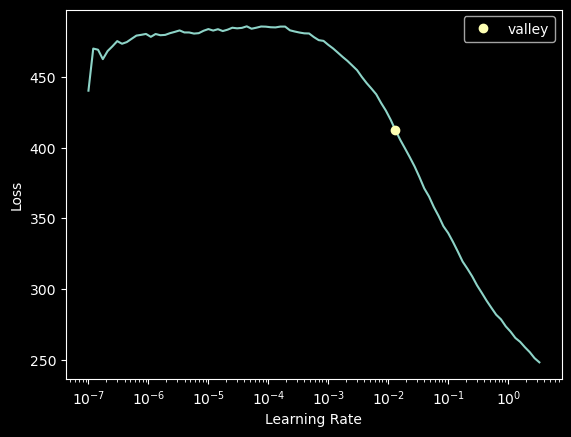

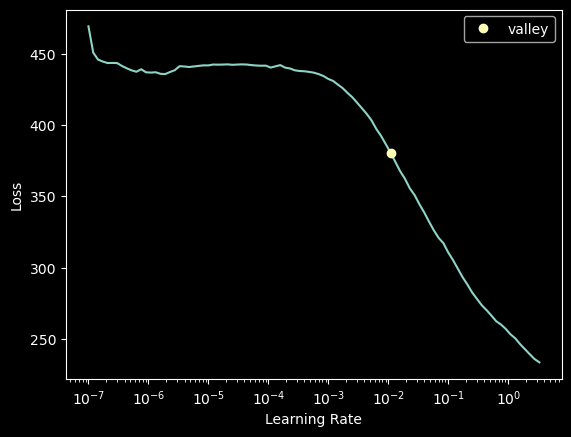

In [ ]:
# Assuming you have a DataFrame named 'df' containing your data
dep_var = "pv_measurement"
cat_names = [
    "estimated",
    # "dew_or_rime:idx",
    # "precip_type_5min:idx",
]  # List of categorical variable names if any
cont_names = [
    col for col in train_df.columns if col not in cat_names + [dep_var, "location"]
]

procs = [
    fastai.tabular.all.Categorify,
    fastai.tabular.all.FillMissing,
    fastai.tabular.all.Normalize,
]  # Data preprocessing steps

all_preds = pd.DataFrame(columns=["prediction"])

importances = {"A": None, "B": None, "C": None}

for location in ("A", "B", "C"):
    fastai.tabular.all.set_seed(42)

    splits = RandomSplitter(seed=42)(
        train_df[train_df.location == location].copy().drop(
            columns=["location"]
            + list(
                autogluon_importance[location][
                    autogluon_importance[location].p_value > 0.99
                ].index
            ),
            errors="ignore",
        )
    )

    to = fastai.tabular.all.TabularPandas(
        train_df.copy()[train_df.location == location].drop(
            columns=["location"]
            + list(
                autogluon_importance[location][
                    autogluon_importance[location].p_value > 0.99
                ].index
            ),
            errors="ignore",
        ),
        procs=procs,
        cat_names=cat_names,
        cont_names=[
            col
            for col in train_df.columns
            if col
            not in cat_names
            + [dep_var, "location"]
            + list(
                autogluon_importance[location][
                    autogluon_importance[location].p_value > 0.99
                ].index
            )
        ],
        y_names=dep_var,
        splits=splits,
        y_block=fastai.tabular.all.RegressionBlock(),
    )

    dls = to.dataloaders(bs=128, seed=42)

    config = tabular_config(ps=0.2)
    # layers=[512, 256, 128, 62],
    learn = fastai.tabular.all.tabular_learner(
        dls,
        # config=config,
        metrics=[fastai.losses.L1LossFlat()],
        loss_func=fastai.losses.L1LossFlat(),
        # layers=[512, 256, 128, 62],
        y_range=(0, train_df[train_df.location == location].pv_measurement.max()),
    )

    lr = learn.lr_find()

    learn.fit_one_cycle(20, lr)

    # importance = None

    # with io.capture_output() as captured:
    #     importance = PermutationImportance(
    #         learn, test_df[test_df.location == location], bs=256
    #     ).get_results()

    # importances[location] = importance

    # importance = PermutationImportance(learn, train_df[train_df.location == location].iloc[:1000], bs=64)
    # display(importance)

    tst_dl = learn.dls.test_dl(
        test_df[test_df.location == location].copy().drop(
            columns=["location"]
            + list(
                autogluon_importance[location][
                    autogluon_importance[location].p_value > 0.99
                ].index
            ),
            errors="ignore",
        )
    )
    preds, _ = learn.get_preds(dl=tst_dl)

    all_preds = pd.concat(
        [all_preds, pd.DataFrame(preds.numpy(), columns=["prediction"])]
    )

In [ ]:
test_result["neural_net"] = all_preds

In [ ]:
learn.layers

Sequential(
  (0): LinBnDrop(
    (0): Linear(in_features=39, out_features=512, bias=False)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
  )
  (1): LinBnDrop(
    (0): Linear(in_features=512, out_features=256, bias=False)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
  )
  (2): LinBnDrop(
    (0): Linear(in_features=256, out_features=128, bias=False)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
  )
  (3): LinBnDrop(
    (0): Linear(in_features=128, out_features=62, bias=False)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(62, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
  )
  (4): LinBnDrop(
    (

In [ ]:
display(importances["A"])
display(importances["B"])
display(importances["C"])

,feature,importance
0,hour_cos,0.134148
1,global_rad_-1,0.066802
2,clear_sky_rad:W,0.044258
3,precip_5min:mm,0.014783
4,rain_water:kgm2-2,0.010798
5,visibility:m,0.010409
6,rain_water:kgm2,0.010082
7,wind_speed_v_10m:ms,0.008887
8,wind_speed_u_10m:ms,0.006248
9,snow_water:kgm2,0.005295


,feature,importance
0,global_rad_-1,0.125727
1,sun_elevation:d,0.089537
2,clear_sky_rad:W,0.047808
3,clear_sky_energy_1h:J,0.041086
4,hour_cos,0.020333
5,precip_5min:mm,0.013592
6,snow_water:kgm2,0.012647
7,rain_water:kgm2,0.011218
8,median_wind_hourly,0.011150
9,wind_speed_v_10m:ms,0.009399


,feature,importance
0,global_rad_-1,0.127390
1,clear_sky_energy_1h:J,0.111956
2,sun_elevation:d,0.052523
3,visibility:m,0.013039
4,median_wind_hourly,0.011561
5,rain_water:kgm2-2,0.009946
6,relative_humidity_1000hPa:p,0.008080
7,precip_5min:mm,0.007914
8,wind_speed_v_10m:ms,0.007498
9,rain_water:kgm2,0.007093


## 4.8 - XGBoost Model <a id='48'></a>



XGBoost is one of the first models we tried, because it is a powerfull gradient boosting model commonly used. However, we found out that on its own, XGboost was outperformed by catboost. Catboost was a much better gradient boosting model for this problem.

We used XGBoost initially to try to see what features was considered important by using the feature importance plot.

### Feature Engineering and Selection


In [27]:
data_general_XGBoost = data_standard.copy()

# one hot encoding the location feature
one_hot = pd.get_dummies(data_general_XGBoost["location"]).astype(int)
data_general_XGBoost = data_general_XGBoost.drop("location", axis=1)
data_general_XGBoost = pd.merge(
    data_general_XGBoost, one_hot, left_index=True, right_index=True
)

# Drop columns that are not needed
drop_cols = [
    # "cloud_base_agl:m",
    # "ceiling_height_agl:m",
    # "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    "sun_azimuth:d",
]
data_general_XGBoost = data_general_XGBoost.drop(drop_cols, axis=1)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [col for col in data_general_XGBoost.columns if col not in ignore_cols]

data_general_XGBoost, _, y_scaler = scale_data(data_general_XGBoost, cols=cols)

# Create training and test data
train = (
    data_general_XGBoost[
        data_general_XGBoost["data_type"].isin(["observed", "estimated"])
    ]
    .drop(columns=["data_type"])
    .copy()
)
test = (
    data_general_XGBoost[data_general_XGBoost["data_type"] == "test"]
    .drop(columns=["data_type"])
    .copy()
)

c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtyp

### Model Setup


In [32]:
# ---------------------------- XGBOOST ----------------------------


# Create XGBoost model
model = xgb.XGBRegressor(
    max_depth=7,
    colsample_bytree=0.8,
    eta=0.1,
    n_estimators=90,
    reg_alpha=0.01,
    reg_lambda=0.01,
)


# Define the number of folds for cross-validation and whether to shuffle the data
n_folds = 5
shuffle = True

# Create the cross-validation object
kFold = KFold(n_splits=n_folds, shuffle=shuffle, random_state=42)

result["general_XGBoost"] = pd.DataFrame()

temp_test_result = []
temp_test_indices = []

# Perform k-fold cross-validation
for train_index, validation_index in kFold.split(train):
    print(f"Train Index: {train_index}, Validation Index: {validation_index}")

    fold_train, fold_validation = train.iloc[train_index], train.iloc[validation_index]

    # Fit the XGBoost model on the training data
    model.fit(
        fold_train.drop("pv_measurement", axis=1),
        fold_train["pv_measurement"],
        verbose=False,
        eval_metric="mae",
    )

    # Make predictions on the validation data
    predictions = y_scaler.inverse_transform(
        model.predict(fold_validation.drop("pv_measurement", axis=1)).reshape(-1, 1)
    )

    # # Make predictions on the validation data
    # predictions = y_scaler.inverse_transform(
    #     model.predict(pool_validation).reshape(-1, 1)
    # )

    result["general_XGBoost"] = pd.concat(
        [result["general_XGBoost"], pd.DataFrame(predictions, index=validation_index)],
        axis=0,
    )

    # Make prediction on the test data
    temp_test_result.append(
        y_scaler.inverse_transform(model.predict(test.drop("pv_measurement", axis=1)).reshape(-1, 1))
    )


test_result["general_XGBoost"] = pd.DataFrame(
    np.mean(temp_test_result, axis=0), index=test.index
)
result["general_XGBoost"] = result["general_XGBoost"].sort_index()

Train Index: [    0     1     2 ... 83042 83043 83044], Validation Index: [   24    35    39 ... 83032 83033 83041]


c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  return is_int or is_bool or is_float or is_categorica

c:\Users\siver\azure\venv913\lib\site-packages\xgboost\sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\a

Train Index: [    0     1     2 ... 83042 83043 83044], Validation Index: [    4     6     7 ... 83020 83034 83038]


c:\Users\siver\azure\venv913\lib\site-packages\xgboost\sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\a

Train Index: [    2     4     5 ... 83041 83043 83044], Validation Index: [    0     1     3 ... 83019 83035 83042]


c:\Users\siver\azure\venv913\lib\site-packages\xgboost\sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\a

Train Index: [    0     1     2 ... 83040 83041 83042], Validation Index: [    8    14    16 ... 83039 83043 83044]


c:\Users\siver\azure\venv913\lib\site-packages\xgboost\sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\a

Train Index: [    0     1     3 ... 83042 83043 83044], Validation Index: [    2     5    15 ... 83031 83036 83040]


c:\Users\siver\azure\venv913\lib\site-packages\xgboost\sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\siver\azure\venv913\lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\siver\a

### Model Result


In [33]:
mean_absolute_error(
    result["general_XGBoost"][0].sort_index(), train["pv_measurement"].sort_index()
)

c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_e

317.4722176853896

### Feature Importance

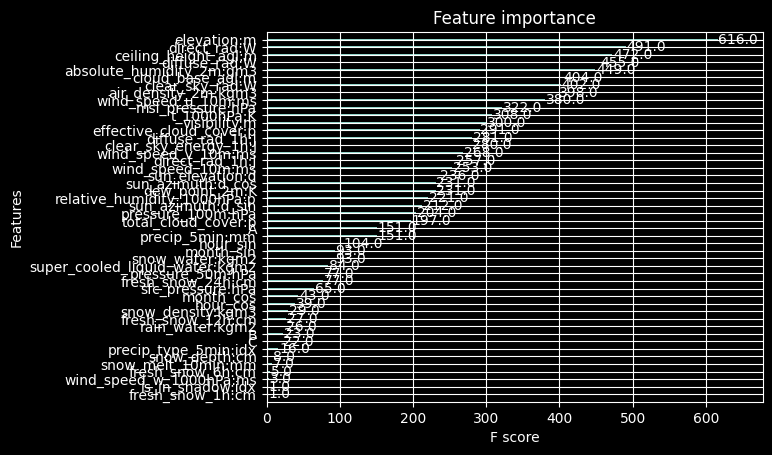

In [34]:
xgb.plot_importance(model)
plt.show()

## 4.9 - Catboost Summer Weighted Model <a id='49'></a>


Since the model is tested on primarly summer months, in other words the test data is mostly summer months, we created acatboost model where summer month datapoints is weighted more that other months. This was to try to create a model that was better to be able to predict summer months. 

### Feature Engineering and Selection


In [ ]:
data_catboost_summer = data_simple.copy()


# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "hour",
    "month",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d",
]

weights_data = data_catboost_summer[
    data_catboost_summer.data_type.isin(["observed", "estimated"])
].copy()

# creating weights for the summer months
weights = (
    np.where(
        weights_data.date_forecast.dt.month.isin([6, 7, 8]),
        1.2,
        0.8,
    ),
)[0]


data_catboost_summer = data_catboost_summer.drop(drop_cols, axis=1)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [col for col in data_catboost_summer.columns if col not in ignore_cols]


data_catboost_summer, _, y_scaler = scale_data(data_catboost_summer, cols=cols)


# Create training and test data
train = (
    data_catboost_summer[
        data_catboost_summer["data_type"].isin(["observed", "estimated"])
    ]
    .drop(columns=["data_type"])
    .copy()
)

test = (
    data_catboost_summer[data_catboost_summer["data_type"] == "test"]
    .drop(columns=["data_type"])
    .copy()
)

In [ ]:
# ---------------------------------------- CATBOOST ----------------------------------------

cat_features = [0]
model = catboost.CatBoostRegressor(
    iterations=1000, depth=9, loss_function="MAE", cat_features=cat_features
)


pv_measurement = train["pv_measurement"]
train.drop("pv_measurement", axis=1, inplace=True)

# Define the number of folds
n_splits = 15  # You can change this as needed

# Create a KFold splitter
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

cat_features = [0]
model_params = {
    "iterations": 1000,
    "depth": 9,
    "loss_function": "MAE",
    "cat_features": cat_features,
}

# Initialize lists to store the predictions
all_preds = pd.DataFrame()
temp_test_result = []

# Loop through the K-fold splits
for i, (train_index, val_index) in enumerate(kf.split(train)):
    print(f"Fold {i + 1}/{n_splits}")
    # Split the data into training and validation sets
    train_fold, val_fold = train.iloc[train_index], train.iloc[val_index]
    pv_measurement_train, pv_measurement_val = (
        pv_measurement.iloc[train_index],
        pv_measurement.iloc[val_index],
    )

    # Create a CatBoostRegressor instance for this fold
    model = catboost.CatBoostRegressor(**model_params)

    # Fit the model
    model.fit(train_fold, pv_measurement_train, sample_weight=weights[train_index])

    # Get predictions for the validation set
    preds = model.predict(val_fold)

    # Invert scaling for the validation set predictions
    prediction_scaled = y_scaler.inverse_transform(preds.reshape(-1, 1))
    prediction_df_scaled = pd.DataFrame(prediction_scaled, index=val_fold.index)

    # Append the predictions to the list
    all_preds = pd.concat([all_preds, prediction_df_scaled], axis=0)

    # Get predictions for the test set
    preds_test = model.predict(test)

    # Invert scaling for the test set predictions
    prediction_scaled_test = y_scaler.inverse_transform(preds_test.reshape(-1, 1))
    prediction_df_scaled_test = pd.DataFrame(prediction_scaled_test)

    # Append the predictions to the list
    temp_test_result.append(prediction_df_scaled_test)

# For final predictions
# Create a CatBoostRegressor instance for this fold
model = catboost.CatBoostRegressor(**model_params)

# Fit the model
model.fit(train, pv_measurement, sample_weight=weights)

# Get predictions for the validation set
preds = model.predict(test)

Fold 1/15
0:	learn: 0.0563817	total: 44.5ms	remaining: 44.5s
1:	learn: 0.0551673	total: 133ms	remaining: 1m 6s
2:	learn: 0.0539623	total: 175ms	remaining: 58s
3:	learn: 0.0526901	total: 213ms	remaining: 53.1s
4:	learn: 0.0515951	total: 250ms	remaining: 49.7s
5:	learn: 0.0503990	total: 289ms	remaining: 47.8s
6:	learn: 0.0493980	total: 329ms	remaining: 46.7s
7:	learn: 0.0483046	total: 372ms	remaining: 46.1s
8:	learn: 0.0472509	total: 419ms	remaining: 46.2s
9:	learn: 0.0463695	total: 456ms	remaining: 45.2s
10:	learn: 0.0452893	total: 506ms	remaining: 45.5s
11:	learn: 0.0442412	total: 544ms	remaining: 44.8s
12:	learn: 0.0432516	total: 585ms	remaining: 44.4s
13:	learn: 0.0423147	total: 629ms	remaining: 44.3s
14:	learn: 0.0413280	total: 660ms	remaining: 43.4s
15:	learn: 0.0403290	total: 694ms	remaining: 42.7s
16:	learn: 0.0398723	total: 733ms	remaining: 42.4s
17:	learn: 0.0390003	total: 774ms	remaining: 42.2s
18:	learn: 0.0380661	total: 811ms	remaining: 41.9s
19:	learn: 0.0375865	total: 852m

### Model Result


In [ ]:
result["summer_catboost"] = all_preds.sort_index()[0]
test_result["summer_catboost"] = pd.DataFrame(
    y_scaler.inverse_transform(preds.reshape(-1, 1)), columns=["pv_measurement"]
)

## 4.10 - H20 AutoML New Model <a id='410'></a>



H20 was the first auto ML model we tested. It gave us a indications that gradint boosting models was the best models for this problem, as it always returned gradient boosting models as the best. 

### Feature engineering


In [ ]:
data_h2o = data_standard.copy()

# Drop columns that are not needed
drop_cols = [
    "cloud_base_agl:m",
    "ceiling_height_agl:m",
    "snow_density:kgm3",
    "elevation:m",
    "precip_5min:mm",
    "precip_type_5min:idx",
    "pressure_50m:hPa",
    "snow_drift:idx",
    "wind_speed_u_10m:ms",
    "wind_speed_v_10m:ms",
    "wind_speed_w_1000hPa:ms",
    "hour_sin",
    "hour_cos",
    "month_sin",
    "month_cos",
    "date_calc",
    "date_forecast",
    # "sun_azimuth:d",
]

data_h2o = data_h2o.drop(drop_cols, axis=1)

ignore_cols = [
    "location",
    "dew_or_rime:idx",
    "is_day:idx",
    "is_in_shadow:idx",
    "pv_measurement",
    "data_type",
]

cols = [col for col in data_h2o.columns if col not in ignore_cols]

data_h2o, _, h2o_scaler_pv = scale_data(data_h2o, cols=cols)

# Create training and test data
train = (
    data_h2o[data_h2o["data_type"].isin(["observed", "estimated"])]
    .copy()
    .drop(columns=["data_type"])
)
test = data_h2o[data_h2o["data_type"].isin(["test"])].copy().drop(columns=["data_type"])

train = train.reset_index().drop(columns="index")

### Setup Model


In [ ]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "17.0.1" 2021-10-19; OpenJDK Runtime Environment Temurin-17.0.1+12 (build 17.0.1+12); OpenJDK 64-Bit Server VM Temurin-17.0.1+12 (build 17.0.1+12, mixed mode)
  Starting server from /Users/mathiasraa/anaconda3/envs/forecasting/lib/python3.10/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /var/folders/xd/z_ptq9v136q7kj9lf2f4sblh0000gn/T/tmpp_mk6bg2
  JVM stdout: /var/folders/xd/z_ptq9v136q7kj9lf2f4sblh0000gn/T/tmpp_mk6bg2/h2o_mathiasraa_started_from_python.out
  JVM stderr: /var/folders/xd/z_ptq9v136q7kj9lf2f4sblh0000gn/T/tmpp_mk6bg2/h2o_mathiasraa_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Europe/Oslo
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.42.0.4
H2O_cluster_version_age:,26 days
H2O_cluster_name:,H2O_from_python_mathiasraa_cojdxt
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,4 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [ ]:
h2o.cluster().shutdown()

#### Location A


In [ ]:
h2o_train = h2o.H2OFrame(train[train.location == "A"].drop(columns="location"))

h2o_model_A = h2o.automl.H2OAutoML(
    max_models=20,
    seed=1,
    stopping_metric="MAE",
    sort_metric="MAE",
    stopping_tolerance=0.01,
)

h2o_model_A.train(x=h2o_train.columns, y="pv_measurement", training_frame=h2o_train)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
16:46:37.119: AutoML: XGBoost is not available; skipping it.

███████████████ (cancelled)


H2OJobCancelled: Job<$03017f00000132d4ffffffff$_9be8604e43dc516481eccfb20aa0420a> was cancelled by the user.

In [ ]:
model_path_A = h2o.save_model(model=h2o_model_A.leader, path="../models/", force=True)
print(model_path_A)

/Users/mathiasraa/Desktop/ntnu/tdt4173-forecasting/models/StackedEnsemble_AllModels_1_AutoML_1_20231029_150422


#### Location B


In [ ]:
h2o_train = h2o.H2OFrame(train[train.location == "B"].drop(columns="location"))

h2o_model_B = h2o.automl.H2OAutoML(
    max_models=20,
    seed=1,  #### Location A
    stopping_metric="MAE",
    sort_metric="MAE",
    stopping_tolerance=0.01,
)

h2o_model_B.train(x=h2o_train.columns, y="pv_measurement", training_frame=h2o_train)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
15:33:29.581: AutoML: XGBoost is not available; skipping it.
15:33:29.584: _train param, Dropping bad and constant columns: [elevation:m]


15:33:30.642: _train param, Dropping bad and constant columns: [elevation:m]

█████
15:33:41.636: _train param, Dropping bad and constant columns: [elevation:m]

███
15:34:18.926: _train param, Dropping bad and constant columns: [elevation:m]


15:34:25.343: _train param, Dropping bad and constant columns: [elevation:m]

██
15:34:32.422: _train param, Dropping bad and constant columns: [elevation:m]

██
15:34:41.532: _train param, Dropping bad and constant columns: [elevation:m]

███
15:35:30.69: _train param, Dropping bad and constant columns: [elevation:m]

█
15:35:35.508: _train param, Dropping bad and constant columns: [elevation:m]

██████████████████████████████████████████████
15:57:01.33: _train param, Dropping unused columns: [

key,value
Stacking strategy,cross_validation
Number of base models (used / total),16/20
# GBM base models (used / total),9/10
# DRF base models (used / total),2/2
# DeepLearning base models (used / total),5/7
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [ ]:
model_path_B = h2o.save_model(model=h2o_model_B.leader, path="../models/", force=True)
print(model_path_B)

/Users/mathiasraa/Desktop/ntnu/tdt4173-forecasting/models/StackedEnsemble_AllModels_1_AutoML_2_20231029_153329


#### Location C


In [ ]:
h2o_train = h2o.H2OFrame(train[train.location == "C"].drop(columns="location"))

h2o_model_C = h2o.automl.H2OAutoML(
    max_models=20,
    seed=1,
    stopping_metric="MAE",
    sort_metric="MAE",
    stopping_tolerance=0.01,
)

h2o_model_C.train(x=h2o_train.columns, y="pv_measurement", training_frame=h2o_train)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
16:00:47.629: AutoML: XGBoost is not available; skipping it.
16:00:47.631: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]


16:00:48.379: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█████
16:00:59.847: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

███
16:01:24.568: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
16:01:32.353: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
16:01:41.985: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

██
16:01:52.285: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

███
16:02:25.492: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]


16:02:32.260: _train param, Dropping bad and const

key,value
Stacking strategy,cross_validation
Number of base models (used / total),14/20
# GBM base models (used / total),8/10
# DRF base models (used / total),2/2
# DeepLearning base models (used / total),4/7
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [ ]:
model_path_C = h2o.save_model(model=h2o_model_C.leader, path="../models/", force=True)
print(model_path_C)

/Users/mathiasraa/Desktop/ntnu/tdt4173-forecasting/models/StackedEnsemble_AllModels_1_AutoML_3_20231029_160047


### Results


In [ ]:
h2o_test_A = h2o.H2OFrame(test[test.location == "A"].drop(columns="location"))
h2o_test_B = h2o.H2OFrame(test[test.location == "B"].drop(columns="location"))
h2o_test_C = h2o.H2OFrame(test[test.location == "C"].drop(columns="location"))


preds_A = h2o_model_A.predict(h2o_test_A)
preds_B = h2o_model_B.predict(h2o_test_B)
preds_C = h2o_model_C.predict(h2o_test_C)

preds_A = preds_A.as_data_frame().values
preds_B = preds_B.as_data_frame().values
preds_C = preds_C.as_data_frame().values

preds_A = y_scaler.inverse_transform(preds_A)
preds_B = y_scaler.inverse_transform(preds_B)
preds_C = y_scaler.inverse_transform(preds_C)

preds_A = pd.DataFrame(preds_A)
preds_B = pd.DataFrame(preds_B)
preds_C = pd.DataFrame(preds_C)

preds_A.index = test[test.location == "A"].index
preds_B.index = test[test.location == "B"].index
preds_C.index = test[test.location == "C"].index

preds_A.columns = ["pv_measurement"]
preds_B.columns = ["pv_measurement"]
preds_C.columns = ["pv_measurement"]

test_result["h2o_automl"] = pd.concat([preds_A, preds_B, preds_C], axis=0)

Parse progress: |

████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


In [ ]:
test_result["h2o_automl"]

,pv_measurement
83045,-3.321232
83048,-3.316869
83051,-3.099552
83054,66.634761
83057,336.762729
...,...
85192,48.588012
85195,15.956512
85198,1.963414
85201,1.401137


In [ ]:
prediction_df = preds.as_data_frame()
h2o.cluster().shutdown()
prediction_df_scaled = h2o_scaler_pv.inverse_transform(prediction_df)
prediction_df_scaled_df = pd.DataFrame(prediction_df_scaled)


# removing negative values and replacing with 0

resultframe = pd.DataFrame(columns=["id", "prediction"])
resultframe["prediction"] = prediction_df_scaled_df
resultframe["prediction"] = np.where(
    resultframe["prediction"] < 0, 0, resultframe["prediction"]
)
resultframe["id"] = range(len(resultframe))

In [ ]:
prediction_df.head(50)

In [ ]:
test

In [ ]:
new = resultframe.copy()
new["location"] = test["location"].reset_index(drop=True)

new.sort_values(by=["location", "id"]).head(50)


## 4.11 - H2O AutoML Old Model <a id='411'></a>


#### Preproccssing

Including the old preprocessing for the H2O model, as it is quite different then for the models above!


In [ ]:
# Loading all sets
# A
y_a = pd.read_parquet("../data/A/train_targets.parquet")
X_test_estimated_a = pd.read_parquet("../data/A/X_test_estimated.parquet")
X_train_estimated_a = pd.read_parquet("../data/A/X_train_estimated.parquet")
X_train_observed_a = pd.read_parquet("../data/A/X_train_observed.parquet")

# B
y_b = pd.read_parquet("../data/B/train_targets.parquet")
X_test_estimated_b = pd.read_parquet("../data/B/X_test_estimated.parquet")
X_train_estimated_b = pd.read_parquet("../data/B/X_train_estimated.parquet")
X_train_observed_b = pd.read_parquet("../data/B/X_train_observed.parquet")

# C
y_c = pd.read_parquet("../data/C/train_targets.parquet")
X_test_estimated_c = pd.read_parquet("../data/C/X_test_estimated.parquet")
X_train_estimated_c = pd.read_parquet("../data/C/X_train_estimated.parquet")
X_train_observed_c = pd.read_parquet("../data/C/X_train_observed.parquet")

In [ ]:
# removing duplicate entries if anyone exists
# Function that removes the duplicates if it finds duplicates in the specified coloumn
def remove_duplicates_in_coloumn(df, col):
    duplicate_mask = df[col].duplicated(keep="first")
    if duplicate_mask.any():
        df = df[~duplicate_mask]
    return df


# A
y_a = remove_duplicates_in_coloumn(y_a, "time")
X_test_estimated_a = remove_duplicates_in_coloumn(X_test_estimated_a, "date_forecast")
X_train_estimated_a = remove_duplicates_in_coloumn(X_train_estimated_a, "date_forecast")
X_train_observed_a = remove_duplicates_in_coloumn(X_train_observed_a, "date_forecast")

# B
y_b = remove_duplicates_in_coloumn(y_b, "time")
X_test_estimated_b = remove_duplicates_in_coloumn(X_test_estimated_b, "date_forecast")
X_train_estimated_b = remove_duplicates_in_coloumn(X_train_estimated_b, "date_forecast")
X_train_observed_b = remove_duplicates_in_coloumn(X_train_observed_b, "date_forecast")

# C
y_c = remove_duplicates_in_coloumn(y_c, "time")
X_test_estimated_c = remove_duplicates_in_coloumn(X_test_estimated_c, "date_forecast")
X_train_estimated_c = remove_duplicates_in_coloumn(X_train_estimated_c, "date_forecast")
X_train_observed_c = remove_duplicates_in_coloumn(X_train_observed_c, "date_forecast")

In [ ]:
# list of all estimated and observed sets

list_of_all_estimated_and_observed_sets = [
    X_test_estimated_a,
    X_train_estimated_a,
    X_train_observed_a,
    X_test_estimated_b,
    X_train_estimated_b,
    X_train_observed_b,
    X_test_estimated_c,
    X_train_estimated_c,
    X_train_observed_c,
]

# dropping coloumns

for set in list_of_all_estimated_and_observed_sets:
    # set.drop("snow_density:kgm3", axis=1, inplace=True)
    # these 2 had a lot of NaN values
    set.drop("ceiling_height_agl:m", axis=1, inplace=True)
    set.drop(
        "cloud_base_agl:m", axis=1, inplace=True
    )  # could potentially not drop this, but set all nan values to 0
    set.drop("snow_density:kgm3", axis=1, inplace=True)
    set.drop("elevation:m", axis=1, inplace=True)
    set.drop("precip_5min:mm", axis=1, inplace=True)
    set.drop("precip_type_5min:idx", axis=1, inplace=True)
    set.drop("pressure_50m:hPa", axis=1, inplace=True)
    set.drop("snow_drift:idx", axis=1, inplace=True)
    set.drop("wind_speed_u_10m:ms", axis=1, inplace=True)
    set.drop("wind_speed_v_10m:ms", axis=1, inplace=True)
    set.drop("wind_speed_w_1000hPa:ms", axis=1, inplace=True)

#### Feature engineering


In [ ]:
# converting sun azimuth to degreee feature
def convert_from_degree_to_ciruclar(df, feature):
    df[feature + "_sin"] = np.sin(np.radians(df[feature]))
    df[feature + "_cos"] = np.cos(np.radians(df[feature]))
    df = df.drop(feature, axis=1)
    return df


X_train_estimated_a = convert_from_degree_to_ciruclar(
    X_train_estimated_a, "sun_azimuth:d"
)
X_train_observed_a = convert_from_degree_to_ciruclar(
    X_train_observed_a, "sun_azimuth:d"
)
X_test_estimated_a = convert_from_degree_to_ciruclar(
    X_test_estimated_a, "sun_azimuth:d"
)
X_train_estimated_b = convert_from_degree_to_ciruclar(
    X_train_estimated_b, "sun_azimuth:d"
)
X_train_observed_b = convert_from_degree_to_ciruclar(
    X_train_observed_b, "sun_azimuth:d"
)
X_test_estimated_b = convert_from_degree_to_ciruclar(
    X_test_estimated_b, "sun_azimuth:d"
)
X_train_estimated_c = convert_from_degree_to_ciruclar(
    X_train_estimated_c, "sun_azimuth:d"
)
X_train_observed_c = convert_from_degree_to_ciruclar(
    X_train_observed_c, "sun_azimuth:d"
)
X_test_estimated_c = convert_from_degree_to_ciruclar(
    X_test_estimated_c, "sun_azimuth:d"
)

In [ ]:
# removing date_calc from all estimated sets
X_test_estimated_a.drop("date_calc", axis=1, inplace=True)
X_train_estimated_a.drop("date_calc", axis=1, inplace=True)
X_test_estimated_b.drop("date_calc", axis=1, inplace=True)
X_train_estimated_b.drop("date_calc", axis=1, inplace=True)
X_test_estimated_c.drop("date_calc", axis=1, inplace=True)
X_train_estimated_c.drop("date_calc", axis=1, inplace=True)

In [ ]:
# converting every quarters into a whole hour by SUM
def convert_df_into_hourly(df):
    df.set_index("date_forecast", inplace=True)
    df = df.resample("1H").sum()
    df.reset_index(inplace=True)
    return df


X_train_estimated_a = convert_df_into_hourly(X_train_estimated_a)
X_train_observed_a = convert_df_into_hourly(X_train_observed_a)
X_test_estimated_a = convert_df_into_hourly(X_test_estimated_a)
X_train_estimated_b = convert_df_into_hourly(X_train_estimated_b)
X_train_observed_b = convert_df_into_hourly(X_train_observed_b)
X_test_estimated_b = convert_df_into_hourly(X_test_estimated_b)
X_train_estimated_c = convert_df_into_hourly(X_train_estimated_c)
X_train_observed_c = convert_df_into_hourly(X_train_observed_c)
X_test_estimated_c = convert_df_into_hourly(X_test_estimated_c)

#### Cleaning y


In [ ]:
# Function that returns train_targets, observed and estimated sets left after filtering away NaN
def drop_nan_rows_in_target_and_train(y_df, observed_train_df, estimated_train_df):
    y_df = y_df.dropna(subset=["pv_measurement"])
    valid_dates = y_df["time"]
    observed_train_df = observed_train_df[
        observed_train_df["date_forecast"].isin(valid_dates)
    ]
    estimated_train_df = estimated_train_df[
        estimated_train_df["date_forecast"].isin(valid_dates)
    ]
    return (y_df, observed_train_df, estimated_train_df)


# doing the NaN filtering
y_a, X_train_observed_a, X_train_estimated_a = drop_nan_rows_in_target_and_train(
    y_a, X_train_observed_a, X_train_estimated_a
)
y_b, X_train_observed_b, X_train_estimated_b = drop_nan_rows_in_target_and_train(
    y_b, X_train_observed_b, X_train_estimated_b
)
y_c, X_train_observed_c, X_train_estimated_c = drop_nan_rows_in_target_and_train(
    y_c, X_train_observed_c, X_train_estimated_c
)

#### Making time features


In [ ]:
# Function that creates timefeatures based on the specified coloumn
def create_time_features_based_on_coloun(df, col):
    df["hour"] = df[col].dt.hour
    df["dayofmonth"] = df[col].dt.day
    df["dayofweek"] = df[col].dt.dayofweek
    df["quarter"] = df[col].dt.quarter
    df["month"] = df[col].dt.month
    df["year"] = df[col].dt.year
    df["dayofyear"] = df[col].dt.dayofyear
    return df


# adding time features

# A
X_train_estimated_a = create_time_features_based_on_coloun(
    X_train_estimated_a, "date_forecast"
)
X_train_observed_a = create_time_features_based_on_coloun(
    X_train_observed_a, "date_forecast"
)
X_test_estimated_a = create_time_features_based_on_coloun(
    X_test_estimated_a, "date_forecast"
)

# B
X_train_estimated_b = create_time_features_based_on_coloun(
    X_train_estimated_b, "date_forecast"
)
X_train_observed_b = create_time_features_based_on_coloun(
    X_train_observed_b, "date_forecast"
)
X_test_estimated_b = create_time_features_based_on_coloun(
    X_test_estimated_b, "date_forecast"
)

# C
X_train_estimated_c = create_time_features_based_on_coloun(
    X_train_estimated_c, "date_forecast"
)
X_train_observed_c = create_time_features_based_on_coloun(
    X_train_observed_c, "date_forecast"
)
X_test_estimated_c = create_time_features_based_on_coloun(
    X_test_estimated_c, "date_forecast"
)

#### Removing a row in B


In [ ]:
date_times_estimated = X_train_estimated_b["date_forecast"]
date_times_observed = X_train_observed_b["date_forecast"]
result_df = y_b[
    ~y_b["time"].isin(date_times_estimated) & ~y_b["time"].isin(date_times_observed)
]
# removing row
y_b = y_b[~y_b["time"].isin(result_df["time"])]

#### Splitting sets


In [ ]:
# Making training and validation data for A
percent_observed_train_a = 1
percent_estimated_train_a = 1

split_index_obs_a = int(len(X_train_observed_a) * percent_observed_train_a)
X_train_observed_a_first_75 = X_train_observed_a[:split_index_obs_a]
X_train_observed_a_last_25 = X_train_observed_a[split_index_obs_a:]

split_index_est_a = int(len(X_train_estimated_a) * percent_estimated_train_a)
X_train_estimated_a_first_75 = X_train_estimated_a[:split_index_est_a]
X_train_estimated_a_last_25 = X_train_estimated_a[split_index_est_a:]

X_train_a = pd.concat([X_train_observed_a_first_75, X_train_estimated_a_first_75])
y_train_a = y_a[y_a["time"].isin(X_train_a["date_forecast"])]
print(X_train_a.shape, y_train_a.shape)

X_validate_a = pd.concat([X_train_observed_a_last_25, X_train_estimated_a_last_25])
y_validate_a = y_a[y_a["time"].isin(X_validate_a["date_forecast"])]


# making training and validation for B
percent_observed_train_b = 1
percent_estimated_train_b = 1

split_index_obs_b = int(len(X_train_observed_b) * percent_observed_train_b)
X_train_observed_b_first_75 = X_train_observed_b[:split_index_obs_b]
X_train_observed_b_last_25 = X_train_observed_b[split_index_obs_b:]


split_index_est_b = int(len(X_train_estimated_b) * percent_estimated_train_b)
X_train_estimated_b_first_75 = X_train_estimated_b[:split_index_est_b]
X_train_estimated_b_last_25 = X_train_estimated_b[split_index_est_b:]

X_train_b = pd.concat([X_train_observed_b_first_75, X_train_estimated_b_first_75])
y_train_b = y_b[y_b["time"].isin(X_train_b["date_forecast"])]
print(X_train_b.shape, y_train_b.shape)

X_validate_b = pd.concat([X_train_observed_b_last_25, X_train_estimated_b_last_25])
y_validate_b = y_b[y_b["time"].isin(X_validate_b["date_forecast"])]

# making training and validation for C
percent_observed_train_c = 1
percent_estimated_train_c = 1

split_index_obs_c = int(len(X_train_observed_c) * percent_observed_train_c)
X_train_observed_c_first_75 = X_train_observed_c[:split_index_obs_c]
X_train_observed_c_last_25 = X_train_observed_c[split_index_obs_c:]

split_index_est_c = int(len(X_train_estimated_c) * percent_estimated_train_c)
X_train_estimated_c_first_75 = X_train_estimated_c[:split_index_est_c]
X_train_estimated_c_last_25 = X_train_estimated_c[split_index_est_c:]

X_train_c = pd.concat([X_train_observed_c_first_75, X_train_estimated_c_first_75])
y_train_c = y_c[y_c["time"].isin(X_train_c["date_forecast"])]
print(X_train_c.shape, y_train_c.shape)

X_validate_c = pd.concat([X_train_observed_c_last_25, X_train_estimated_c_last_25])
y_validate_c = y_c[y_c["time"].isin(X_validate_c["date_forecast"])]

(34085, 43) (34085, 2)
(32843, 43) (32843, 2)
(26095, 43) (26095, 2)


#### Removing repeated indices


In [ ]:
def find_repeated_indexes(df, column_name, repeat_count=12):
    """
    Find and return the indexes of rows with a specified number of repeated values in a given column.

    Parameters:
    - df: DataFrame to search for repeated rows.
    - column_name: Name of the column to check for repeated values.
    - repeat_count: Number of repeated values required to consider a row as a match.

    Returns:
    - List of indexes for rows with the specified number of repeated values in the given column.
    """
    df = df.reset_index()
    repeated_indexes = []
    temp_repeated_indexes = []
    current_value = None
    count = 0

    for index, row in df.iterrows():
        value = row[column_name]

        if value == current_value:
            count += 1
            temp_repeated_indexes.append(index)
        else:
            current_value = value
            if count <= repeat_count:
                temp_repeated_indexes = []
                count = 1
            else:
                for i in temp_repeated_indexes:
                    if i not in repeated_indexes:
                        repeated_indexes.append(i)
                temp_repeated_indexes = []
                count = 1

    return repeated_indexes


# A
print(X_train_a.shape, y_train_a.shape)
repeated_indices = find_repeated_indexes(y_train_a, "pv_measurement", 24)
y_train_a = y_train_a.reset_index()
y_train_a = y_train_a.drop(repeated_indices)
X_train_a = X_train_a[X_train_a["date_forecast"].isin(y_train_a["time"])]
print(X_train_a.shape, y_train_a.shape)

repeated_indices = find_repeated_indexes(y_validate_a, "pv_measurement", 22)
y_validate_a = y_validate_a.reset_index()
y_validate_a = y_validate_a.drop(repeated_indices)
X_validate_a = X_validate_a[X_validate_a["date_forecast"].isin(y_validate_a["time"])]

y_train_a.reset_index(drop=True, inplace=True)
X_train_a.reset_index(drop=True, inplace=True)
y_validate_a.reset_index(drop=True, inplace=True)
X_validate_a.reset_index(drop=True, inplace=True)

# B  -  works reeaaaly well for B
print(X_train_b.shape, y_train_b.shape)
repeated_indices = find_repeated_indexes(y_train_b, "pv_measurement", 24)
y_train_b = y_train_b.reset_index()
y_train_b = y_train_b.drop(repeated_indices)
X_train_b = X_train_b[X_train_b["date_forecast"].isin(y_train_b["time"])]
print(X_train_b.shape, y_train_b.shape)

repeated_indices = find_repeated_indexes(y_validate_b, "pv_measurement", 24)
y_validate_b = y_validate_b.reset_index()
y_validate_b = y_validate_b.drop(repeated_indices)
X_validate_b = X_validate_b[X_validate_b["date_forecast"].isin(y_validate_b["time"])]

y_train_b.reset_index(drop=True, inplace=True)
X_train_b.reset_index(drop=True, inplace=True)
y_validate_b.reset_index(drop=True, inplace=True)
X_validate_b.reset_index(drop=True, inplace=True)
# C
print(X_train_c.shape, y_train_c.shape)
repeated_indices = find_repeated_indexes(y_train_c, "pv_measurement", 24)
y_train_c = y_train_c.reset_index()
y_train_c = y_train_c.drop(repeated_indices)
X_train_c = X_train_c[X_train_c["date_forecast"].isin(y_train_c["time"])]
print(X_train_c.shape, y_train_c.shape)

repeated_indices = find_repeated_indexes(y_validate_c, "pv_measurement", 24)
y_validate_c = y_validate_c.reset_index()
y_validate_c = y_validate_c.drop(repeated_indices)
X_validate_c = X_validate_c[X_validate_c["date_forecast"].isin(y_validate_c["time"])]

y_train_c.reset_index(drop=True, inplace=True)
X_train_c.reset_index(drop=True, inplace=True)
y_validate_c.reset_index(drop=True, inplace=True)
X_validate_c.reset_index(drop=True, inplace=True)

(34085, 43) (34085, 2)
(34043, 43) (34043, 3)
(32843, 43) (32843, 2)
(25954, 43) (25954, 3)
(26095, 43) (26095, 2)
(21169, 43) (21169, 3)


#### Removing time feature and adding location


In [ ]:
X_train_a.drop("date_forecast", axis=1, inplace=True)
y_train_a.drop("time", axis=1, inplace=True)
X_validate_a.drop("date_forecast", axis=1, inplace=True)
y_validate_a.drop("time", axis=1, inplace=True)

X_train_b.drop("date_forecast", axis=1, inplace=True)
y_train_b.drop("time", axis=1, inplace=True)
X_validate_b.drop("date_forecast", axis=1, inplace=True)
y_validate_b.drop("time", axis=1, inplace=True)

X_train_c.drop("date_forecast", axis=1, inplace=True)
y_train_c.drop("time", axis=1, inplace=True)
X_validate_c.drop("date_forecast", axis=1, inplace=True)
y_validate_c.drop("time", axis=1, inplace=True)

X_train_a["location"] = "A"
y_train_a["location"] = "A"
X_validate_a["location"] = "A"
y_validate_a["location"] = "A"

X_train_b["location"] = "B"
y_train_b["location"] = "B"
X_validate_b["location"] = "B"
y_validate_b["location"] = "B"

X_train_c["location"] = "C"
y_train_c["location"] = "C"
X_validate_c["location"] = "C"
y_validate_c["location"] = "C"

#### Merging data and fixing test


In [ ]:
X_train = pd.concat([X_train_a, X_train_b, X_train_c])
y_train = pd.concat([y_train_a, y_train_b, y_train_c])

X_validate = pd.concat([X_validate_a, X_validate_b, X_validate_c])
y_validate = pd.concat([y_validate_a, y_validate_b, y_validate_c])

dir_path = os.getcwd()


def load_valid_dates():
    test = pd.read_csv(f"{dir_path}/../data/test.csv")

    return test["time"].unique().tolist()


# adding location feature

X_test_estimated_a["location"] = "A"
X_test_estimated_b["location"] = "B"
X_test_estimated_c["location"] = "C"

# concatting:
X_test = pd.concat([X_test_estimated_a, X_test_estimated_b, X_test_estimated_c])
# filtering out invalid dates:
X_test = X_test[X_test["date_forecast"].isin(load_valid_dates())]
# removing forecast coloum
X_test = X_test.drop("date_forecast", axis=1)

One-hot


In [ ]:
X_train = X_train.reset_index().drop(columns="index")
one_hot = pd.get_dummies(X_train["location"]).astype(int)
X_train = X_train.drop("location", axis=1)
X_train = pd.merge(X_train, one_hot, left_index=True, right_index=True)

X_validate = X_validate.reset_index().drop(columns="index")
one_hot = pd.get_dummies(X_validate["location"]).astype(int)
X_validate = X_validate.drop("location", axis=1)
X_validate = pd.merge(X_validate, one_hot, left_index=True, right_index=True)

X_test = X_test.reset_index().drop(columns="index")
one_hot = pd.get_dummies(X_test["location"]).astype(int)
X_test = X_test.drop("location", axis=1)
X_test = pd.merge(X_test, one_hot, left_index=True, right_index=True)

Normalizing


In [ ]:
columns_to_exclude = ["A", "B", "C", "dew_or_rime:idx", "is_day:idx", "_in_shadow:idx"]

columns_to_normalize = [col for col in X_train.columns if col not in columns_to_exclude]


# Min-max
# Calculate min and max values for scaling
X_min = X_train[columns_to_normalize].min()
X_max = X_train[columns_to_normalize].max()

# Apply min-max scaling to the columns to be normalized
X_train[columns_to_normalize] = (X_train[columns_to_normalize] - X_min) / (
    X_max - X_min
)
X_validate[columns_to_normalize] = (X_validate[columns_to_normalize] - X_min) / (
    X_max - X_min
)
X_test[columns_to_normalize] = (X_test[columns_to_normalize] - X_min) / (X_max - X_min)

y_scaler = MinMaxScaler()


y_train["pv_measurement"] = y_scaler.fit_transform(
    y_train["pv_measurement"].values.reshape(-1, 1)
)

#### Model setup


In [ ]:
h2o.init()

X_train = X_train.reset_index().drop(columns="index")
y_train = y_train.reset_index().drop(columns="index")
new_train = pd.merge(
    X_train, y_train["pv_measurement"], left_index=True, right_index=True
)

h2o_train = h2o.H2OFrame(new_train)
h2o_test = h2o.H2OFrame(X_test)

aml = H2OAutoML(
    max_models=20,
    seed=1,
    stopping_metric="MAE",
    sort_metric="MAE",
    stopping_tolerance=0.01,
)
aml.train(x=h2o_train.columns, y="pv_measurement", training_frame=h2o_train)
lb = aml.leaderboard
preds = aml.leader.predict(h2o_test)

Checking whether there is an H2O instance running at http://localhost:54321. connected.


H2O_cluster_uptime:,21 secs
H2O_cluster_timezone:,Europe/Oslo
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.42.0.4
H2O_cluster_version_age:,24 days
H2O_cluster_name:,H2O_from_python_siver_m75y4i
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.468 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |█
12:46:10.309: AutoML: XGBoost is not available; skipping it.

██████████████████████████████████████████████████████████████| (done) 100%
gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%


In [ ]:
lb.head(rows=lb.nrows)

model_id,mae,rmse,mse,rmsle,mean_residual_deviance
GBM_grid_1_AutoML_1_20231028_124610_model_5,0.0146351,0.0441073,0.00194545,0.0325936,0.00194545
StackedEnsemble_AllModels_1_AutoML_1_20231028_124610,0.0148682,0.0429194,0.00184207,0.0317278,0.00184207
GBM_4_AutoML_1_20231028_124610,0.0149636,0.0445948,0.0019887,0.0329688,0.0019887
StackedEnsemble_BestOfFamily_1_AutoML_1_20231028_124610,0.0151341,0.0439636,0.0019328,0.0325097,0.0019328
GBM_3_AutoML_1_20231028_124610,0.0154723,0.0456152,0.00208074,0.0337079,0.00208074
GBM_1_AutoML_1_20231028_124610,0.0157797,0.0464368,0.00215637,0.0343431,0.00215637
DRF_1_AutoML_1_20231028_124610,0.0158048,0.0464803,0.00216042,0.0344129,0.00216042
GBM_grid_1_AutoML_1_20231028_124610_model_4,0.0159132,0.0445029,0.00198051,0.032943,0.00198051
GBM_2_AutoML_1_20231028_124610,0.0160824,0.0466329,0.00217462,0.0345066,0.00217462
GBM_grid_1_AutoML_1_20231028_124610_model_1,0.0164544,0.044885,0.00201466,0.0332722,0.00201466


In [ ]:
prediction_df = preds.as_data_frame()

In [ ]:
h2o.cluster().shutdown()

H2O session _sid_828d closed.


In [ ]:
prediction_df_scaled = y_scaler.inverse_transform(prediction_df)
prediction_df_scaled_df = pd.DataFrame(prediction_df_scaled)
resultframe = pd.DataFrame(columns=["id", "prediction"])
resultframe["prediction"] = prediction_df_scaled_df
resultframe["prediction"] = np.where(
    resultframe["prediction"] < 0, 0, resultframe["prediction"]
)
resultframe["id"] = range(len(resultframe))

predictions = resultframe
predictions.head()

c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
c:\Users\siver\azure\venv913\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,id,prediction
0,0,0.308002
1,1,0.292093
2,2,0.374244
3,3,76.135051
4,4,435.688777


In [ ]:
resultframe.to_csv("h2o_prediction.csv", index=False)

## 4.12 - AutoGluon AutoML <a id='412'></a>



We tried out other autoML models like autoGluon. This turned out to be a very good model that resulted in significant improvments in our prediction accuracy. AutoGluon AutoML model became an important part of out best forcating model.

### Feature engineering


In [ ]:
data_autogluon = data_simple.copy()

# Drop columns that are not needed
drop_cols = [
    "ceiling_height_agl:m",
    "cloud_base_agl:m",
    "snow_density:kgm3",
    "elevation:m",
    # "precip_5min:mm",
    # "precip_type_5min:idx",
    # "pressure_50m:hPa",
    "snow_drift:idx",
    # "wind_speed_u_10m:ms",
    # "wind_speed_v_10m:ms",
    # "wind_speed_w_1000hPa:ms",
    "date_calc",
    # "date_forecast",
    # "sun_azimuth:d",
    "sun_azimuth:d_sin",
    "sun_azimuth:d_cos",
    # Duplicate columns
    "prob_rime:p",
    "fresh_snow_1h:cm",
    "dew_or_rime:idx",
    "fresh_snow_3h:cm",
    "hour",
    "month",
    "hour_sin",
    "hour_cos",
    "month_sin",
    "month_cos",
    "year",
    "day",
    "global_rad"
]

data_autogluon["year"] = data_autogluon["date_forecast"].dt.year
data_autogluon["day"] = data_autogluon["date_forecast"].dt.dayofyear
data_autogluon["global_rad"] = data_autogluon["direct_rad:W"] + data_autogluon["diffuse_rad:W"]


data_autogluon["global_rad_-1"] = (
    data_autogluon.groupby(["location", "year", "day"])["global_rad"].shift(-1).fillna(0)
)

data_autogluon["precip_5min:mm-2"] = (
    data_autogluon.groupby(["location", "year", "day"])["precip_5min:mm"]
    .shift(-2)
    .fillna(0)
)
data_autogluon["rain_water:kgm2-2"] = (
    data_autogluon.groupby(["location", "year", "day"])["rain_water:kgm2"]
    .shift(-2)
    .fillna(0)
)

# Agregations

# data_autogluon["total_clouds_rolling_3"] = (
#     data_autogluon.groupby(["location", "year", "day"])["total_cloud_cover:p"]
#     .rolling(3)
#     .mean()
#     .fillna(0)
#     .reset_index()["total_cloud_cover:p"]
# )
# data_autogluon["precip_5min_rolling_3"] = (
#     data_autogluon.groupby(["location", "year", "day"])["precip_5min:mm"]
#     .rolling(3)
#     .mean()
#     .fillna(0)
#     .reset_index()["precip_5min:mm"]
# )

# avg rainfall per month calculated from estimated/observed
sum_rainfall = (
    data_autogluon.loc[data_autogluon["data_type"].isin(["observed", "estimated"])]
    .groupby("month")["precip_5min:mm"]
    .sum()
    .reset_index()
    .rename(columns={"precip_5min:mm": "sum_rainfall"})
)

data_autogluon = data_autogluon.merge(sum_rainfall, on="month", how="left")

# avg tmp per month calculated from estimated/observed
sum_wind = (
    data_autogluon.loc[data_autogluon["data_type"].isin(["observed", "estimated"])]
    .groupby("month")["wind_speed_10m:ms"]
    .sum()
    .reset_index()
    .rename(columns={"wind_speed_10m:ms": "sum_wind"})
)


data_autogluon = data_autogluon.merge(sum_wind, on="month", how="left")

median_wind_hourly = (
    data_autogluon.loc[data_autogluon["data_type"].isin(["observed", "estimated"])]
    .groupby(["month", "hour"])["wind_speed_10m:ms"]
    .median()
    .reset_index()
    .rename(columns={"wind_speed_10m:ms": "median_wind_hourly"})
)

data_autogluon = data_autogluon.merge(median_wind_hourly, on=["month", "hour"], how="left")


data_autogluon["estimated"] = np.where(
    data_autogluon["data_type"].isin(["estimated", "test"]), "e", "o"
)

data_autogluon = data_autogluon.drop(drop_cols, axis=1)

test = data_autogluon[data_autogluon["data_type"].isin(["test"])].copy().drop(columns=["data_type"])
# .drop(columns=["data_type"])

train, val = train_test_split(
    data_autogluon[data_autogluon["data_type"].isin(["estimated"])],
    test_size=0.40,
    random_state=1111,
)
# train = data_autogluon[data_autogluon["data_type"].isin(["observed", "estimated"])].drop(columns=["data_type"])

train = pd.concat([data_autogluon[data_autogluon["data_type"].isin(["observed"])], train])
train = train.drop(columns=["data_type"])
val = val.drop(columns=["data_type"])

### Setup Model


#### Location A


In [ ]:
# Initialize and train AutoGluon model
tabular_predictor = TabularPredictor(label="pv_measurement", eval_metric="mae")

predictor_A = tabular_predictor.fit(
    train_data=train[train.location == "A"],
    tuning_data=val[val.location == "A"],
    presets="best_quality",
    auto_stack=True,
    use_bag_holdout=True,
    num_stack_levels=0,
    time_limit=60*60*3.5,
)

No path specified. Models will be saved in: "AutogluonModels/ag-20231109_121143/"
Presets specified: ['best_quality']
Stack configuration (auto_stack=True): num_stack_levels=0, num_bag_folds=8, num_bag_sets=20
Beginning AutoGluon training ... Time limit = 9000.0s
AutoGluon will save models to "AutogluonModels/ag-20231109_121143/"
AutoGluon Version:  0.8.1
Python Version:     3.10.4
Operating System:   Darwin
Platform Machine:   arm64
Platform Version:   Darwin Kernel Version 22.5.0: Mon Apr 24 20:52:24 PDT 2023; root:xnu-8796.121.2~5/RELEASE_ARM64_T6000
Disk Space Avail:   23.46 GB / 494.38 GB (4.7%)
Train Data Rows:    32259
Train Data Columns: 46
Tuning Data Rows:    1802
Tuning Data Columns: 46
Label Column: pv_measurement
Preprocessing data ...
AutoGluon infers your prediction problem is: 'regression' (because dtype of label-column == float and many unique label-values observed).
	Label info (max, min, mean, stddev): (5733.42, 0.0, 646.90038, 1176.42122)
	If 'regression' is not the

[1000]	valid_set's l1: 160.686
[2000]	valid_set's l1: 152.125
[3000]	valid_set's l1: 148.557
[4000]	valid_set's l1: 146.128
[5000]	valid_set's l1: 144.465
[6000]	valid_set's l1: 143.413
[7000]	valid_set's l1: 142.479
[8000]	valid_set's l1: 141.984
[9000]	valid_set's l1: 141.67
[10000]	valid_set's l1: 141.335
[1000]	valid_set's l1: 161.36
[2000]	valid_set's l1: 152.45
[3000]	valid_set's l1: 148.273
[4000]	valid_set's l1: 145.525
[5000]	valid_set's l1: 144.257
[6000]	valid_set's l1: 143.327
[7000]	valid_set's l1: 142.425
[8000]	valid_set's l1: 141.841
[9000]	valid_set's l1: 141.549
[10000]	valid_set's l1: 141.345
[1000]	valid_set's l1: 157.638
[2000]	valid_set's l1: 151.068
[3000]	valid_set's l1: 147.86
[4000]	valid_set's l1: 146.22
[5000]	valid_set's l1: 144.854
[6000]	valid_set's l1: 143.731
[7000]	valid_set's l1: 143.03
[8000]	valid_set's l1: 142.567
[9000]	valid_set's l1: 142.046
[10000]	valid_set's l1: 141.597
[1000]	valid_set's l1: 166.424
[2000]	valid_set's l1: 158.221
[3000]	vali

	-79.1309	 = Validation score   (-mean_absolute_error)
	401.23s	 = Training   runtime
	5.83s	 = Validation runtime
Fitting model: LightGBM_BAG_L1 ... Training model for up to 8581.98s of the 8581.98s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy


[1000]	valid_set's l1: 160.222
[2000]	valid_set's l1: 156.714
[3000]	valid_set's l1: 155.819
[4000]	valid_set's l1: 155.434
[5000]	valid_set's l1: 155.23
[6000]	valid_set's l1: 155.115
[7000]	valid_set's l1: 155.067
[8000]	valid_set's l1: 154.992
[9000]	valid_set's l1: 154.903
[10000]	valid_set's l1: 154.872
[1000]	valid_set's l1: 162.646
[2000]	valid_set's l1: 158.953
[3000]	valid_set's l1: 157.403
[4000]	valid_set's l1: 156.548
[5000]	valid_set's l1: 156.162
[6000]	valid_set's l1: 155.965
[7000]	valid_set's l1: 155.797
[8000]	valid_set's l1: 155.718
[9000]	valid_set's l1: 155.661
[10000]	valid_set's l1: 155.63
[1000]	valid_set's l1: 156.41
[2000]	valid_set's l1: 154.067
[3000]	valid_set's l1: 152.946
[4000]	valid_set's l1: 152.435
[5000]	valid_set's l1: 152.113
[6000]	valid_set's l1: 151.968
[7000]	valid_set's l1: 151.816
[8000]	valid_set's l1: 151.711
[9000]	valid_set's l1: 151.619
[10000]	valid_set's l1: 151.566
[1000]	valid_set's l1: 167.465
[2000]	valid_set's l1: 164.23
[3000]	va

	-84.3015	 = Validation score   (-mean_absolute_error)
	330.12s	 = Training   runtime
	5.9s	 = Validation runtime
Fitting model: RandomForestMSE_BAG_L1 ... Training model for up to 8239.0s of the 8239.0s of remaining time.
	-98.7042	 = Validation score   (-mean_absolute_error)
	29.07s	 = Training   runtime
	0.81s	 = Validation runtime
Fitting model: CatBoost_BAG_L1 ... Training model for up to 8208.24s of the 8208.24s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy
	-89.615	 = Validation score   (-mean_absolute_error)
	777.55s	 = Training   runtime
	0.14s	 = Validation runtime
Fitting model: ExtraTreesMSE_BAG_L1 ... Training model for up to 7430.26s of the 7430.26s of remaining time.
	-97.4793	 = Validation score   (-mean_absolute_error)
	6.58s	 = Training   runtime
	0.85s	 = Validation runtime
Fitting model: NeuralNetFastAI_BAG_L1 ... Training model for up to 7421.98s of the 7421.98s of remaining time.
	Fitting 8 child models 

[1000]	valid_set's l1: 153.753
[2000]	valid_set's l1: 152.508
[3000]	valid_set's l1: 152.212
[4000]	valid_set's l1: 152.07
[5000]	valid_set's l1: 152.029
[6000]	valid_set's l1: 152.014
[7000]	valid_set's l1: 152.011
[8000]	valid_set's l1: 152.008
[9000]	valid_set's l1: 152.007
[10000]	valid_set's l1: 152.007
[1000]	valid_set's l1: 155.473
[2000]	valid_set's l1: 153.919
[3000]	valid_set's l1: 153.6
[4000]	valid_set's l1: 153.465
[5000]	valid_set's l1: 153.416
[6000]	valid_set's l1: 153.403
[7000]	valid_set's l1: 153.397
[8000]	valid_set's l1: 153.394
[9000]	valid_set's l1: 153.393
[10000]	valid_set's l1: 153.392
[1000]	valid_set's l1: 152.65
[2000]	valid_set's l1: 151.188
[3000]	valid_set's l1: 150.923
[4000]	valid_set's l1: 150.837
[5000]	valid_set's l1: 150.806
[6000]	valid_set's l1: 150.792
[7000]	valid_set's l1: 150.786
[8000]	valid_set's l1: 150.783
[9000]	valid_set's l1: 150.782
[10000]	valid_set's l1: 150.781
[1000]	valid_set's l1: 160.081
[2000]	valid_set's l1: 158.401
[3000]	va

	-82.1994	 = Validation score   (-mean_absolute_error)
	1043.56s	 = Training   runtime
	14.16s	 = Validation runtime
Completed 1/20 k-fold bagging repeats ...
Fitting model: WeightedEnsemble_L2 ... Training model for up to 899.96s of the 2909.53s of remaining time.
	-76.2696	 = Validation score   (-mean_absolute_error)
	0.11s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 6090.61s ... Best model: "WeightedEnsemble_L2"
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20231109_121143/")


#### Location B


In [ ]:
# Initialize and train AutoGluon model
tabular_predictor = TabularPredictor(label="pv_measurement", eval_metric="mae")

predictor_B = tabular_predictor.fit(
    train_data=train[train.location == "B"],
    tuning_data=val[val.location == "B"],
    presets="best_quality",
    auto_stack=True,
    use_bag_holdout=True,
    num_stack_levels=0,
    time_limit=60*60*2.5,
)

No path specified. Models will be saved in: "AutogluonModels/ag-20231109_135314/"
Presets specified: ['best_quality']
Stack configuration (auto_stack=True): num_stack_levels=0, num_bag_folds=8, num_bag_sets=20
Beginning AutoGluon training ... Time limit = 9000.0s
AutoGluon will save models to "AutogluonModels/ag-20231109_135314/"
AutoGluon Version:  0.8.1
Python Version:     3.10.4
Operating System:   Darwin
Platform Machine:   arm64
Platform Version:   Darwin Kernel Version 22.5.0: Mon Apr 24 20:52:24 PDT 2023; root:xnu-8796.121.2~5/RELEASE_ARM64_T6000
Disk Space Avail:   18.37 GB / 494.38 GB (3.7%)
Train Data Rows:    28425
Train Data Columns: 46
Tuning Data Rows:    1400
Tuning Data Columns: 46
Label Column: pv_measurement
Preprocessing data ...
AutoGluon infers your prediction problem is: 'regression' (because dtype of label-column == float and many unique label-values observed).
	Label info (max, min, mean, stddev): (1152.3, -0.0, 95.6377, 203.69905)
	If 'regression' is not the co

[1000]	valid_set's l1: 21.5598
[2000]	valid_set's l1: 20.4398
[3000]	valid_set's l1: 19.9219
[4000]	valid_set's l1: 19.6174
[5000]	valid_set's l1: 19.4252
[6000]	valid_set's l1: 19.2839
[7000]	valid_set's l1: 19.1813
[8000]	valid_set's l1: 19.1068
[9000]	valid_set's l1: 19.0601
[10000]	valid_set's l1: 19.0126
[1000]	valid_set's l1: 21.4217
[2000]	valid_set's l1: 20.3856
[3000]	valid_set's l1: 19.8082
[4000]	valid_set's l1: 19.4822
[5000]	valid_set's l1: 19.3055
[6000]	valid_set's l1: 19.1544
[7000]	valid_set's l1: 19.0427
[8000]	valid_set's l1: 18.9809
[9000]	valid_set's l1: 18.9196
[10000]	valid_set's l1: 18.8605
[1000]	valid_set's l1: 21.6556
[2000]	valid_set's l1: 20.5844
[3000]	valid_set's l1: 20.0033
[4000]	valid_set's l1: 19.7011
[5000]	valid_set's l1: 19.5109
[6000]	valid_set's l1: 19.3979
[7000]	valid_set's l1: 19.3256
[8000]	valid_set's l1: 19.2455
[9000]	valid_set's l1: 19.1949
[10000]	valid_set's l1: 19.1614
[1000]	valid_set's l1: 21.6954
[2000]	valid_set's l1: 20.6113
[3000

	-10.4065	 = Validation score   (-mean_absolute_error)
	267.38s	 = Training   runtime
	4.35s	 = Validation runtime
Fitting model: LightGBM_BAG_L1 ... Training model for up to 8720.53s of the 8720.53s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy


[1000]	valid_set's l1: 21.8385
[2000]	valid_set's l1: 21.2957
[3000]	valid_set's l1: 21.1082
[4000]	valid_set's l1: 21.0315
[5000]	valid_set's l1: 20.9897
[6000]	valid_set's l1: 20.9748
[7000]	valid_set's l1: 20.9545
[8000]	valid_set's l1: 20.9401
[9000]	valid_set's l1: 20.9385
[10000]	valid_set's l1: 20.9375
[1000]	valid_set's l1: 21.4009
[2000]	valid_set's l1: 20.9481
[3000]	valid_set's l1: 20.8428
[4000]	valid_set's l1: 20.749
[5000]	valid_set's l1: 20.6869
[6000]	valid_set's l1: 20.6696
[7000]	valid_set's l1: 20.6464
[8000]	valid_set's l1: 20.6374
[9000]	valid_set's l1: 20.6279
[10000]	valid_set's l1: 20.6225
[1000]	valid_set's l1: 21.3775
[2000]	valid_set's l1: 20.8382
[3000]	valid_set's l1: 20.6479
[4000]	valid_set's l1: 20.5682
[5000]	valid_set's l1: 20.5244
[6000]	valid_set's l1: 20.505
[7000]	valid_set's l1: 20.498
[8000]	valid_set's l1: 20.4903
[9000]	valid_set's l1: 20.4817
[10000]	valid_set's l1: 20.4743
[1000]	valid_set's l1: 21.7027
[2000]	valid_set's l1: 21.2531
[3000]	v

	-11.2028	 = Validation score   (-mean_absolute_error)
	261.25s	 = Training   runtime
	4.93s	 = Validation runtime
Fitting model: RandomForestMSE_BAG_L1 ... Training model for up to 8448.34s of the 8448.34s of remaining time.
	-13.0359	 = Validation score   (-mean_absolute_error)
	28.03s	 = Training   runtime
	0.7s	 = Validation runtime
Fitting model: CatBoost_BAG_L1 ... Training model for up to 8418.63s of the 8418.63s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy
	-11.4007	 = Validation score   (-mean_absolute_error)
	697.38s	 = Training   runtime
	0.12s	 = Validation runtime
Fitting model: ExtraTreesMSE_BAG_L1 ... Training model for up to 7720.84s of the 7720.84s of remaining time.
	-12.8922	 = Validation score   (-mean_absolute_error)
	4.68s	 = Training   runtime
	0.7s	 = Validation runtime
Fitting model: NeuralNetFastAI_BAG_L1 ... Training model for up to 7714.45s of the 7714.44s of remaining time.
	Fitting 8 child model

[1000]	valid_set's l1: 20.6637
[2000]	valid_set's l1: 20.4666
[3000]	valid_set's l1: 20.4354
[4000]	valid_set's l1: 20.4244
[5000]	valid_set's l1: 20.4201
[6000]	valid_set's l1: 20.4183
[7000]	valid_set's l1: 20.4179
[8000]	valid_set's l1: 20.4176
[9000]	valid_set's l1: 20.4175
[10000]	valid_set's l1: 20.4174
[1000]	valid_set's l1: 20.4795
[2000]	valid_set's l1: 20.2648
[3000]	valid_set's l1: 20.2225
[4000]	valid_set's l1: 20.209
[5000]	valid_set's l1: 20.2049
[6000]	valid_set's l1: 20.2036
[7000]	valid_set's l1: 20.2034
[8000]	valid_set's l1: 20.2032
[9000]	valid_set's l1: 20.2031
[10000]	valid_set's l1: 20.203
[1000]	valid_set's l1: 20.3061
[2000]	valid_set's l1: 20.1041
[3000]	valid_set's l1: 20.0703
[4000]	valid_set's l1: 20.0602
[5000]	valid_set's l1: 20.0567
[6000]	valid_set's l1: 20.0554
[7000]	valid_set's l1: 20.055
[8000]	valid_set's l1: 20.055
[9000]	valid_set's l1: 20.055
[10000]	valid_set's l1: 20.0549
[1000]	valid_set's l1: 21.0719
[2000]	valid_set's l1: 20.8908
[3000]	val

	-10.7006	 = Validation score   (-mean_absolute_error)
	1026.88s	 = Training   runtime
	12.39s	 = Validation runtime
Repeating k-fold bagging: 2/20
Fitting model: LightGBMXT_BAG_L1 ... Training model for up to 5738.83s of the 5738.83s of remaining time.
	Fitting 8 child models (S2F1 - S2F8) | Fitting with SequentialLocalFoldFittingStrategy


[1000]	valid_set's l1: 21.6854
[2000]	valid_set's l1: 20.6318
[3000]	valid_set's l1: 20.0895
[4000]	valid_set's l1: 19.797
[5000]	valid_set's l1: 19.6212
[6000]	valid_set's l1: 19.5215
[7000]	valid_set's l1: 19.436
[8000]	valid_set's l1: 19.369
[9000]	valid_set's l1: 19.3075
[10000]	valid_set's l1: 19.2632
[1000]	valid_set's l1: 20.7948
[2000]	valid_set's l1: 19.7795
[3000]	valid_set's l1: 19.3284
[4000]	valid_set's l1: 19.1516
[5000]	valid_set's l1: 19.001
[6000]	valid_set's l1: 18.8875
[7000]	valid_set's l1: 18.7917
[8000]	valid_set's l1: 18.7362
[9000]	valid_set's l1: 18.6818
[10000]	valid_set's l1: 18.6389
[1000]	valid_set's l1: 20.6242
[2000]	valid_set's l1: 19.5772
[3000]	valid_set's l1: 19.0538
[4000]	valid_set's l1: 18.844
[5000]	valid_set's l1: 18.7346
[6000]	valid_set's l1: 18.6337
[7000]	valid_set's l1: 18.5714
[8000]	valid_set's l1: 18.5117
[9000]	valid_set's l1: 18.4653
[10000]	valid_set's l1: 18.4384
[1000]	valid_set's l1: 21.1537
[2000]	valid_set's l1: 20.2201
[3000]	val

	-10.3301	 = Validation score   (-mean_absolute_error)
	542.13s	 = Training   runtime
	8.51s	 = Validation runtime
Fitting model: LightGBM_BAG_L1 ... Training model for up to 5452.04s of the 5452.04s of remaining time.
	Fitting 8 child models (S2F1 - S2F8) | Fitting with SequentialLocalFoldFittingStrategy


[1000]	valid_set's l1: 21.9873
[2000]	valid_set's l1: 21.4069
[3000]	valid_set's l1: 21.2124
[4000]	valid_set's l1: 21.1187
[5000]	valid_set's l1: 21.0782
[6000]	valid_set's l1: 21.0551
[7000]	valid_set's l1: 21.0353
[8000]	valid_set's l1: 21.0299
[9000]	valid_set's l1: 21.0233
[10000]	valid_set's l1: 21.0175
[1000]	valid_set's l1: 20.8501
[2000]	valid_set's l1: 20.3336
[3000]	valid_set's l1: 20.1508
[4000]	valid_set's l1: 20.1039
[5000]	valid_set's l1: 20.079
[6000]	valid_set's l1: 20.0649
[7000]	valid_set's l1: 20.0567
[8000]	valid_set's l1: 20.0517
[9000]	valid_set's l1: 20.0472
[10000]	valid_set's l1: 20.0451
[1000]	valid_set's l1: 20.8844
[2000]	valid_set's l1: 20.3922
[3000]	valid_set's l1: 20.2342
[4000]	valid_set's l1: 20.1619
[5000]	valid_set's l1: 20.1134
[6000]	valid_set's l1: 20.0795
[7000]	valid_set's l1: 20.0685
[8000]	valid_set's l1: 20.0572
[9000]	valid_set's l1: 20.0482
[10000]	valid_set's l1: 20.0425
[1000]	valid_set's l1: 21.0587
[2000]	valid_set's l1: 20.7811
[3000]

	-11.119	 = Validation score   (-mean_absolute_error)
	554.82s	 = Training   runtime
	10.02s	 = Validation runtime
Fitting model: CatBoost_BAG_L1 ... Training model for up to 5144.55s of the 5144.55s of remaining time.
	Fitting 8 child models (S2F1 - S2F8) | Fitting with SequentialLocalFoldFittingStrategy
	-11.4239	 = Validation score   (-mean_absolute_error)
	1408.37s	 = Training   runtime
	0.25s	 = Validation runtime
Fitting model: NeuralNetFastAI_BAG_L1 ... Training model for up to 4433.08s of the 4433.08s of remaining time.
	Fitting 8 child models (S2F1 - S2F8) | Fitting with SequentialLocalFoldFittingStrategy
	-12.8765	 = Validation score   (-mean_absolute_error)
	231.32s	 = Training   runtime
	0.37s	 = Validation runtime
Fitting model: XGBoost_BAG_L1 ... Training model for up to 4305.88s of the 4305.87s of remaining time.
	Fitting 8 child models (S2F1 - S2F8) | Fitting with SequentialLocalFoldFittingStrategy
	-11.3162	 = Validation score   (-mean_absolute_error)
	974.46s	 = Train

[1000]	valid_set's l1: 21.1229
[2000]	valid_set's l1: 20.9506
[3000]	valid_set's l1: 20.9262
[4000]	valid_set's l1: 20.9174
[5000]	valid_set's l1: 20.915
[6000]	valid_set's l1: 20.914
[7000]	valid_set's l1: 20.9135
[8000]	valid_set's l1: 20.9132
[9000]	valid_set's l1: 20.9131
[10000]	valid_set's l1: 20.9131
[1000]	valid_set's l1: 20.2011
[2000]	valid_set's l1: 20.0099
[3000]	valid_set's l1: 19.9796
[4000]	valid_set's l1: 19.972
[5000]	valid_set's l1: 19.9688
[6000]	valid_set's l1: 19.9677
[7000]	valid_set's l1: 19.9672
[8000]	valid_set's l1: 19.967
[9000]	valid_set's l1: 19.9669
[10000]	valid_set's l1: 19.9669
[1000]	valid_set's l1: 19.6438
[2000]	valid_set's l1: 19.4152
[3000]	valid_set's l1: 19.3812
[4000]	valid_set's l1: 19.3706
[5000]	valid_set's l1: 19.3682
[6000]	valid_set's l1: 19.3669
[7000]	valid_set's l1: 19.3665
[8000]	valid_set's l1: 19.3662
[9000]	valid_set's l1: 19.3662
[10000]	valid_set's l1: 19.3661
[1000]	valid_set's l1: 20.2218
[2000]	valid_set's l1: 20.052
[3000]	val

	-10.6953	 = Validation score   (-mean_absolute_error)
	2127.17s	 = Training   runtime
	25.7s	 = Validation runtime
Completed 2/20 k-fold bagging repeats ...
Fitting model: WeightedEnsemble_L2 ... Training model for up to 899.97s of the 2367.72s of remaining time.
	-10.0404	 = Validation score   (-mean_absolute_error)
	0.13s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 6632.47s ... Best model: "WeightedEnsemble_L2"
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20231109_135314/")


#### Location C


In [ ]:
# Initialize and train AutoGluon model
tabular_predictor = TabularPredictor(label="pv_measurement", eval_metric="mae")

predictor_C = tabular_predictor.fit(
    train_data=train[train.location == "C"],
    tuning_data=val[val.location == "C"],
    presets="best_quality",
    auto_stack=True,
    use_bag_holdout=True,
    num_stack_levels=0,
    time_limit=60*60*2.5,
)

No path specified. Models will be saved in: "AutogluonModels/ag-20231109_160036/"
Presets specified: ['best_quality']
Stack configuration (auto_stack=True): num_stack_levels=0, num_bag_folds=8, num_bag_sets=20
Beginning AutoGluon training ... Time limit = 9000.0s
AutoGluon will save models to "AutogluonModels/ag-20231109_160036/"
AutoGluon Version:  0.8.1
Python Version:     3.10.4
Operating System:   Darwin
Platform Machine:   arm64
Platform Version:   Darwin Kernel Version 22.5.0: Mon Apr 24 20:52:24 PDT 2023; root:xnu-8796.121.2~5/RELEASE_ARM64_T6000
Disk Space Avail:   12.51 GB / 494.38 GB (2.5%)
Train Data Rows:    24903
Train Data Columns: 45
Tuning Data Rows:    1168
Tuning Data Columns: 45
Label Column: pv_measurement
Preprocessing data ...
AutoGluon infers your prediction problem is: 'regression' (because dtype of label-column == float and label-values can't be converted to int).
	Label info (max, min, mean, stddev): (999.6, 0.0, 79.25042, 167.81543)
	If 'regression' is not th

[1000]	valid_set's l1: 18.2098
[2000]	valid_set's l1: 17.4511
[3000]	valid_set's l1: 17.0503
[4000]	valid_set's l1: 16.838
[5000]	valid_set's l1: 16.7022
[6000]	valid_set's l1: 16.6249
[7000]	valid_set's l1: 16.5665
[8000]	valid_set's l1: 16.52
[9000]	valid_set's l1: 16.4816
[10000]	valid_set's l1: 16.4524
[1000]	valid_set's l1: 18.3607
[2000]	valid_set's l1: 17.1948
[3000]	valid_set's l1: 16.7373
[4000]	valid_set's l1: 16.4508
[5000]	valid_set's l1: 16.3125
[6000]	valid_set's l1: 16.2405
[7000]	valid_set's l1: 16.1907
[8000]	valid_set's l1: 16.1597
[9000]	valid_set's l1: 16.1312
[10000]	valid_set's l1: 16.1128
[1000]	valid_set's l1: 15.7318
[2000]	valid_set's l1: 14.8942
[3000]	valid_set's l1: 14.5621
[4000]	valid_set's l1: 14.3833
[5000]	valid_set's l1: 14.2696
[6000]	valid_set's l1: 14.1763
[7000]	valid_set's l1: 14.1209
[8000]	valid_set's l1: 14.0827
[9000]	valid_set's l1: 14.0585
[10000]	valid_set's l1: 14.0392
[1000]	valid_set's l1: 16.6463
[2000]	valid_set's l1: 15.7832
[3000]	v

	-9.7208	 = Validation score   (-mean_absolute_error)
	386.55s	 = Training   runtime
	4.65s	 = Validation runtime
Fitting model: LightGBM_BAG_L1 ... Training model for up to 8600.52s of the 8600.52s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy


[1000]	valid_set's l1: 18.9865
[2000]	valid_set's l1: 18.6496
[3000]	valid_set's l1: 18.53
[4000]	valid_set's l1: 18.4804
[5000]	valid_set's l1: 18.4623
[6000]	valid_set's l1: 18.4438
[7000]	valid_set's l1: 18.4339
[8000]	valid_set's l1: 18.4257
[9000]	valid_set's l1: 18.4206
[10000]	valid_set's l1: 18.4194
[1000]	valid_set's l1: 18.449
[2000]	valid_set's l1: 17.9494
[3000]	valid_set's l1: 17.8079
[4000]	valid_set's l1: 17.7486
[5000]	valid_set's l1: 17.7236
[6000]	valid_set's l1: 17.6966
[7000]	valid_set's l1: 17.6835
[8000]	valid_set's l1: 17.6754
[9000]	valid_set's l1: 17.6713
[10000]	valid_set's l1: 17.668
[1000]	valid_set's l1: 16.4818
[2000]	valid_set's l1: 16.1435
[3000]	valid_set's l1: 16.07
[4000]	valid_set's l1: 16.0299
[5000]	valid_set's l1: 15.9984
[6000]	valid_set's l1: 15.986
[7000]	valid_set's l1: 15.9793
[8000]	valid_set's l1: 15.9751
[9000]	valid_set's l1: 15.9703
[10000]	valid_set's l1: 15.9664
[1000]	valid_set's l1: 17.1361
[2000]	valid_set's l1: 16.733
[3000]	valid_

	-11.2412	 = Validation score   (-mean_absolute_error)
	329.84s	 = Training   runtime
	5.17s	 = Validation runtime
Fitting model: RandomForestMSE_BAG_L1 ... Training model for up to 8259.01s of the 8259.01s of remaining time.
	-15.676	 = Validation score   (-mean_absolute_error)
	18.97s	 = Training   runtime
	0.56s	 = Validation runtime
Fitting model: CatBoost_BAG_L1 ... Training model for up to 8238.78s of the 8238.78s of remaining time.
	Fitting 8 child models (S1F1 - S1F8) | Fitting with SequentialLocalFoldFittingStrategy
	-11.3741	 = Validation score   (-mean_absolute_error)
	750.37s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: ExtraTreesMSE_BAG_L1 ... Training model for up to 7487.9s of the 7487.89s of remaining time.
	-14.2847	 = Validation score   (-mean_absolute_error)
	4.31s	 = Training   runtime
	0.57s	 = Validation runtime
Fitting model: NeuralNetFastAI_BAG_L1 ... Training model for up to 7482.18s of the 7482.18s of remaining time.
	Fitting 8 child model

[1000]	valid_set's l1: 17.9632
[2000]	valid_set's l1: 17.8487
[3000]	valid_set's l1: 17.83
[4000]	valid_set's l1: 17.8251
[5000]	valid_set's l1: 17.8239
[6000]	valid_set's l1: 17.8235
[7000]	valid_set's l1: 17.8233
[8000]	valid_set's l1: 17.8232
[9000]	valid_set's l1: 17.8232
[10000]	valid_set's l1: 17.8232
[1000]	valid_set's l1: 17.9551
[2000]	valid_set's l1: 17.8141
[3000]	valid_set's l1: 17.7885
[4000]	valid_set's l1: 17.7831
[5000]	valid_set's l1: 17.7813
[6000]	valid_set's l1: 17.7808
[7000]	valid_set's l1: 17.7806
[8000]	valid_set's l1: 17.7806
[9000]	valid_set's l1: 17.7806
[10000]	valid_set's l1: 17.7805
[1000]	valid_set's l1: 15.9477
[2000]	valid_set's l1: 15.8565
[3000]	valid_set's l1: 15.8441


	Ran out of time, early stopping on iteration 3344. Best iteration is:
	[3344]	valid_set's l1: 15.8416


[1000]	valid_set's l1: 16.4074
[2000]	valid_set's l1: 16.3085
[3000]	valid_set's l1: 16.2813
[4000]	valid_set's l1: 16.2755
[5000]	valid_set's l1: 16.2734
[6000]	valid_set's l1: 16.2728
[7000]	valid_set's l1: 16.2727
[8000]	valid_set's l1: 16.2726
[9000]	valid_set's l1: 16.2726
[10000]	valid_set's l1: 16.2725
[1000]	valid_set's l1: 16.2929
[2000]	valid_set's l1: 16.189
[3000]	valid_set's l1: 16.173
[4000]	valid_set's l1: 16.1666
[5000]	valid_set's l1: 16.1654
[6000]	valid_set's l1: 16.1648
[7000]	valid_set's l1: 16.1647
[8000]	valid_set's l1: 16.1647
[9000]	valid_set's l1: 16.1646
[10000]	valid_set's l1: 16.1646
[1000]	valid_set's l1: 16.7857
[2000]	valid_set's l1: 16.6702
[3000]	valid_set's l1: 16.6613
[4000]	valid_set's l1: 16.6567
[5000]	valid_set's l1: 16.6554
[6000]	valid_set's l1: 16.655
[7000]	valid_set's l1: 16.6549
[8000]	valid_set's l1: 16.6548
[9000]	valid_set's l1: 16.6548
[10000]	valid_set's l1: 16.6547
[1000]	valid_set's l1: 16.1736
[2000]	valid_set's l1: 16.0735
[3000]	v

	-11.4414	 = Validation score   (-mean_absolute_error)
	2421.29s	 = Training   runtime
	10.91s	 = Validation runtime
Completed 1/20 k-fold bagging repeats ...
Fitting model: WeightedEnsemble_L2 ... Training model for up to 899.98s of the 4228.05s of remaining time.
	-9.6701	 = Validation score   (-mean_absolute_error)
	0.14s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 4772.17s ... Best model: "WeightedEnsemble_L2"
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20231109_160036/")


### Results


In [ ]:
# Make predictions on the test dataset
test_data_nolab = test.drop(columns=["pv_measurement"])

y_pred_A = TabularPredictor.load("AutogluonModels/ag-20231109_121143").predict(
    test_data_nolab[test_data_nolab.location == "A"],
    model='WeightedEnsemble_L2'
)
y_pred_B = TabularPredictor.load("AutogluonModels/ag-20231109_135314").predict(
    test_data_nolab[test_data_nolab.location == "B"],
    model='WeightedEnsemble_L2'
)

In [ ]:
y_pred_C = TabularPredictor.load("AutogluonModels/ag-20231109_160036").predict(
    test_data_nolab[test_data_nolab.location == "C"],
)

In [ ]:
importance_A = TabularPredictor.load("AutogluonModels/ag-20231104_160146").feature_importance(val)
importance_B = TabularPredictor.load("AutogluonModels/ag-20231104_162300").feature_importance(val)
importance_C = TabularPredictor.load("AutogluonModels/ag-20231104_164505").feature_importance(val)

These features in provided data are not utilized by the predictor and will be ignored: ['location', 'snow_drift:idx']
Computing feature importance via permutation shuffling for 50 features using 1661 rows with 5 shuffle sets...
	1224.02s	= Expected runtime (244.8s per shuffle set)
	798.92s	= Actual runtime (Completed 5 of 5 shuffle sets)
These features in provided data are not utilized by the predictor and will be ignored: ['location']
Computing feature importance via permutation shuffling for 51 features using 1661 rows with 5 shuffle sets...
	4610.28s	= Expected runtime (922.06s per shuffle set)
	2946.35s	= Actual runtime (Completed 5 of 5 shuffle sets)
These features in provided data are not utilized by the predictor and will be ignored: ['location', 'snow_drift:idx']
Computing feature importance via permutation shuffling for 50 features using 1661 rows with 5 shuffle sets...
	4456.74s	= Expected runtime (891.35s per shuffle set)
	4266.08s	= Actual runtime (Completed 5 of 5 shuffle 

In [ ]:
autogluon_importance = {"A": importance_A, "B": importance_B, "C": importance_C}

In [ ]:
# Add autogluon result to dataframe
autogluon_result2 = pd.DataFrame(y_pred_A)
autogluon_result2["location"] = "A"
autogluon_result2 = pd.concat([autogluon_result2, pd.DataFrame(y_pred_B)], axis=0)
autogluon_result2 = autogluon_result2.fillna("B")
autogluon_result2 = pd.concat([autogluon_result2, pd.DataFrame(y_pred_C)], axis=0)
autogluon_result2 = autogluon_result2.fillna("C")

In [ ]:
test_result["autogluon_new"] = autogluon_result2

In [ ]:
# Make predictions on the test dataset
test_data_nolab = test.drop(columns=["pv_measurement"])

y_pred_A = TabularPredictor.load("AutogluonModels/ag-20231030_100415").predict(
    test_data_nolab[test_data_nolab.location == "A"]
)
y_pred_B = TabularPredictor.load("AutogluonModels/ag-20231030_102303").predict(
    test_data_nolab[test_data_nolab.location == "B"]
)
y_pred_C = TabularPredictor.load("AutogluonModels/ag-20231030_104011").predict(
    test_data_nolab[test_data_nolab.location == "C"]
)

# Add autogluon result to dataframe
autogluon_result = pd.DataFrame(y_pred_A)
autogluon_result["location"] = "A"
autogluon_result = pd.concat([autogluon_result, pd.DataFrame(y_pred_B)], axis=0)
autogluon_result = autogluon_result.fillna("B")
autogluon_result = pd.concat([autogluon_result, pd.DataFrame(y_pred_C)], axis=0)
autogluon_result = autogluon_result.fillna("C")

In [ ]:
test_result["autogluon"] = autogluon_result


## 4.13 - Ensamble model <a id='413'></a>





We created a lot of different models tha were able to capture different patterns in the data. Som good and some not as good as the others. We collected all the results form the different models in a dictionery that we used to create our ensamble model.  We then performed a thorough investigateion of all the model performances, and compared them to each other and out best submission far.

### Model Investigation

In [ ]:
"""
Fetches the best submission from the data/results folder and adds the location column
"""

BEST_SUBMISSION_PATH = "../data/results/2023-11-09 16:55:24.235356-ensamble.csv" # INPUT LATAEST BEST SUBMISSION HERE

best_submission = pd.read_csv(BEST_SUBMISSION_PATH)

best_submission["location"] = (
    data_standard[data_standard.data_type == "test"]["location"].sort_values().to_numpy()
)

In [ ]:
"""
View the MAE of each model compared to the best submission
Add appropriate models to ensamble_models
"""

models = {
    "general_catboost": "Catboost General",
    "general_lightgbm": "LightGBM General",
    "encoded_catboost": "Catboost Target Encoded",
    "location_catboost": "Catboost Location",
    "transform_catboost": "Catboost Log Target",
    "autogluon": "Autogluon",
    "autogluon_new": "Autogluon New",
    "neural_net": "Neural Net",
}

ensamble_models = {
    "general_catboost": {"train": [], "test": []},
    "general_lightgbm": {"train": [], "test": []},
    "encoded_catboost": {"train": [], "test": []},
    "transform_catboost": {"train": [], "test": []},
    "location_catboost": {"train": [], "test": []},
}

mae_df = pd.DataFrame(columns=["Model", "MAE"])
cleaned_test_results = pd.DataFrame(columns=models.keys())
cleaned_test_results["best_submission"] = np.array(best_submission["prediction"])

for i, (model_name, print_name) in enumerate(models.items()):
    model = test_result[model_name]
    model = model.rename(
        columns={"pv_measurement": "prediction", 0: "prediction"}, errors="ignore"
    )

    test_df = data_standard[data_standard.data_type == "test"]

    if (
        model["prediction"].iloc[:720].mean()
        < best_submission["prediction"].iloc[:720].mean() - 50
    ):
        model["location"] = test_df["location"].to_numpy()
        model["date_forecast"] = test_df["date_forecast"].to_numpy()
    else:
        model["location"] = test_df["location"].sort_values().to_numpy()
        model["date_forecast"] = test_df["date_forecast"].sort_values().to_numpy()

    model = model.sort_values(["location", "date_forecast"])

    if model_name in ensamble_models.keys():
        ensamble_models[model_name]["test"] = np.array(model["prediction"])
        ensamble_models[model_name]["train"] = np.array(result[model_name])

    mae = mean_absolute_error(
        best_submission["prediction"],
        model["prediction"],
    )

    mae_df = pd.concat([mae_df, pd.DataFrame({"Model": print_name, "MAE": mae}, index=[i] )])
    cleaned_test_results[model_name] = np.array(model["prediction"])

mae_df = mae_df.sort_values("MAE")
mae_df

KeyError: 'general_catboost'

In [ ]:
cleaned_test_results.to_pickle("../data/results/cleaned_test_results.pkl")

In [ ]:
cleaned_test_results = pd.read_pickle("../data/results/cleaned_test_results.pkl")
cleaned_test_results

,general_catboost,general_lightgbm,encoded_catboost,location_catboost,transform_catboost,autogluon,autogluon_new,neural_net,best_submission
0,0.001606,-2.062207,-0.001959,-0.121607,-0.002365,-7.128594,3.997965,0.124273,0.000000
1,0.052620,-2.062207,0.000111,0.172685,-0.002369,3.267092,3.429106,0.356521,0.000000
2,-0.081909,-2.162728,0.110300,0.357124,-0.002306,5.429139,5.793654,0.748473,0.000000
3,52.218713,73.794789,78.213453,31.517562,69.299836,26.571571,45.549500,15.749975,41.842550
4,293.298367,348.844880,312.493314,295.047130,334.363589,441.344238,517.131409,406.894745,380.091012
...,...,...,...,...,...,...,...,...,...
2155,42.824737,40.028696,37.384154,71.942659,40.673764,49.332493,49.952942,39.284008,47.749189
2156,16.293113,15.297848,15.797408,37.932986,11.425989,24.860685,26.533373,13.503201,20.626812
2157,-0.101048,2.198256,1.163164,14.505642,0.039679,13.450077,12.522467,5.070581,0.000000
2158,-0.441639,0.203405,-0.356514,0.096761,0.012510,2.866456,1.288138,1.018915,0.000000


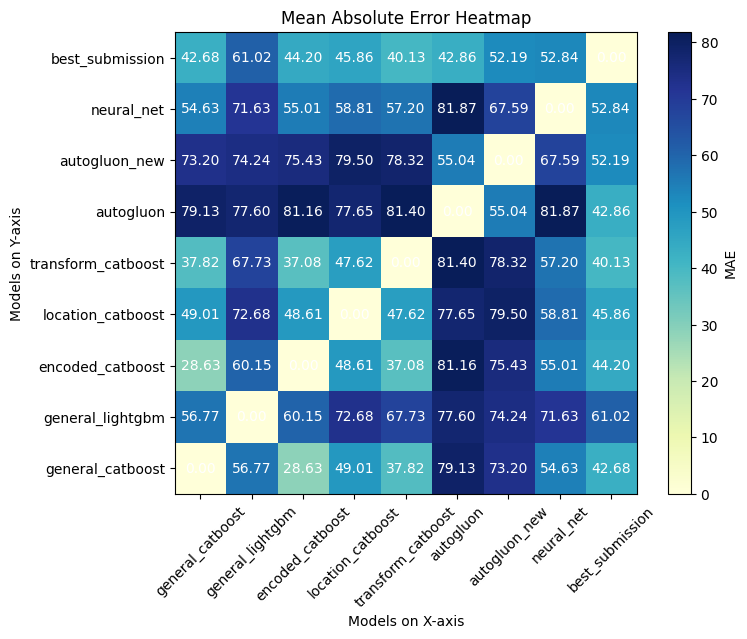

In [ ]:
# Calculate the mean absolute error (MAE) between pairs of models
mae_grid = np.zeros((len(cleaned_test_results.columns), len(cleaned_test_results.columns)))

for i, model1 in enumerate(cleaned_test_results.columns):
    for j, model2 in enumerate(cleaned_test_results.columns):
        mae_grid[i, j] = np.abs(cleaned_test_results[model1] - cleaned_test_results[model2]).mean()

# Create a heatmap of the MAE values
plt.figure(figsize=(8, 6))
plt.imshow(mae_grid, cmap='YlGnBu', origin='lower')
plt.colorbar(label='MAE')
plt.title('Mean Absolute Error Heatmap')
plt.xlabel('Models on X-axis')
plt.ylabel('Models on Y-axis')
plt.xticks(range(len(cleaned_test_results.columns)), cleaned_test_results.columns, rotation=45)
plt.yticks(range(len(cleaned_test_results.columns)), cleaned_test_results.columns)

# Add MAE values as text inside each cell
for i in range(len(cleaned_test_results.columns)):
    for j in range(len(cleaned_test_results.columns)):
        plt.text(j, i, f'{mae_grid[i, j]:.2f}', ha='center', va='center', color='w')


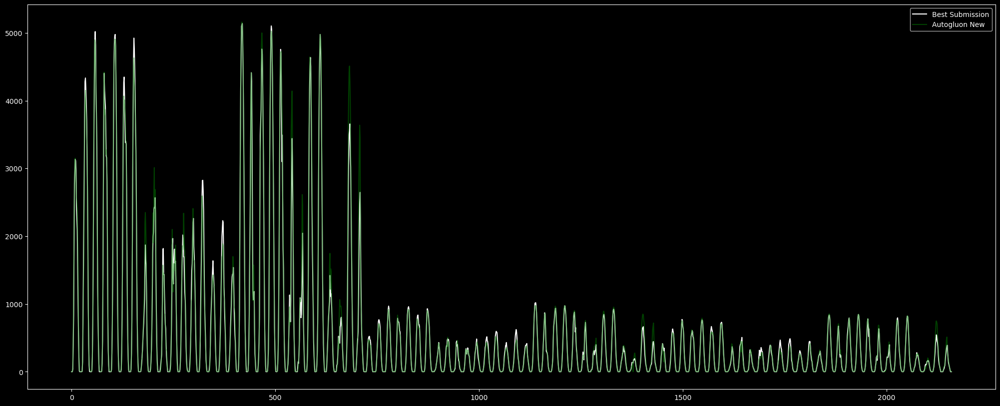

In [ ]:
# Plot autogluon new reuslts against the best submission
plt.figure(figsize=(25, 10))
plt.plot(best_submission["prediction"], label="Best Submission", color="white")
plt.plot(cleaned_test_results["neural_net"], label="Autogluon New", color="green", alpha=0.5)
# plt.plot(cleaned_test_results["autogluon_new"], label="Autogluon New", color="red", alpha=0.5)

plt.legend()

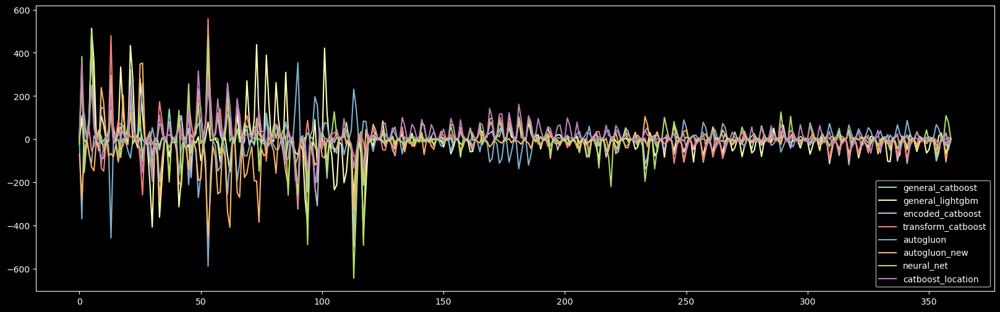

In [ ]:
# Plot residuals all models against the best submission

plt.figure(figsize=(20, 6))

agg = 6

models_to_plot = [
    "general_catboost",
    "general_lightgbm",
    "encoded_catboost",
    "transform_catboost",
    "autogluon",
    "autogluon_new",
    "neural_net",
    "catboost_location",
]

for model in models_to_plot:
    if model == "best_submission":
        continue

    plot_data = pd.DataFrame(cleaned_test_results[model]).copy()
    plt.plot(
        best_submission.index[: best_submission.shape[0] // agg],
        best_submission.groupby(np.arange(best_submission.shape[0]) // agg)[
            "prediction"
        ].mean()
        - plot_data.groupby(np.arange(plot_data.shape[0]) // agg)[model].mean(),
        label=model,
        # s=1.5,
    )

plt.legend()

### Creating the Ensamble

To find the ensabmle weight for the different models we solved a minimizing problem of the prediction erorrs from the models i the meta model to find the optimal weights for each model. This method also made it easy to check if a newly created model was good or not as the meta model would automaticly weight all models for us. If a newly added model recived a weight of for examaple 0 we could discard this model and try other models insted.

In [ ]:
MONTHS_TO_FIT = [3, 4, 5, 6, 7]

ensamble_data = data_simple[
    data_simple.data_type.isin(["observed", "estimated"])
].copy()

ensamble_df = pd.DataFrame()
ensamble_df["target"] = ensamble_data["pv_measurement"]
ensamble_df["data_type"] = ensamble_data["data_type"]

for key in ensamble_models.keys():
    try:
        ensamble_df[key] = ensamble_models[key]["train"][:,0]
    except:
        ensamble_df[key] = ensamble_models[key]["train"]
    ensamble_df[key] = np.where(ensamble_df[key] < 0, 0, ensamble_df[key])

# Filter out months that are not in MONTHS_TO_FIT
ensamble_df["month"] = ensamble_data["date_forecast"].dt.month
ensamble_df["year"] = ensamble_data["date_forecast"].dt.year
ensamble_df = ensamble_df[
    # ensamble_df.month.isin(MONTHS_TO_FIT) &
    (ensamble_df.year >= 2020)
    # & (ensamble_df.target >= 10)
    # & (ensamble_df.data_type == "estimated")
]
ensamble_df = ensamble_df.drop(columns=["month", "data_type", "year"])

X_train_ensamble = ensamble_df.drop(columns=["target"])
y_train_ensamble = ensamble_df["target"]

# Specify initial parameters
initial_params = np.zeros(X_train_ensamble.shape[1])


# Force all weights to sum to 1
def constraint(params):
    return np.sum(params) - 1

bounds = [(0,1)] * X_train_ensamble.shape[1]

# Perform constrained optimization
opt_result = opt.minimize(
    lambda params: mean_absolute_error(
        y_train_ensamble, np.dot(X_train_ensamble, params)
    ),
    initial_params,
    # bounds=bounds,
    method="SLSQP",
    constraints=[
        {"type": "eq", "fun": constraint},
        # {"type": "ineq", "fun": lambda x: x},
    ],
)

# Extract the coefficients
coefficients = opt_result.x

# Make predictions
X_test_ensamble = pd.DataFrame()

for key in ensamble_models.keys():
    X_test_ensamble[key] = ensamble_models[key]["test"]

ensamble_preds = np.dot(X_test_ensamble, coefficients)

print(opt_result.fun)
print("Coefficients:")
print(
    ", ".join(
        [
            X_test_ensamble.columns[i] + ": " + str(round(coefficient, 5))
            for i, coefficient in enumerate(coefficients)
        ]
    )
)
ensamble_preds = np.array(ensamble_preds).flatten()
np.sum(coefficients)

ValueError: Length of values (0) does not match length of index (89957)

### Weight Adjustments and Combining the Model

general_catboost: 0.10738, general_lightgbm: -0.11873, encoded_catboost: 0.087, transform_catboost: 0.71344, location_catboost: 0.21091


In [ ]:
cleaned_test_results["neural_net"]

0         0.124273
1         0.356521
2         0.748473
3        15.749975
4       406.894745
           ...    
2155     39.284008
2156     13.503201
2157      5.070581
2158      1.018915
2159      0.708701
Name: neural_net, Length: 2160, dtype: float32

In [ ]:
-0.10873+0.18438

0.07565

In [ ]:
-0.11873+0.19438

0.07565

In [ ]:
weights_2 = np.array([0, -0.11873, 0.19438, 0.21091, 0.71344])

np.sum(weights_2)

1.0

In addtion to the ensamble of models from our meta model we also weighted other models with the ensamble model itsetlf. For example the meta weighed ensample model is weighted agianst amongst other a atogluon model and a Neural net

In [ ]:
weights = [0.41, 0.18, 0.41]

ensamble_weights = [0.08, 0.60, 0.12, 0.20, 0]

ensamble = (
    + weights[0] * cleaned_test_results["autogluon"].to_numpy()
    + weights[1] * cleaned_test_results["neural_net"].to_numpy()
    + weights[2] * np.dot(weights_2, (
        cleaned_test_results["general_catboost"].to_numpy(),
        cleaned_test_results["general_lightgbm"].to_numpy(),
        cleaned_test_results["encoded_catboost"].to_numpy(),
        cleaned_test_results["transform_catboost"].to_numpy(),
        cleaned_test_results["location_catboost"].to_numpy(),
    ))
)

# ensamble = test_result["autogluon_new"]["pv_measurement"].to_numpy()

ensamble[720:] = ensamble[720:] * 0.7 + 0.3 * test_result["autogluon_new"]["pv_measurement"].to_numpy()[720:]

ensamble = np.array(np.maximum(ensamble, 0))

print("Weights:", weights)
print("Sum:", np.sum(weights))
print("Sum:", np.sum(ensamble_weights))

Weights: [0.41, 0.18, 0.41]
Sum: 1.0
Sum: 1.0


In [ ]:
print("MAE Ensamble:")
print(mean_absolute_error(best_submission["prediction"], ensamble))

MAE Ensamble:
2.6045648907880525


In [ ]:
sum_mae = 149.38556 + 148.95342 + 148.05089 + 149.9395

weights = [
    sum_mae / 149.38556,
    sum_mae / 148.95342,
    sum_mae / 148.05089,
    sum_mae / 149.9395,
]


def geo_mean(iterable):
    a = np.array(iterable)
    return a.prod() ** (1.0 / len(a))

def geo_mean_overflow(iterable):
    return np.exp(np.log(iterable).mean())


weights = np.array(weights) / np.sum(weights)

new_model = pd.DataFrame(
    {
        "autogluon": cleaned_test_results["autogluon"].to_numpy(),
        "neural_net": cleaned_test_results["neural_net"].to_numpy(),
        "transform_catboost": cleaned_test_results["transform_catboost"].to_numpy(),
        "location_catboost": cleaned_test_results["location_catboost"].to_numpy(),
        "autogluon_new": cleaned_test_results["autogluon_new"].to_numpy(),
        "encoded_catboost": cleaned_test_results["encoded_catboost"].to_numpy(),
    }
)

# Apply geometric mean to all rows and add as column

new_model["geometric_mean"] = new_model.apply(geo_mean_overflow, axis=1).fillna(0)

ensamble = new_model["geometric_mean"].to_numpy()

mean_absolute_error(best_submission["prediction"], new_model["geometric_mean"])

/Users/mathiasraa/anaconda3/envs/forecasting/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


14.829734205402879

### Visualize Change from Best Submission

To see how our newly created ensamble performed againts our best submission so far we plotted the difference between the two to compare and check if we had pontetialy created a better ensamble model. 

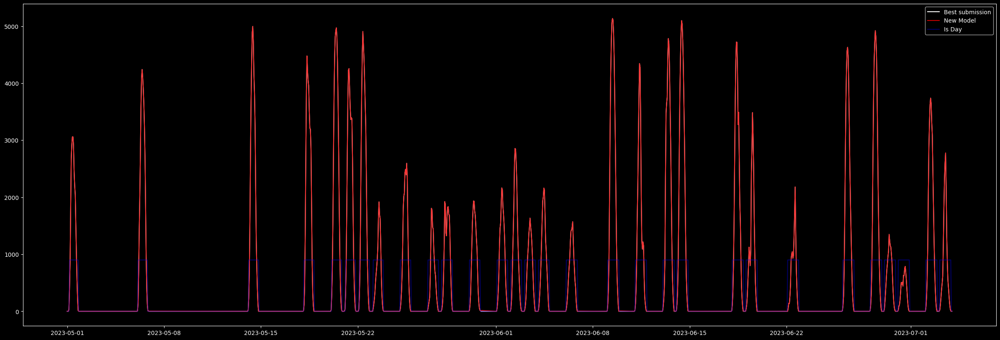

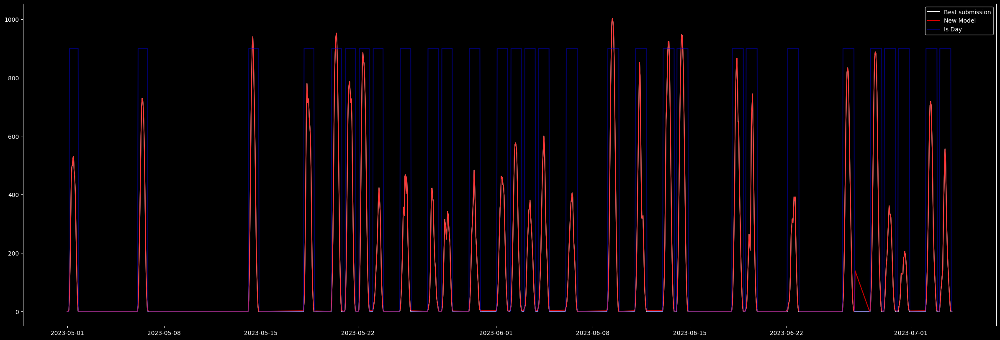

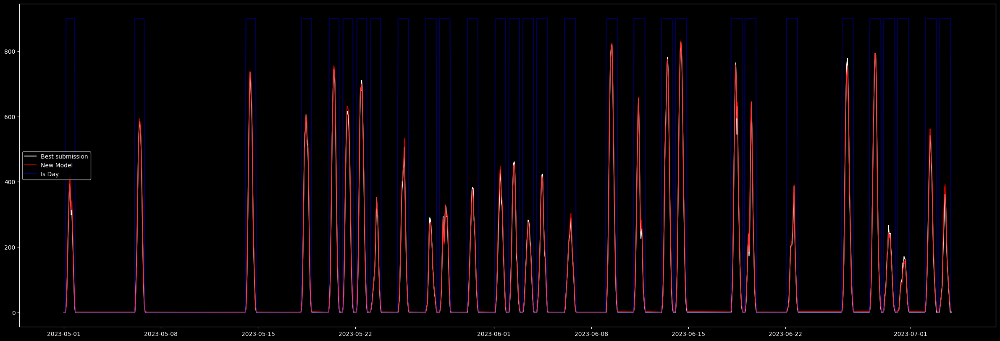

In [ ]:
for location in ("A", "B", "C"):
    plot_ensamble = (
        data_standard[(data_standard.data_type == "test")]
        .sort_values(["location", "date_forecast"])
        .reset_index(drop=True)
    )
    plot_ensamble = plot_ensamble[plot_ensamble.location == location].index
    plot_ensamble = ensamble[plot_ensamble]

    plt.figure(figsize=(30, 10))
    plt.plot(
        data_standard[(data_standard.data_type == "test") & (data_standard.location == location)].sort_values(
            ["date_forecast", "location"]
        )["date_forecast"],
        best_submission[best_submission.location == location]["prediction"],
        label="Best submission",
        color="white",
    )
    plt.plot(
        data_standard[(data_standard.data_type == "test") & (data_standard.location == location)].sort_values(
            ["date_forecast", "location"]
        )["date_forecast"],
        plot_ensamble,
        label="New Model",
        alpha=0.8,
        color="red",
    )
    plt.plot(
        data_standard[(data_standard.data_type == "test") & (data_standard.location == location)].sort_values(
            ["date_forecast", "location"]
        )["date_forecast"],
        data_standard[(data_standard.data_type == "test") & (data_standard.location == location)].sort_values(
            ["date_forecast", "location"]
        )["is_day:idx"]
        * 900,
        label="Is Day",
        alpha=0.4,
        color="blue",
    )
    plt.legend()

# 5 – Postprocessing <a id='5'></a>

After creating and weighting the model in our ensamble model we performed some post processing. All negative values are replaced with 0 as it does not make sence to have negative pv_measurement values. In addtion we have replaced smaller pv_measurement values (less than 4) with zero, bacause we found out that this gave us a better score (reduces error).

In [ ]:
constraint = (
    data_standard[data_standard["data_type"].isin(["observed"]) & data_standard["month"].isin([5, 6, 7])]
    .groupby(["month", "hour", "location"])["pv_measurement"]
    .max()
    .reset_index()
)

In [ ]:
kaggle_data = (
    data_standard[data_standard.data_type.isin(["test"])]
    .sort_values(["location", "date_forecast"])
    .copy()
).reset_index(drop=True)

kaggle_data["pv_measurement"] = ensamble
kaggle_data["pv_measurement_post"] = pd.merge(
    kaggle_data, constraint, on=["hour", "month", "location"], how="left"
)["pv_measurement_y"].values
kaggle_data["pv_measurement_post"] = np.where(
    kaggle_data["pv_measurement_post"] < kaggle_data["pv_measurement"],
    kaggle_data["pv_measurement_post"],
    kaggle_data["pv_measurement"],
)
kaggle_data["pv_measurement_post"] = np.where(
    kaggle_data["pv_measurement_post"] < 4, 0, kaggle_data["pv_measurement_post"]
)

In [ ]:
np.sum(kaggle_data["pv_measurement"] - kaggle_data["pv_measurement_post"]) / 2160

# 6 – Submission <a id='6'></a>

Chacking the MAE against best model and create submission file.

In [ ]:
mean_absolute_error(
    best_submission["prediction"], kaggle_data["pv_measurement_post"].values
).round(4)

2.1755

In [ ]:
output_df = pd.DataFrame(
    kaggle_data["pv_measurement_post"].values, columns=["prediction"]
)
output_df = output_df.reset_index(names="id")
output_df.to_csv(
    "../data/results/" + str(datetime.datetime.now()) + "-ensamble.csv", index=False
)